In [2]:
import pandas as pd
import numpy as np
from bioreactor.plotting import *
from bioreactor.use_colors import *
from bioreactor.annotation import *
from bioreactor.ssgsea import *
from bioreactor.gsea import *
from bioreactor.expression import  *
from bioreactor.pathway_scoring import *
from bioreactor.survival import * 
from bioreactor.graphs import *

from bioreactor.utils import *
from bioreactor.mutations import *
from bioreactor.clustering import *

from mldeconv.cells_plotting import *
from mldeconv.data_loading import *

from typing import Tuple, List, Optional
import warnings
from tqdm.notebook import tqdm
from scipy.stats import spearmanr
import scipy

from collections import defaultdict
from scipy.spatial.distance import pdist, squareform
import itertools as it
import os

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
def clustered_heatmap(
    ds, title='', corr='spearman', method='average',
    yl=True, xl=True, cmap='coolwarm', 
    figsize=(15,15), annot=True, vmin=0.5, vmax=1,
    col_colors_h_ratio=1, row_colors_w_ratio=1, 
    **kwargs):
    """
    Plot correlation heatmap for rows after performing clustering on dataset "ds"
    :param ds: pd.DataFrame, numerical data only

    """

    similarity_matrix = ds.dropna().T.corr(method=corr)
    dissimilarity_matrix = 1 - similarity_matrix
    hclust_linkage = linkage(squareform(dissimilarity_matrix), method=method)

    g = sns.clustermap(similarity_matrix.round(3), method=method,
                       row_linkage=hclust_linkage, col_linkage=hclust_linkage,
                       annot=annot, vmin=vmin, vmax=vmax,
                       cmap=cmap, yticklabels=yl, xticklabels=xl,
                       figsize=figsize, **kwargs)

    g.fig.suptitle(title)

    return resize_clustermap_annotation(g, col_colors_h_ratio, row_colors_w_ratio)

In [5]:
def genes_expression_chart_(genes, num_to_show=30, axes=None, figsize=(12, 8), source=None,
                           path_to_cells='/uftp/Deconvolution/Data/Median_Cells_by_sample-kallisto-Xena-gene-TPM_without_noncoding',
                           path_to_lines='/uftp/Deconvolution/Data/Median_Cancer_cell_lines_by_sample-kallisto-Xena-gene-TPM_without_noncoding',
                           path_to_tissues='/uftp/Deconvolution/Data/Mean_Tissues_by_sample-kallisto-Xena-gene-TPM_without_noncoding.tsv'):
    """
    Function makes chart of genes expression from all sources
    :param genes: list of genes
    :param num_to_show: number of cells / lines with highest expression level to show (top-k)
    :param axes: axes to plot
    :param figsize: size of a figure
    :param source: 'lines', 'cells' or 'all'
    :param path_to_cells: path to cells expression data
    :param path_to_lines: path to lines expression data
    :param path_to_tissues: path to tissues expression data
    :returns: tables with genes expression
    """
    from bioreactor.plotting import lin_colors
    
    if not (source == 'lines' or source == 'cells' or source == 'tissues'or source == 'all' or source == None):
        raise ValueError("Incorrect source type! Only cells, lines, tissues or all are available.")
        
    cells = pd.read_csv(path_to_cells, sep=',', index_col=0)
    lines = pd.read_csv(path_to_lines, sep=',', index_col=0)
    tissues = pd.read_csv(path_to_tissues, sep='\t', index_col=0)
        
    for common_name in set(lines.columns).intersection(set(cells.columns)):
        lines.rename(columns={common_name: common_name + '_line'}, inplace=True)
        cells.rename(columns={common_name: common_name + '_sample'}, inplace=True)
    for common_name in set(cells.columns).intersection(set(tissues.columns)):
        cells.rename(columns={common_name: common_name + '_sample'}, inplace=True)
        tissues.rename(columns={common_name: common_name + '_tissue'}, inplace=True)
    for common_name in set(lines.columns).intersection(set(tissues.columns)):
        lines.rename(columns={common_name: common_name + '_line'}, inplace=True)
        tissues.rename(columns={common_name: common_name + '_tissue'}, inplace=True)
    
    for gene in genes:
        if gene not in cells.index:
            print("Gene {} is not found".format(gene))
            genes.remove(gene)

    if axes is not None:
        assert len(genes) == len(axes.flat), "Length of genes list should be equal to the number of subplots!"
    else:
        fig, axes = plt.subplots(len(genes), 1, figsize=(figsize[0], figsize[1] * len(genes)))
    
    for ax, gene in zip(axes.flat, genes):
        if source == 'lines':
            exp = lines.loc[gene].sort_values(ascending=False)[:num_to_show]
        elif source == 'cells':
            exp = cells.loc[gene].sort_values(ascending=False)[:num_to_show]
        elif source == 'tissues':
            exp = tissues.loc[gene].sort_values(ascending=False)[:num_to_show]
        else:
            exp = pd.concat([cells.loc[gene], lines.loc[gene]]).sort_values(ascending=False)[:num_to_show]
        palette = lin_colors(exp.index)
        ax.set_title(gene, size=20) 
        ax.set_xticklabels(exp.index, rotation='vertical', fontsize=12) 
        exp.plot(kind='bar', ax=ax, color=list(exp.index.map(palette)), grid=False)
    plt.tight_layout()
    plt.show()
    
    return axes, exp

In [6]:
def gene_corr_plot(genes, df, diag):
#     display(genes)
    clustered_heatmap(df.reindex(genes), title=diag, metric='spearman', vmin=0, vmax=1);
    df_ranks = pd.concat(list(get_ranks(df)), axis=1).T
    df_ranks = df_ranks.reindex(genes)
    order = df_ranks.sum().sort_values(ascending=False).index
    df_ranks = df_ranks.reindex(order, axis=1)
    _, ax = plt.subplots(figsize=(15,4))
    sns.heatmap(
        df_ranks.reindex(get_hclust_order(df_ranks, metric='spearman')), 
        cbar=False, cmap='coolwarm', xticklabels=False, ax=ax
    );
    df = df.reindex(genes)
    data = pd.melt(df.T)
    data['KDE'] = 'Gene'


    data2 = \
    pd.Series(
        data=list(it.chain.from_iterable(it.repeat(df.mean(), len(df.index)))),
        index=list(it.chain.from_iterable(it.repeat(x, len(df.columns)) for x in df.index)),
        name='value'
    )

    data2 = data2.reset_index().rename(columns={'index': 'Gene'})

    data2['KDE'] = 'Mean'

    _, ax = plt.subplots(figsize=(len(df.index)*1.5,5))

    ax2 = sns.violinplot(
        x='Gene',
        y='value',
        hue='KDE',
        data=pd.concat([data, data2]),
        palette="Set2",
        split=True,
        scale="count",
        inner='box',
        ax=ax
    )
    ax2.set_xticklabels(ax.get_xticklabels(), rotation=45);
    plt.show()

In [7]:
def get_gspread(table, sheet, index_col=0, path_to_json=None): 
    """
    Access Google Sheets via python
    
    :param path_to_json: absolute path to JSON containing creditials for Google API
    :param table: Annotation calculated, for instance
    :param sheet: Blood, for instance
    :param index_col: column number
    :return: pandas DataFrame
    """
    from oauth2client.service_account import ServiceAccountCredentials
    import gspread
    
    if path_to_json == None:
        path_to_json = '/uftp/Blood/google_secret.json'

    credentials = ServiceAccountCredentials.from_json_keyfile_name(
        path_to_json)  # Your json file here
    gc = gspread.authorize(credentials)

    # open table
    wks = gc.open(table)
    # select sheet
    sheet = wks.worksheet(sheet)
    data = pd.DataFrame(sheet.get_all_records())
    data = data.set_index(data.columns[index_col])
    return data

In [8]:
def get_hclust_order(
        data,
        metric='correlation',
        method='average',
        optimal_ordering=True,
        **kwargs
):
    """
    Return an order of observations that corresponds to the order of leaf nodes in a dendrogram of hierarchical clustering
    performed by clustering_method algorithm based on pairwise distance_metric

    REQUIRED
    :param data: pd.DataFrame, index - observations, columns - features.
                 Alternatively, ndarray, an m by n array of m original observations in an n-dimensional space

    OPTIONAL
    :param distance_metric: str, distance metric to use. See scipy.spatial.distance.pdist documentation for options
    :param clustering_method: str, linkage algorithm to use. See scipy.cluster.hierarchy.linkage documentation for options
    :param optimal_ordering: bool, if True, the linkage matrix will be reordered so that the distance between successive leaves is minimal.
                             See scipy.cluster.hierarchy.linkage for the full description.

    :return: list, a list of labels corresponding to the leaf nodes
    """

        
    if metric in ['spearman', 'kendall', 'pearson']:
        similarity_matrix = data.dropna().T.corr(method=metric)
        dissimilarity_matrix = 1 - similarity_matrix
        hclust_linkage = linkage(squareform(dissimilarity_matrix), method=method, optimal_ordering=True)
              
        
    else:
        dissimilarity_matrix = pdist(data.dropna(), metric=metric)
        hclust_linkage = linkage(dissimilarity_matrix, method=method, optimal_ordering=True)

    R = dendrogram(
        Z=hclust_linkage,
        labels=data.index,
        no_plot=True,
        **kwargs
    )

    leaf_order = R['ivl']

    return leaf_order

In [9]:
def get_expression_table(cohort, log=True):
    
    if log:
        return np.log2(read_dataset(f'/uftp/mvp-data/cohorts/{cohort}/expressions.tsv')+1).T
    else:
        return read_dataset(f'/uftp/mvp-data/cohorts/{cohort}/expressions.tsv').T

In [10]:
def get_anno(cohort):
    return read_dataset(f'/uftp/mvp-data/cohorts/{cohort}/annotation.tsv').T

In [11]:
def get_deconv(cohort):
    return read_dataset(f'/uftp/mvp-data/cohorts/{cohort}/deconvolution/cells_deconvolution_rna_percent.tsv').T

In [12]:
def get_ranks(df):  
    for gene in df.index:
        yield df.loc[gene].rank()

In [13]:
import seaborn as sns
sns.set_style("white")

In [14]:
cells_p['Epithelium'] = '#DFD3CF'
cells_p['Pericytes_and_smooth_muscle'] = '#CC7A00'
cells_p['Glial_cells'] = '#995B00'

# Signature validation: Sorted cells and cell lines, public

## read anno

In [16]:
# Here we check which version of annotation is the newest - oldest directories go first
paths =sorted(Path('/uftp2/Databases/sorted_cell_databases/').iterdir(), key=os.path.getmtime)
paths

[PosixPath('/uftp2/Databases/sorted_cell_databases/jan2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/march2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/june2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/jan2023'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/current_version'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/March2024')]

In [17]:
cells_clean = read_dataset('/uftp2/Databases/sorted_cell_databases/jan2023/cells_clean_annotation.tsv')

In [18]:
cells_clean = cells_clean[(~cells_clean.index.str.contains('RNA'))&(~cells_clean.index.str.contains('WES'))&(~cells_clean.index.str.contains('210514_NovaA'))]

In [19]:
cells_clean.head()

,Readcounts,Sample,Dataset,Cell_type,Cell_type_details,Extended_details,Stimulation,Therapy,Modification,Material_type,Diagnosis,Sorting_markers,Comment,Cell_origin,Who_checks,Deconvolution_cell_type,Decision,QC_bad,QC_score
SRX3263500,14969649.0,SRX3263500,GSE104744,Monocytes,NaN,NaN,Without_stimulation,Without_therapy,Without_modification,polyA RNA,Healthy,CD14+,NaN,Whole_blood,ddyikanov,Monocytes,good,NaN,6.00
SRX5019107,16449399.0,SRX5019107,GSE122624,gd_T_cells,NaN,NaN,Without_stimulation,Without_therapy,Without_modification,polyA RNA,Rheumatoid_arthritis,CD3+ TCRgd+,NaN,PBMC,vbelyaeva,gd_T_cells,ok,NaN,4.75
SRX5019094,17811045.0,SRX5019094,GSE122624,T_cells,NaN,NaN,Without_stimulation,Without_therapy,Without_modification,polyA RNA,Spondyloarthritis,CD3+ TCRVb11+ TCRVa24Ja18+,NaN,PBMC,vbelyaeva,T_cells,ok,NaN,4.75
SRX2915885,14471330.0,SRX2915885,GSE99999,Fibroblasts,Human dermal fibroblasts,cultured on aligned nanofibers coated with typ...,Without_stimulation,Without_therapy,Without_modification,polyA RNA,Healthy,NaN,NaN,Skin,sbratchikov,Fibroblasts,good,NaN,5.75
SRX4518798,11319867.0,SRX4518798,GSE118254,B_cells,Switched Memory B cells,NaN,Without_stimulation,"azathioprine (50), hydroxychloroquine (400)",Without_modification,polyA RNA,Systemic_lupus_erythematosus,CD19+ IgD- CD27+,NaN,PBMC,dafenteva,B_cells,good,NaN,NaN


NB: Клеточный тип из описания датасета обозначен в колонке Cell_type, однако бывает, 
    что более подробное описание образца содержится в колонке Cell_type_details. 
    Также есть колонка Deconvolution_cell_type, 
    в которой значению в колонке Cell_type по возможности сопоставляется такой клеточный тип, 
    для которого сейчас существует модель (https://bostongene.atlassian.net/wiki/spaces/TD/pages/3626696724/bulk+RNA-seq)

In [20]:
cells_clean = cells_clean[['Cell_type', 'Dataset', 'Sample', 'Cell_origin']]

In [21]:
public_cells_annot = cells_clean.copy()
public_cells_annot = public_cells_annot.reset_index(drop=True)

In [22]:
# split celltypes in case there are multiple celltypes per sample

celltypes_split = pd.DataFrame()

for i, j in public_cells_annot.dropna(subset=['Cell_type']).iterrows():
    if ';' in j['Cell_type']:
        ct = j['Cell_type'].split(';')
        new_row = j.copy()
        for c in ct:
            new_row['Cell_type'] = c
            celltypes_split = celltypes_split.append(new_row, ignore_index=True)
        public_cells_annot.drop(i, inplace=True)
        
public_cells_annot = public_cells_annot.append(celltypes_split)

In [23]:
public_cells_annot.index = public_cells_annot.Sample

In [24]:
# TAM
public_cells_annot['Cell_type'] = [public_cells_annot[public_cells_annot.index == x]['Cell_type'].replace('Macrophages', 'TAM').get(x) if x in ['SRX4495404', 'ERX1270123', 'ERX1270124', 'ERX1270125', 'ERX1270126', 'ERX1270127', 'ERX1270128', 'ERX1270130'] else public_cells_annot[public_cells_annot.index == x]['Cell_type'].get(x) for x in public_cells_annot.index]

In [25]:
# Mast cells
cells_annot = get_gspread('Cells', 'Cells')
cells_annot = cells_annot.loc[cells_annot.Cell_type.str.contains('Mast_cells')]
cells_annot = prepare_sample_annot(cells_annot)
cells_annot = cells_annot[['Cell_type', 'Dataset', 'Cell_origin']]
cells_to_check_annot = get_gspread('Annotation calculated', 'Cells_to_check')
cells_to_check_annot = cells_to_check_annot.loc[cells_to_check_annot.Cell_type.str.contains('Mast_cells')]
cells_to_check_annot = prepare_sample_annot(cells_to_check_annot)
cells_to_check_annot = cells_to_check_annot[['Cell_type', 'Dataset', 'Cell_origin']]
public_cells_annot = pd.concat([public_cells_annot, cells_annot, cells_to_check_annot])
public_cells_annot = public_cells_annot.loc[~public_cells_annot.index.isin(['SRX5026003', 'SRX5026001', 'SRX5026000', 'SRX5026002', 'SRX5025998', 'SRX5025999', 'SRX9977242', 'SRX9977243'])] #bad samples

In [26]:
# CAFs
public_cells_annot['Cell_type'] = [public_cells_annot[public_cells_annot.index == x]['Cell_type'].replace('Fibroblasts', 'CAF').get(x) if x in ['SRX1707754', 'SRX1707755', 'SRX1707757', 'SRX1707758', 'SRX1707759', 'SRX1707760', 'SRX1841548', 'SRX1841550', 'SRX1884188', 'SRX1884189', 'SRX1884190', 'SRX1884191', 'SRX1884192', 'SRX1884193', 'SRX1884194', 'SRX1884195', 'SRX1884196', 'SRX1884197', 'SRX2023079', 'SRX2023080', 'SRX2023081', 'SRX2023082', 'ERX2297292', 'ERX2297293', 'ERX2297295', 'ERX2297296'] else public_cells_annot[public_cells_annot.index == x]['Cell_type'].get(x) for x in public_cells_annot.index]

## anno stats

In [27]:
pd.options.display.max_rows = len(public_cells_annot['Cell_type'].value_counts())
public_cells_annot['Cell_type'].value_counts()

CD4_T_cells                           1266
Macrophages                            518
CD8_T_cells                            453
Monocytes                              435
Fibroblasts                            416
Endothelium                            321
NK_cells                               202
Neutrophils                            199
Macrophages_M1                         189
Monocytic_DC                           169
Cardiac_myofibroblasts                 168
T_cells                                147
Memory_CD4_T_cells                     129
Non_plasma_B_cells                     128
Tregs                                  120
Hepatocytes                            113
B_cells                                110
Dendritic_cells                         86
CD4_T_helpers                           73
Myeloid_cells                           54
Mast_cells                              51
Follicular_T_helper                     48
CD8_T_cells_PD1_high                    47
Central_mem

In [28]:
pd.options.display.max_rows = len(public_cells_annot['Cell_origin'].value_counts())
public_cells_annot['Cell_origin'].value_counts()

PBMC                                2989
Whole_blood                          697
Heart                                200
Skin                                 157
Lung                                 138
Liver                                136
Blood_vessel                         115
Umbilican_cord_blood                  62
Lung_tumor                            52
Umbilical_cord_blood                  48
BMMC                                  45
No_data                               31
Human whole blood                     30
Derma                                 27
Head/Neck squamous tumor              27
Tumor_biopsies                        25
Oculomotor neuron control             19
Blood                                 18
non-small cell lung cancer            16
Spleen                                15
Tonsills                              15
Tumor_tissue                          15
Periferal Blood                       13
Chronic myelomonocytic leukemia       12
Ascites_fluid   

In [29]:
pd.options.display.max_rows = 20

In [30]:
public_cells_annot.head()

,Cell_type,Dataset,Sample,Cell_origin
SRX3263500,Monocytes,GSE104744,SRX3263500,Whole_blood
SRX5019107,gd_T_cells,GSE122624,SRX5019107,PBMC
SRX5019094,T_cells,GSE122624,SRX5019094,PBMC
SRX2915885,Fibroblasts,GSE99999,SRX2915885,Skin
SRX4518798,B_cells,GSE118254,SRX4518798,PBMC


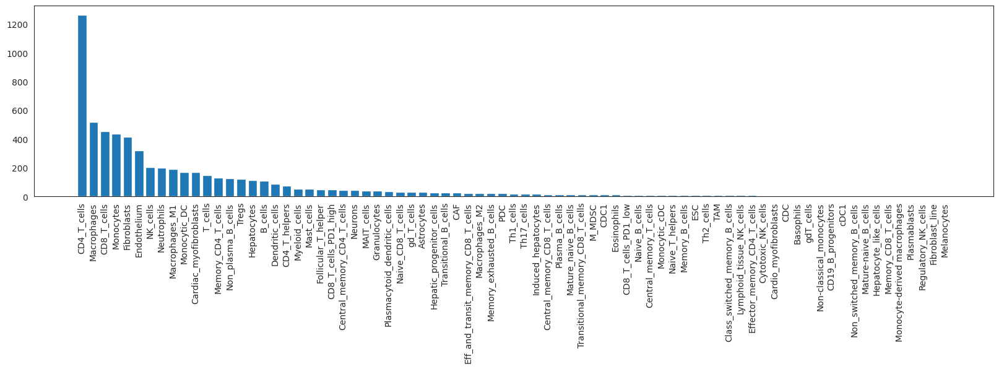

In [31]:
# a little bit of statistics
#example: which cell types do we have in lab_cells_annot?
plt.figure(figsize=(20, 4))
x = public_cells_annot['Cell_type'].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

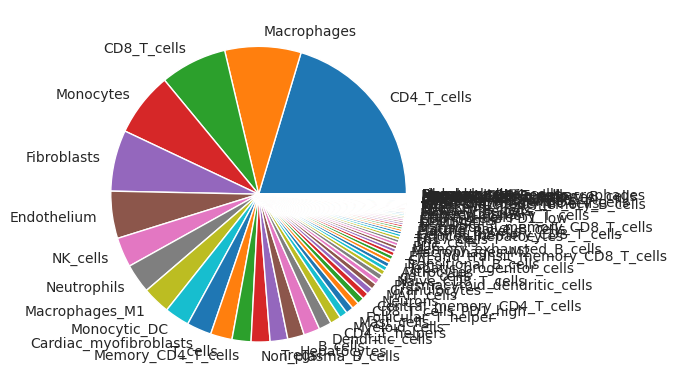

In [32]:
plt.pie(x, labels=x.index)
plt.show()

## read expressions

In [33]:
public_cells_expr = read_expressions(public_cells_annot)

In [34]:
public_cells_expr = np.log2(public_cells_expr+1)

## define custom signature

In [35]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')

#add here a custon signature name
signature_name = 'Macrophages'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

In [36]:
print(signature_of_interest)

['MARCO', 'CXCL5', 'SCG5', 'SULT1C2', 'MSR1', 'CTSK', 'PTGDS', 'COLEC12', 'GPC4', 'PCOLCE2', 'CHIT1', 'ANOS1', 'CLEC5A', 'ME1', 'DNASE2B', 'CCL7', 'FN1', 'CD163', 'GM2A', 'SCARB2', 'BCAT1', 'RAI14', 'COL8A2', 'APOE', 'CHI3L1', 'ATG7', 'CD84', 'FDX1', 'MS4A4A', 'SGMS1', 'EMP1', 'CYBB', 'CD68']


## Validation itself

In [37]:
#define celltypes of interest
categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
              'Eosinophils', 'Basophils', 'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells', 'T_cells',
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',
             ]

#dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat([annot, public_cells_annot.loc[public_cells_annot['Cell_type'].isin([i])]])
annot = annot.loc[~annot.index.isin(['SRX6369364', 'SRX7052817', 'SRX3361935', 'SRX3208751', 'SRX3208713'])] #dirty samples
annot = annot[~annot.index.duplicated()]
#for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(annot['Cell_type'],
                                    categories=categories,
                                    ordered=True)
annot = annot.sort_values('Cell_type')

In [38]:
subsampling_public = [i[1].sample(np.min([5, i[1].shape[0]])).index.tolist() for i in annot.groupby('Cell_type')]

In [39]:
subsampling_public = [item for sublist in subsampling_public for item in sublist]

<AxesSubplot:xlabel='Cell_type'>

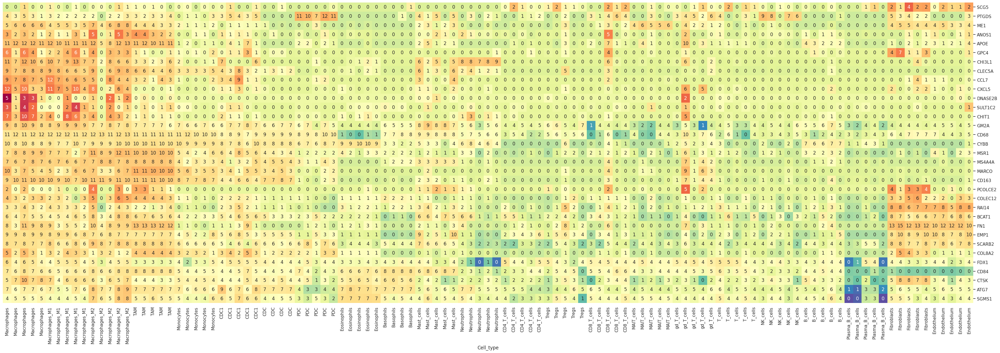

In [40]:
# A simple heatmap with log2 TPM of subsampled cells from celltypes of interest
genes_heatmap(
    public_cells_expr[subsampling_public],
    annot.reindex(subsampling_public)['Cell_type'],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color='blue',
    figsize=(45, 15),
    font_scale=1,
    show_indices=False,
    col_cluster=False,
    col_dendrogram=False,
    row_dendrogram=False)

In [41]:
sns.reset_defaults()
sns.set_style('white')

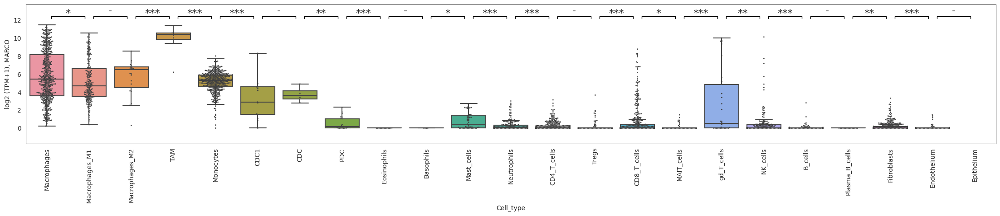

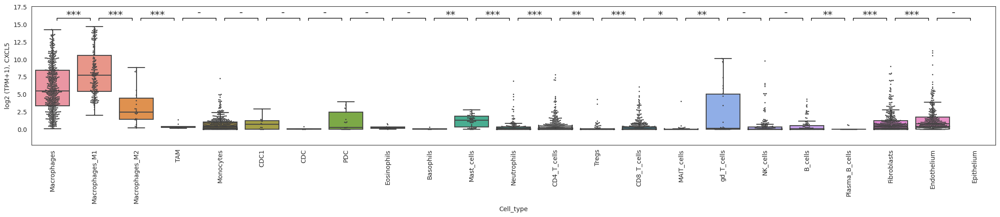

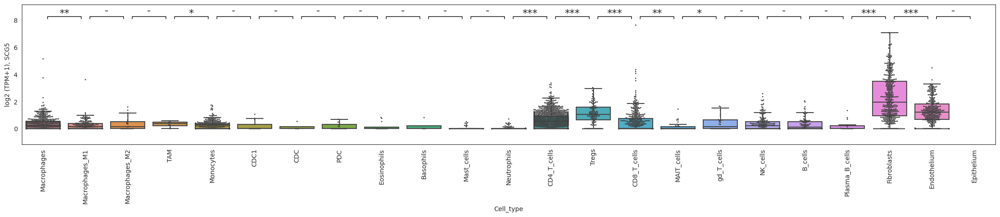

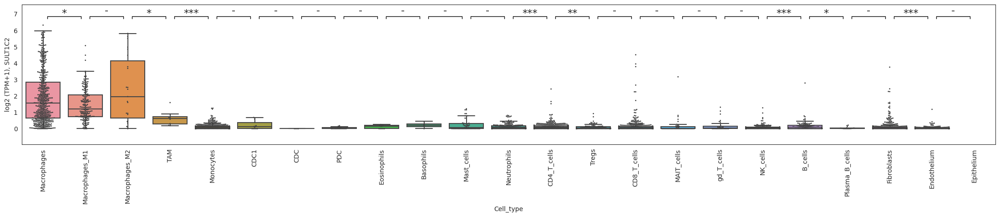

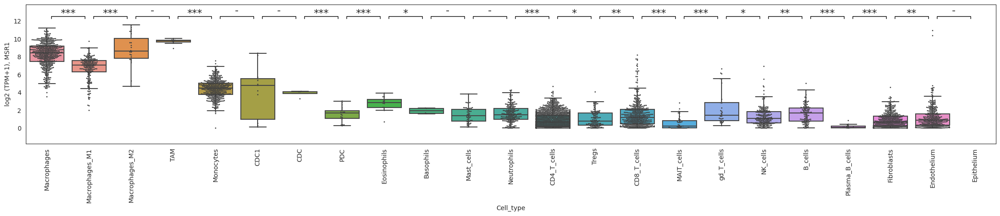

...

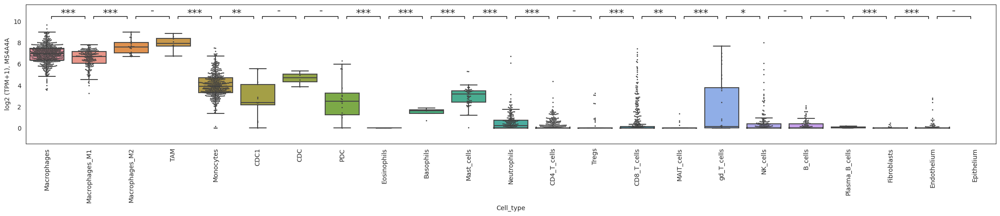

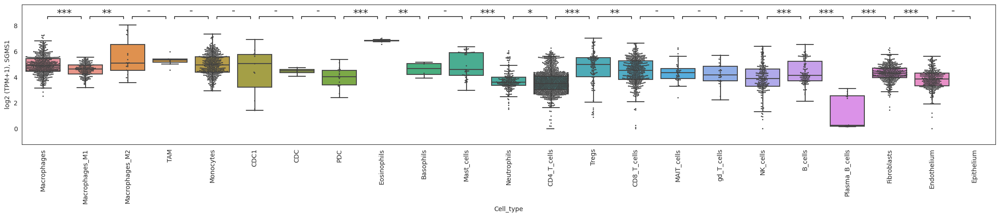

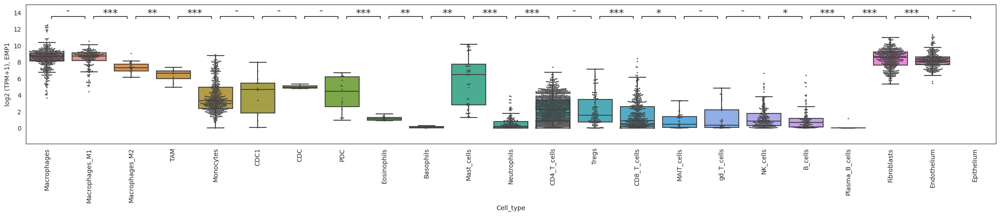

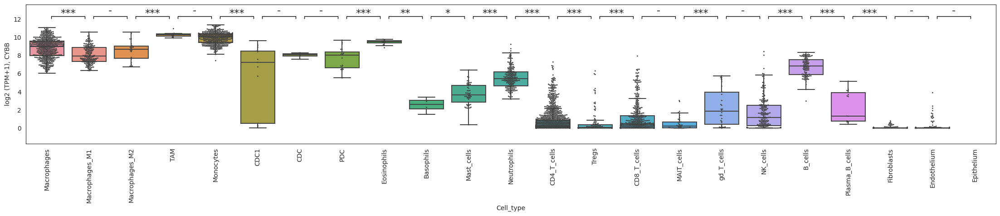

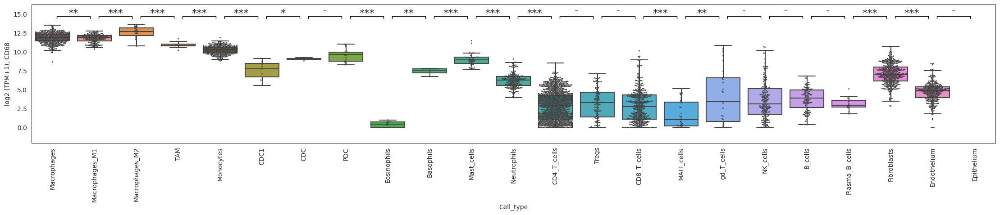

In [42]:
# boxplots depicting signature genes expression in celltypes of interest

categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
              'Eosinophils', 'Basophils', 'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells',
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',       
]

for gene in signature_of_interest:
    boxplot_with_pvalue(public_cells_expr.loc[gene], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order=categories, s=2)
    plt.ylabel(f'log2 (TPM+1), {gene}')
    plt.xticks(rotation=90)
    plt.show()

In [43]:
public_cells_ssgsea_unscaled = ssgsea_formula(public_cells_expr, gmt_genes_alt_names(geneset_of_interest, public_cells_expr.index, verbose=False)).T

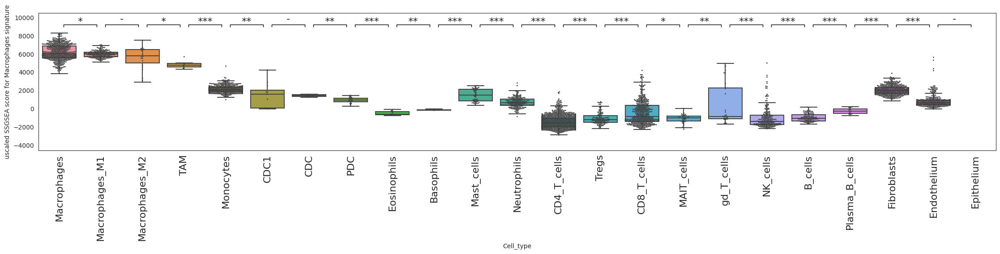

In [44]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
              'Eosinophils', 'Basophils', 'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells',
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',            
]

boxplot_with_pvalue(public_cells_ssgsea_unscaled[signature_name], annot[annot['Cell_type'].isin(categories)]['Cell_type'], 
                   order = categories, s=2, p_fontsize=16)

plt.xticks(rotation=90, fontsize=16)
plt.ylabel(f'uscaled SSGSEA score for {signature_name} signature')
plt.show()

Figure 4B

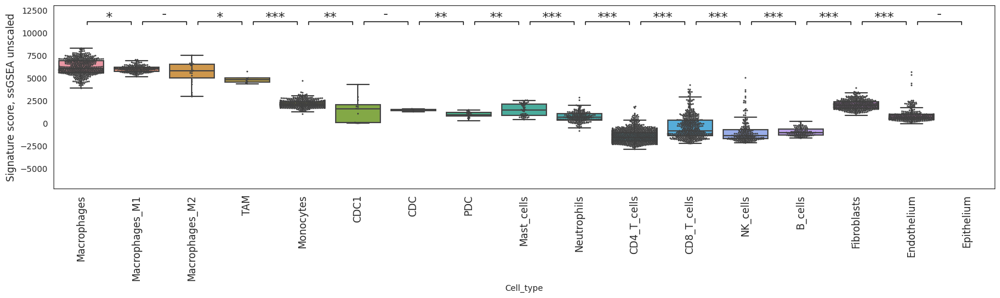

In [45]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
               'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'CD8_T_cells', 
              'NK_cells', 'B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',            
]

boxplot_with_pvalue(public_cells_ssgsea_unscaled[signature_name], annot[annot['Cell_type'].isin(categories)]['Cell_type'], 
                   order = categories, s=2, p_fontsize=16, y_min=-5000, y_max=10000)

plt.xticks(rotation=90, fontsize=12)
plt.ylabel(f'Signature score, ssGSEA unscaled', fontsize=12)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_original_sorted_cells_unified_scale.svg", format="svg")

plt.show()

## Tuned signature validation

In [46]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')
#OR
signature_of_interest = [
'MARCO',
# 'CXCL5', low expression in M2/TAMs, expression in some cancer lines, low correlation with deconvolution and with other signature genes (TCGA), no expression in single cell macrophages
# 'SCG5',
# 'SULT1C2',
 'MSR1',
# 'CTSK', fibroblasts
# 'PTGDS', pDC, fibroblasts
# 'COLEC12', fibroblasts
# 'GPC4', fibroblasts, tumor
# 'PCOLCE2', fibroblasts
# 'CHIT1', low correlation with other genes (TCGA)
# 'ANOS1',
 'CLEC5A',
# 'ME1', fibroblasts, tumor, MAIT
# 'DNASE2B', low expression, no correlation with deconvolution
 'CCL7',
# 'FN1', fibroblasts
 'CD163',
# 'GM2A', not specific
# 'SCARB2', not specific
# 'BCAT1', not specific
# 'RAI14', fibroblasts, endothelium, tumor
# 'COL8A2', fibroblasts
# 'APOE', fibroblasts
# 'CHI3L1', neutrophils
# 'ATG7', not specific
# 'CD84', not specific
# 'FDX1', not specific
 'MS4A4A',
# 'SGMS1', not specific
# 'EMP1', fibroblasts, endothelium, tumor
# 'CYBB', DC, B cells
 'CD68',
    'CSF1R', 
    'SIGLEC1', 
    'C1QA', 
    'C1QC', 
    'VSIG4'

]
#actually many deleted genes have problems with expression in cancer lines, low TCGA correlations and single cell. I can write it thoroughly if we need it

#add here a custon signature name
signature_name = 'Macrophages_new'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

In [47]:
subsampling_public = [i[1].sample(np.min([5, i[1].shape[0]])).index.tolist() for i in annot.groupby('Cell_type')]

In [48]:
subsampling_public = [item for sublist in subsampling_public for item in sublist]

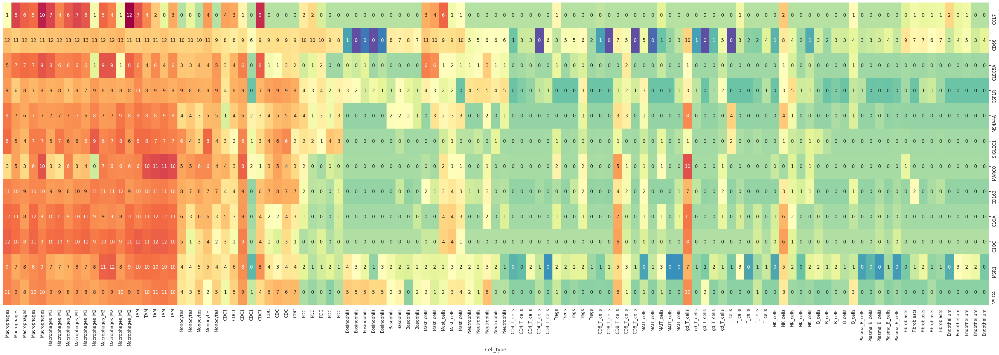

In [53]:
# A simple heatmap with log2 TPM of subsampled cells from celltypes of interest
genes_heatmap(
    public_cells_expr[subsampling_public],
    annot.reindex(subsampling_public)['Cell_type'],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color='blue',
    figsize=(45, 15),
    font_scale=1,
    show_indices=False,
    col_cluster=False,
    col_dendrogram=False,
    row_dendrogram=False)
plt.show()

In [54]:
sns.reset_defaults()
sns.set_style('white')

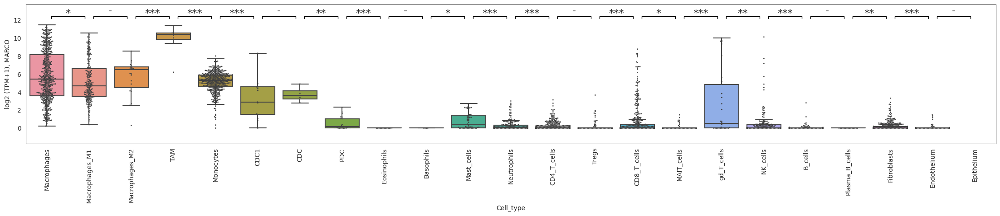

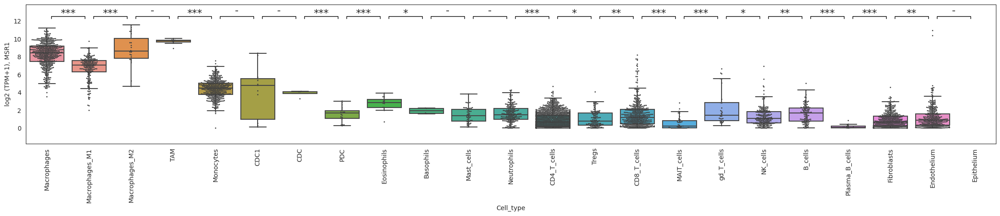

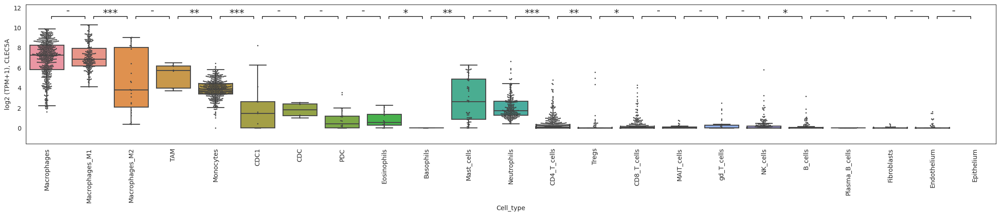

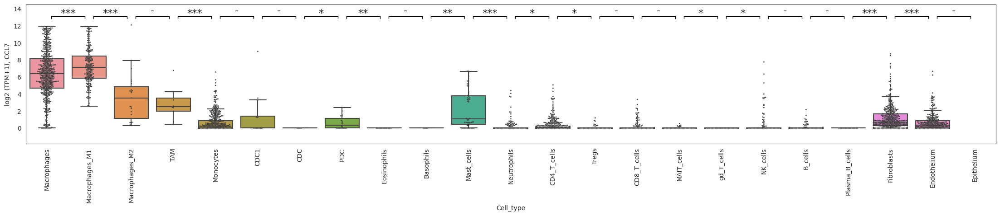

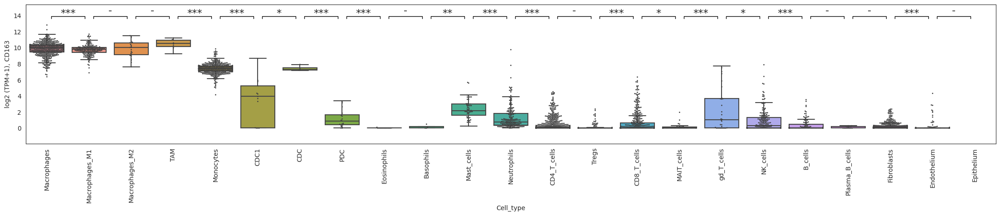

...

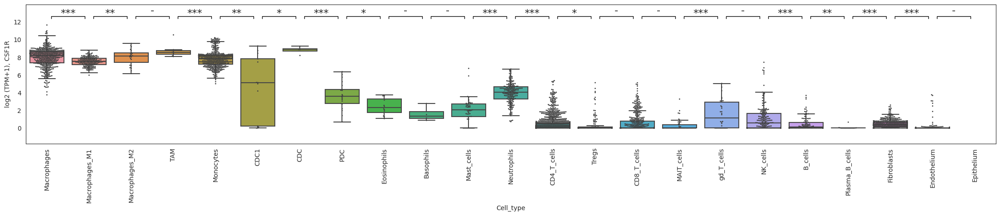

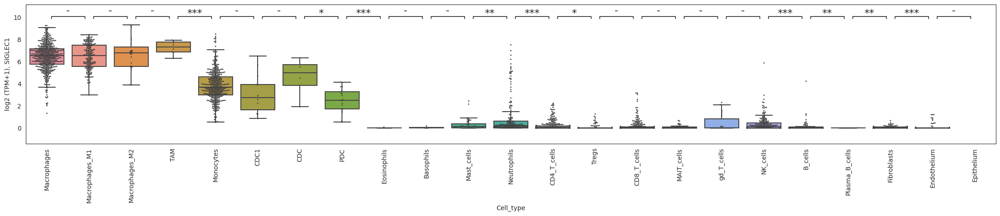

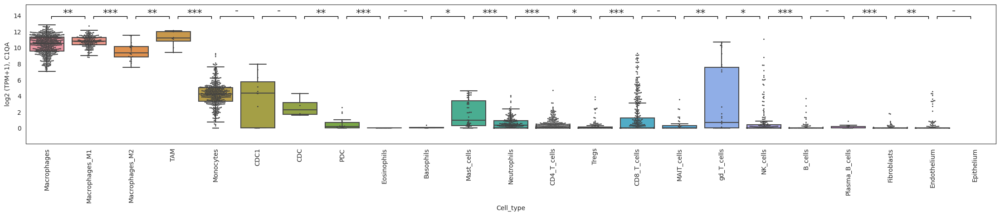

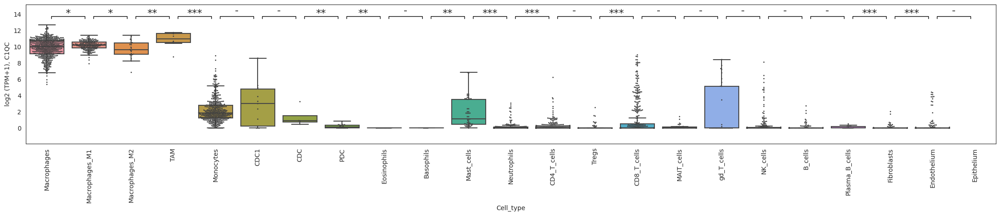

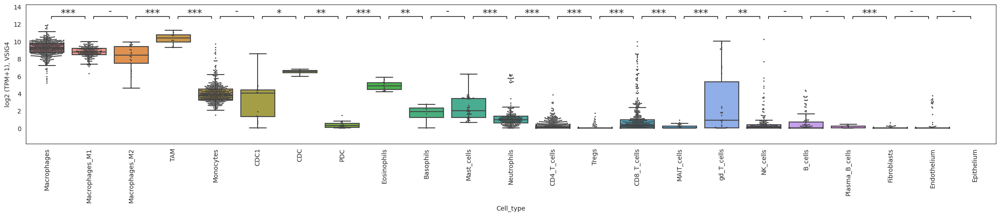

In [55]:
# boxplots depicting signature genes expression in celltypes of interest

categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
              'Eosinophils', 'Basophils', 'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells',
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',       
]

for gene in signature_of_interest:
    boxplot_with_pvalue(public_cells_expr.loc[gene], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order=categories, s=2)
    plt.ylabel(f'log2 (TPM+1), {gene}')
    plt.xticks(rotation=90)
    plt.show()

In [56]:
public_cells_ssgsea_unscaled = ssgsea_formula(public_cells_expr, gmt_genes_alt_names(geneset_of_interest, public_cells_expr.index, verbose=False)).T

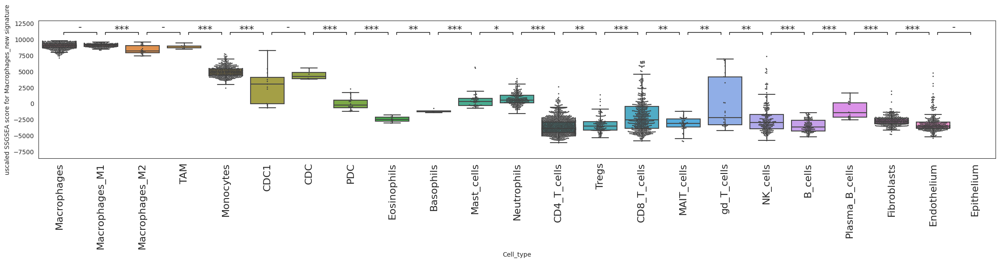

In [57]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
              'Eosinophils', 'Basophils', 'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells',
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',            
]

boxplot_with_pvalue(public_cells_ssgsea_unscaled[signature_name], annot[annot['Cell_type'].isin(categories)]['Cell_type'], 
                   order = categories, s=2, p_fontsize=16)

plt.xticks(rotation=90, fontsize=16)
plt.ylabel(f'uscaled SSGSEA score for {signature_name} signature')
plt.show()

Figure 4B

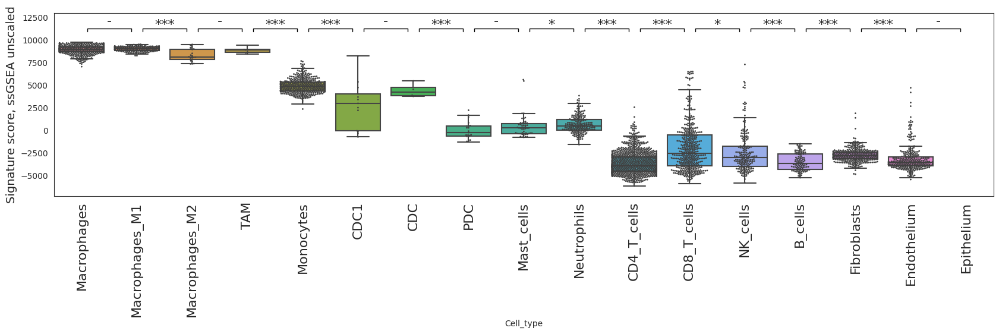

In [58]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
               'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'CD8_T_cells', 
              'NK_cells', 'B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',            
]

boxplot_with_pvalue(public_cells_ssgsea_unscaled[signature_name], annot[annot['Cell_type'].isin(categories)]['Cell_type'], 
                   order = categories, s=2, p_fontsize=16, y_min=-5000, y_max=10000)

plt.xticks(rotation=90, fontsize=16)
plt.ylabel(f'Signature score, ssGSEA unscaled', fontsize=14)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_tuned_sorted_cells.svg", format="svg")

plt.show()

## gene examples

Suppl figure 2E

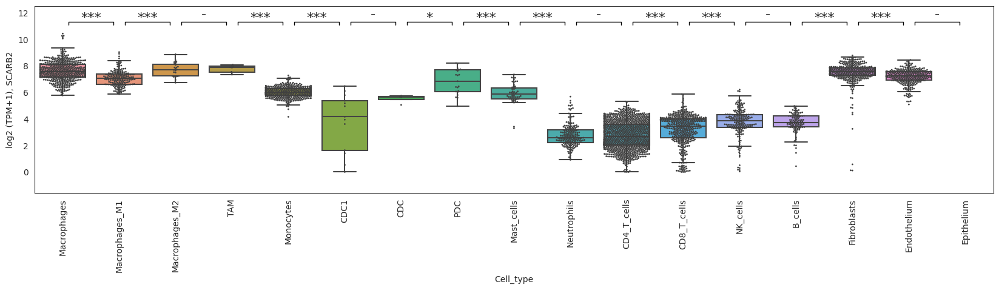

In [59]:
categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
               'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'CD8_T_cells', 
              'NK_cells', 'B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',            
]
gene = 'SCARB2'
boxplot_with_pvalue(public_cells_expr.loc[gene], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order=categories, s=2)
plt.ylabel(f'log2 (TPM+1), {gene}')
plt.xticks(rotation=90)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_bad_gene_SCARB2_sorted_cells.svg", format="svg")

plt.show()

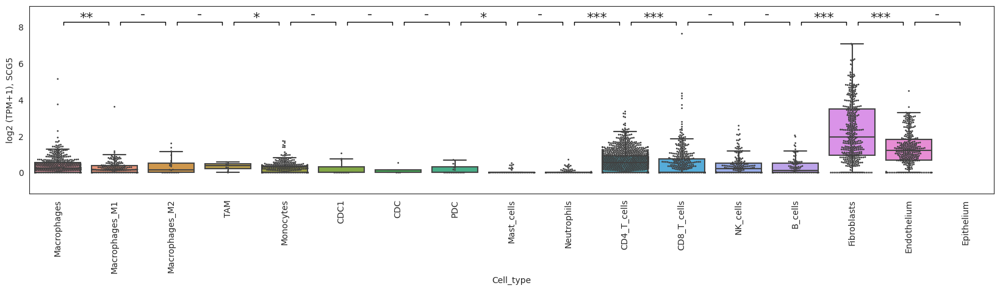

In [60]:
categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
               'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'CD8_T_cells', 
              'NK_cells', 'B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',            
]
gene = 'SCG5'
boxplot_with_pvalue(public_cells_expr.loc[gene], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order=categories, s=2)
plt.ylabel(f'log2 (TPM+1), {gene}')
plt.xticks(rotation=90)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_bad_gene_SCG5_sorted_cells.svg", format="svg")

plt.show()

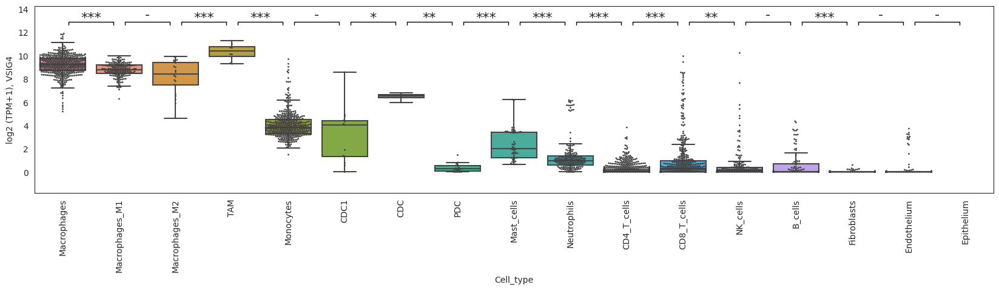

In [61]:
categories = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'TAM', 'Monocytes', 'CDC1', 'CDC', 'PDC', 
               'Mast_cells', 'Neutrophils',
              'CD4_T_cells', 'CD8_T_cells', 
              'NK_cells', 'B_cells',
              'Fibroblasts', 'Endothelium', 'Epithelium',            
]
gene = 'VSIG4'
boxplot_with_pvalue(public_cells_expr.loc[gene], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order=categories, s=2)
plt.ylabel(f'log2 (TPM+1), {gene}')
plt.xticks(rotation=90)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_good_gene_VSIG4_sorted_cells.svg", format="svg")

plt.show()

# Signature validation: Sorted cells and cell lines from BG lab

## read anno

In [62]:
# Here we check which version of annotation is the newest - oldest directories go first
paths = sorted(Path('/uftp2/Databases/sorted_cell_databases/').iterdir(), key=os.path.getmtime)
paths

[PosixPath('/uftp2/Databases/sorted_cell_databases/jan2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/march2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/june2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/jan2023'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/current_version'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/March2024')]

In [65]:
cells_clean = read_dataset('/uftp2/Databases/sorted_cell_databases/jan2023/lab_clean_annotation.tsv')

In [66]:
cells_clean = cells_clean.loc[~cells_clean['Cell_type_details'].str.contains('topoff', case=False, na=False)]
cells_clean = cells_clean.loc[~cells_clean['Cell_type_details'].str.contains('minimal sample', case=False, na=False)]

NB: Клеточный тип из описания датасета обозначен в колонке Cell_type, однако бывает, 
    что более подробное описание образца содержится в колонке Cell_type_details. 
    Также есть колонка Deconvolution_cell_type, 
    в которой значению в колонке Cell_type по возможности сопоставляется такой клеточный тип, 
    для которого сейчас существует модель (https://bostongene.atlassian.net/wiki/spaces/TD/pages/3626696724/bulk+RNA-seq)

In [67]:
cells_clean = cells_clean[['Cell_type', 'Dataset', 'Sample']]

In [68]:
lab_cells_annot = cells_clean.copy()
lab_cells_annot = lab_cells_annot.reset_index(drop=True)

In [69]:
# split celltypes in case there are multiple celltypes per sample

celltypes_split = pd.DataFrame()

for i, j in lab_cells_annot.dropna(subset=['Cell_type']).iterrows():
    if ';' in j['Cell_type']:
        ct = j['Cell_type'].split(';')
        new_row = j.copy()
        for c in ct:
            new_row['Cell_type'] = c
            celltypes_split = celltypes_split.append(new_row, ignore_index=True)
        lab_cells_annot.drop(i, inplace=True)
        
lab_cells_annot = lab_cells_annot.append(celltypes_split)

In [70]:
lab_cells_annot.index = lab_cells_annot.Sample

In [71]:
set(lab_cells_annot.index).intersection(public_cells_annot.index)

set()

## anno stats

In [72]:
pd.options.display.max_rows = len(lab_cells_annot['Cell_type'].value_counts())
lab_cells_annot['Cell_type'].value_counts()

Monocytes                                      30
Central_memory_T_helpers                       26
Total_live                                     24
Effector_memory_T_helpers                      21
CD4_T_cells                                    20
B_cells                                        17
Tfh_cells                                      17
Tumor                                          16
CD206pos_Macrophages                           15
Naive_CD8_T_cells                              13
CD8_T_cells                                    13
NK_cells                                       13
CD206neg_Macrophages                           12
Th1_CTL                                        12
Fibroblasts_CD146+                             11
Naive_CD4_T_cells                              11
Th1_resting_cells                              10
CX3CR1+_PD1+_CD45RA-_Memory_CD8_T_cells        10
CX3CR1-_PD1+_CXCR3+_Memory_CD8_T_cells          9
CD57neg_Cytotoxic_NK_cells                      9


In [73]:
pd.options.display.max_rows = 20

In [74]:
lab_cells_annot.head()

,Cell_type,Dataset,Sample
Sample,,,
RNASeq-normal-201202_Next_Sample2,Classical_monocytes,RNASeq-normal-201202_Next_Sample2_dataset,RNASeq-normal-201202_Next_Sample2
RNASeq-normal-201202_Next_Sample3,B_cells,RNASeq-normal-201202_Next_Sample3_dataset,RNASeq-normal-201202_Next_Sample3
RNASeq-normal-201202_Next_Sample4,CD4_T_cells,RNASeq-normal-201202_Next_Sample4_dataset,RNASeq-normal-201202_Next_Sample4
RNASeq-normal-201202_Next_Sample5,Central_memory_CD4_T_cells,RNASeq-normal-201202_Next_Sample5_dataset,RNASeq-normal-201202_Next_Sample5
RNASeq-normal-201202_Next_Sample6,Effector_memory_CD4_T_cells,RNASeq-normal-201202_Next_Sample6_dataset,RNASeq-normal-201202_Next_Sample6


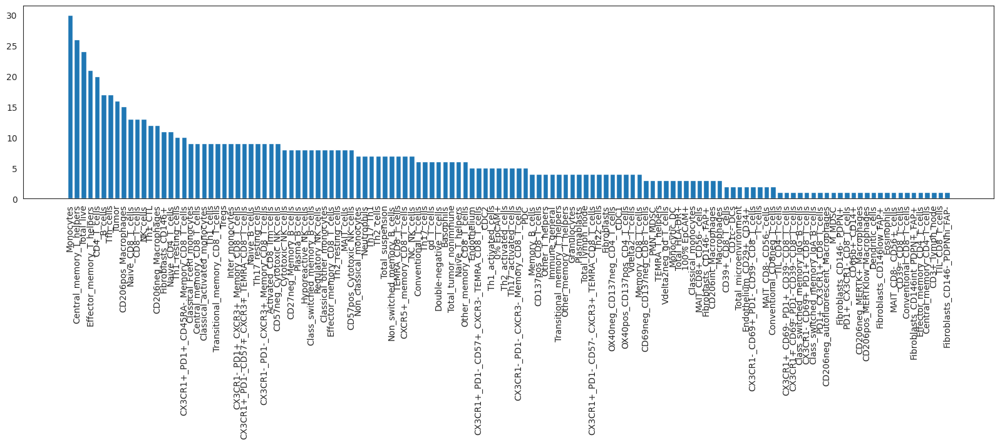

In [75]:
# a little bit of statistics
#example: which cell types do we have in lab_cells_annot?
plt.figure(figsize=(20, 4))
x = lab_cells_annot['Cell_type'].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

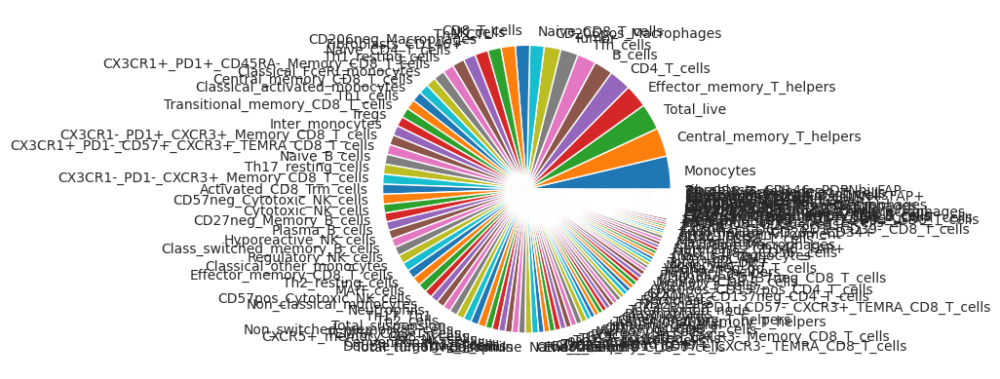

In [76]:
plt.pie(x, labels=x.index)
plt.show()

## read expressions

In [77]:
lab_cells_expr = pd.read_csv(
    "/uftp2/Databases/sorted_cell_databases/jan2023/lab_clean_expressions.tsv",
    sep='\t',
    index_col=0)

In [78]:
lab_cells_expr = np.log2(lab_cells_expr+1)

## define custom signature

In [79]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')

#add here a custon signature name
signature_name = 'Macrophages'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

## Validation itself

In [80]:
#define celltypes of interest
categories = [
              'CD206neg_Macrophages', 'CD206neg_MERTK+_Macrophages', 'CD206neg_autofluorescent_Macrophages', 'CD206pos_Macrophages', 'CD206pos_MERTKlow_Macrophages', 'CD206pos_CD209pos_Macrophages', 'CD206int_Macrophages', 'Macrophages', 'Monocytes', 'Classical_monocytes', 'Non_classical_monocytes', 'CDC1', 'CDC2', 'PDC', 
              'Eosinophils', 'Basophils', 'Neutrophils', 
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells', 
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Tumor',
              ]

#dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat([annot, lab_cells_annot.loc[lab_cells_annot['Cell_type'].isin([i])]])

#for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(annot['Cell_type'],
                                    categories=categories,
                                    ordered=True)
annot = annot.sort_values('Cell_type')

In [81]:
subsampling_lab = [i[1].sample(np.min([5, i[1].shape[0]])).index.tolist() for i in annot.groupby('Cell_type')]

In [82]:
subsampling_lab = [item for sublist in subsampling_lab for item in sublist]

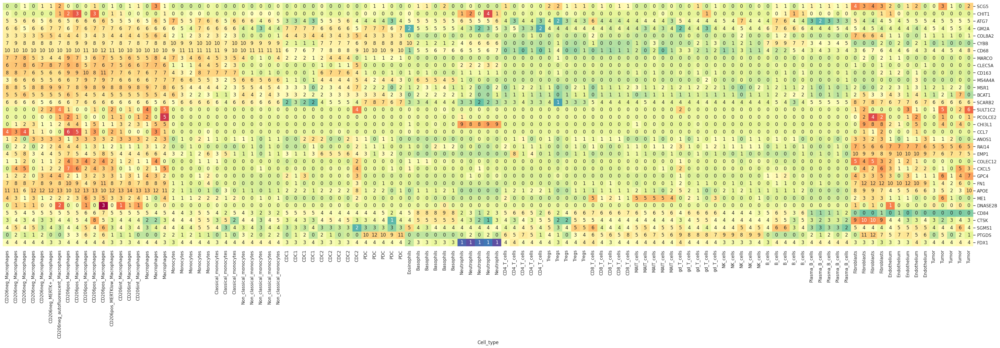

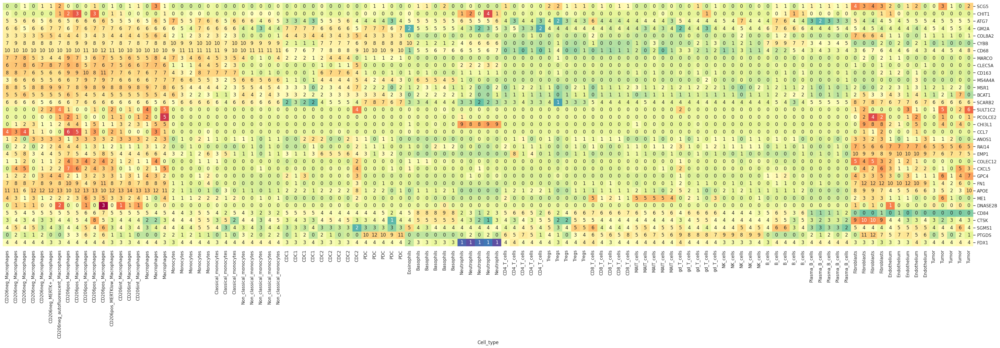

In [85]:
# A simple heatmap with log2 TPM of subsampled cells from celltypes of interest
genes_heatmap(
    lab_cells_expr[subsampling_lab],
    annot.reindex(subsampling_lab)['Cell_type'],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color='blue',
    figsize=(45, 15),
    font_scale=1,
    show_indices=False,
    col_cluster=False,
    col_dendrogram=False,
    row_dendrogram=False)
plt.show()

In [86]:
sns.reset_defaults()
sns.set_style('white')

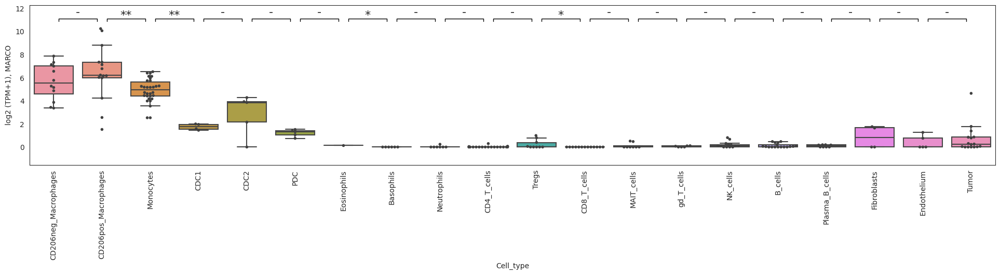

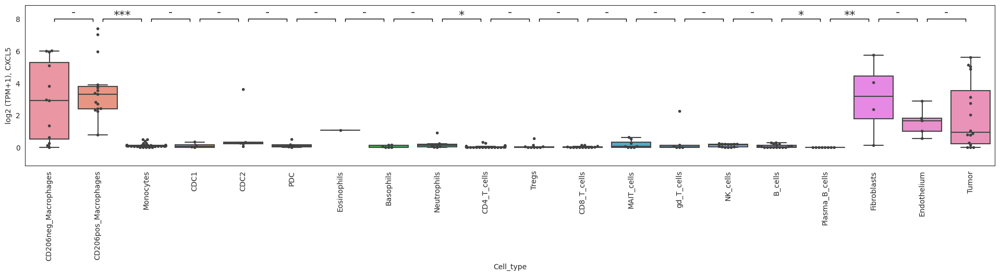

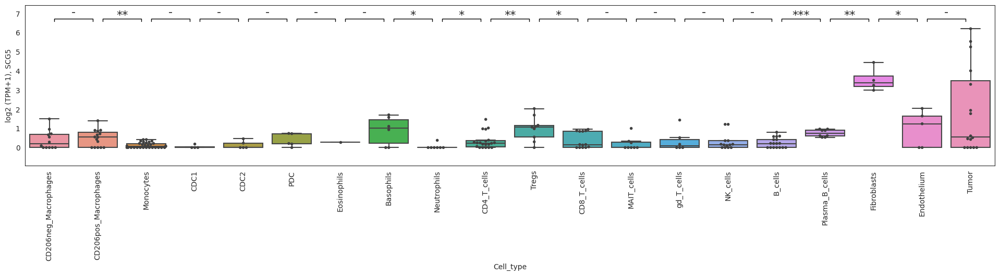

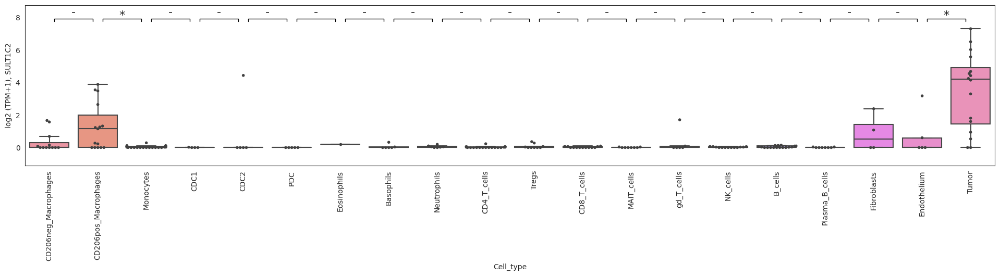

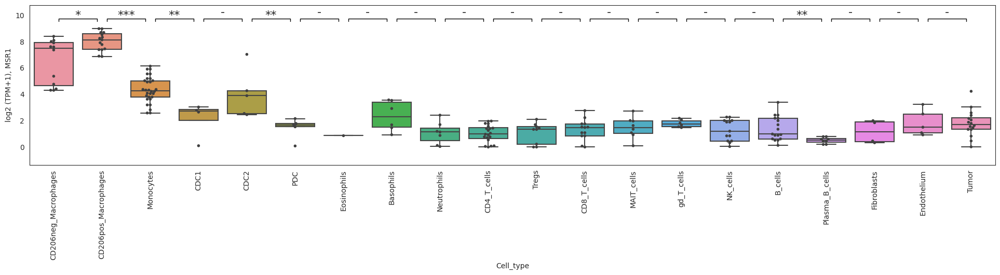

...

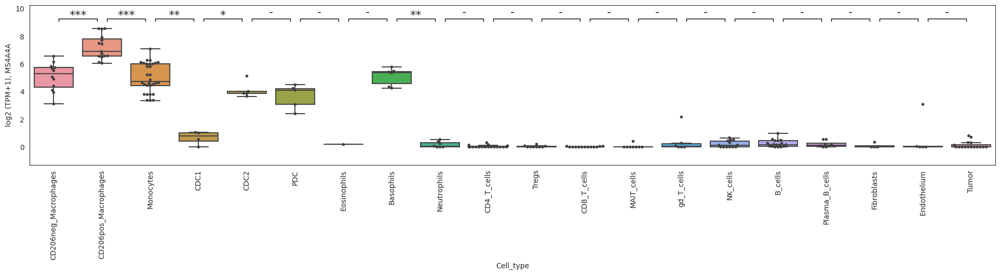

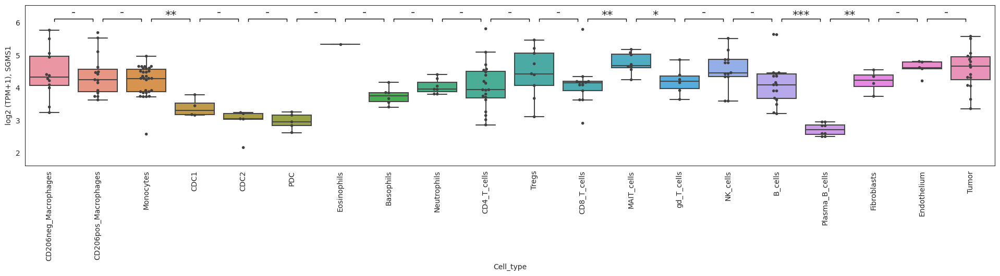

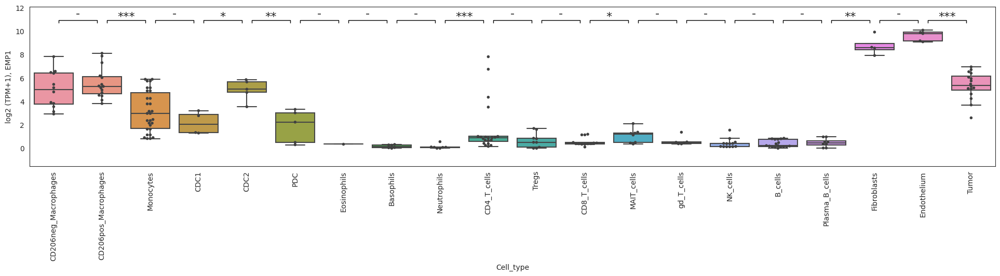

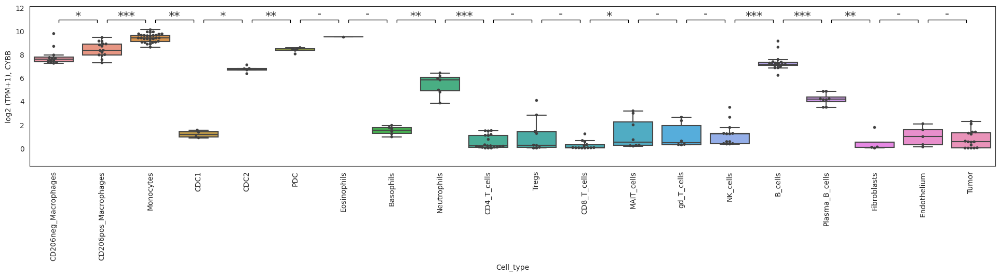

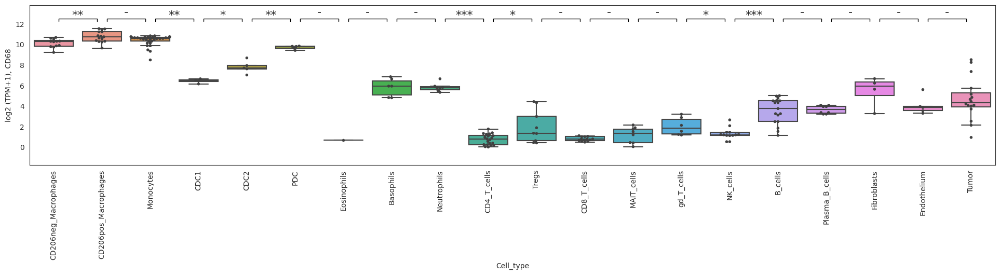

In [87]:
# boxplots depicting signature genes expression in celltypes of interest

categories = ['CD206neg_Macrophages', 'CD206pos_Macrophages', 'Monocytes', 'CDC1', 'CDC2', 'PDC',
              'Eosinophils', 'Basophils', 'Neutrophils', 
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells', 
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Tumor',             
]

for gene in signature_of_interest:
    boxplot_with_pvalue(lab_cells_expr.loc[gene], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order = categories, s=4, 
                       )
    plt.ylabel(f'log2 (TPM+1), {gene}')
    plt.xticks(rotation=90)
    plt.show()

In [88]:
lab_cells_ssgsea_unscaled = ssgsea_formula(lab_cells_expr, gmt_genes_alt_names(geneset_of_interest, lab_cells_expr.index, verbose=False)).T

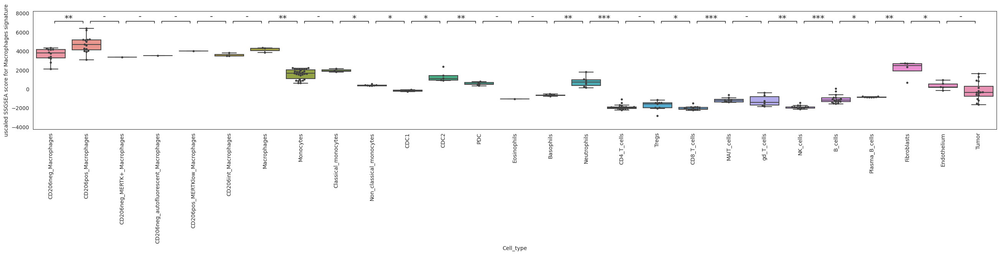

In [89]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['CD206neg_Macrophages', 'CD206pos_Macrophages', 'CD206neg_MERTK+_Macrophages', 'CD206neg_autofluorescent_Macrophages', 'CD206pos_MERTKlow_Macrophages', 'CD206int_Macrophages', 'Macrophages', 'Monocytes', 'Classical_monocytes', 'Non_classical_monocytes', 'CDC1', 'CDC2', 'PDC', 
              'Eosinophils', 'Basophils', 'Neutrophils', 
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells', 
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Tumor']

boxplot_with_pvalue(lab_cells_ssgsea_unscaled[signature_name], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order = categories, s=4, 
#                    hue=annot[annot['Cell_type'].isin(categories)]['Senescence'], hue_order=['Not_senescent', 'Senescent'], palette=spalette
                   )

plt.xticks(rotation=90)
plt.ylabel(f'uscaled SSGSEA score for {signature_name} signature')
plt.show()

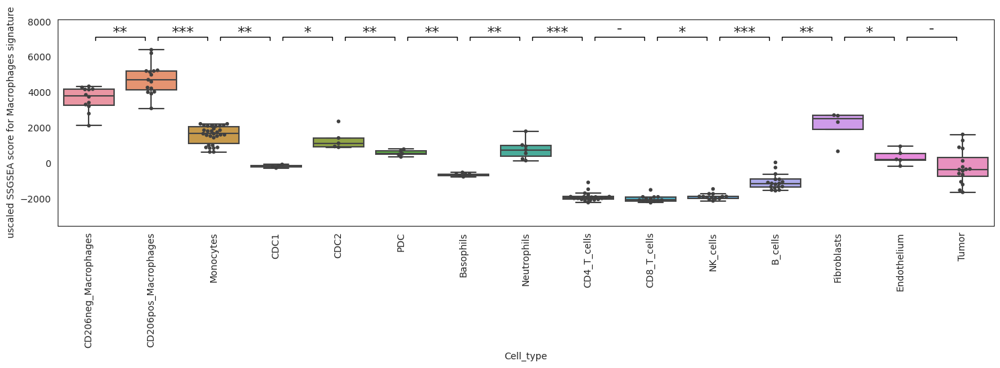

In [90]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['CD206neg_Macrophages', 'CD206pos_Macrophages', 'Monocytes', 'CDC1', 'CDC2', 'PDC',
              'Basophils', 'Neutrophils', 
              'CD4_T_cells', 'CD8_T_cells',
              'NK_cells', 'B_cells', 
              'Fibroblasts', 'Endothelium', 'Tumor',
          
]

boxplot_with_pvalue(lab_cells_ssgsea_unscaled[signature_name], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order = categories, s=4, 
#                    hue=annot[annot['Cell_type'].isin(categories)]['Senescence'], hue_order=['Not_senescent', 'Senescent'], palette=spalette
                   )

plt.xticks(rotation=90)
plt.ylabel(f'uscaled SSGSEA score for {signature_name} signature')
plt.show()

## Tuned signature validation

In [91]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')
#OR
signature_of_interest = [
'MARCO',
# 'CXCL5', low expression in M2/TAMs, expression in some cancer lines, low correlation with deconvolution and with other signature genes (TCGA), no expression in single cell macrophages
# 'SCG5',
# 'SULT1C2',
 'MSR1',
# 'CTSK', fibroblasts
# 'PTGDS', pDC, fibroblasts
# 'COLEC12', fibroblasts
# 'GPC4', fibroblasts, tumor
# 'PCOLCE2', fibroblasts
# 'CHIT1', low correlation with other genes (TCGA)
# 'ANOS1',
 'CLEC5A',
# 'ME1', fibroblasts, tumor, MAIT
# 'DNASE2B', low expression, no correlation with deconvolution
 'CCL7',
# 'FN1', fibroblasts
 'CD163',
# 'GM2A', not specific
# 'SCARB2', not specific
# 'BCAT1', not specific
# 'RAI14', fibroblasts, endothelium, tumor
# 'COL8A2', fibroblasts
# 'APOE', fibroblasts
# 'CHI3L1', neutrophils
# 'ATG7', not specific
# 'CD84', not specific
# 'FDX1', not specific
 'MS4A4A',
# 'SGMS1', not specific
# 'EMP1', fibroblasts, endothelium, tumor
# 'CYBB', DC, B cells
 'CD68',
    'CSF1R', 
    'SIGLEC1', 
    'C1QA', 
    'C1QC', 
    'VSIG4'

]
#actually many deleted genes have problems with expression in cancer lines, low TCGA correlations and single cell. I can write it thoroughly if we need it

#add here a custon signature name
signature_name = 'Macrophages_new'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

In [92]:
subsampling_lab = [i[1].sample(np.min([5, i[1].shape[0]])).index.tolist() for i in annot.groupby('Cell_type')]

In [93]:
subsampling_lab = [item for sublist in subsampling_lab for item in sublist]

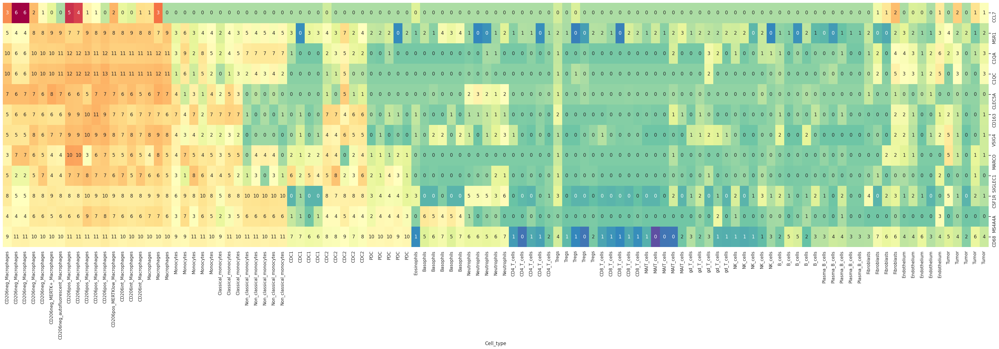

In [96]:
# A simple heatmap with log2 TPM of subsampled cells from celltypes of interest
genes_heatmap(
    lab_cells_expr[subsampling_lab],
    annot.reindex(subsampling_lab)['Cell_type'],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color='blue',
    figsize=(45, 15),
    font_scale=1,
    show_indices=False,
    col_cluster=False,
    col_dendrogram=False,
    row_dendrogram=False)
plt.show()

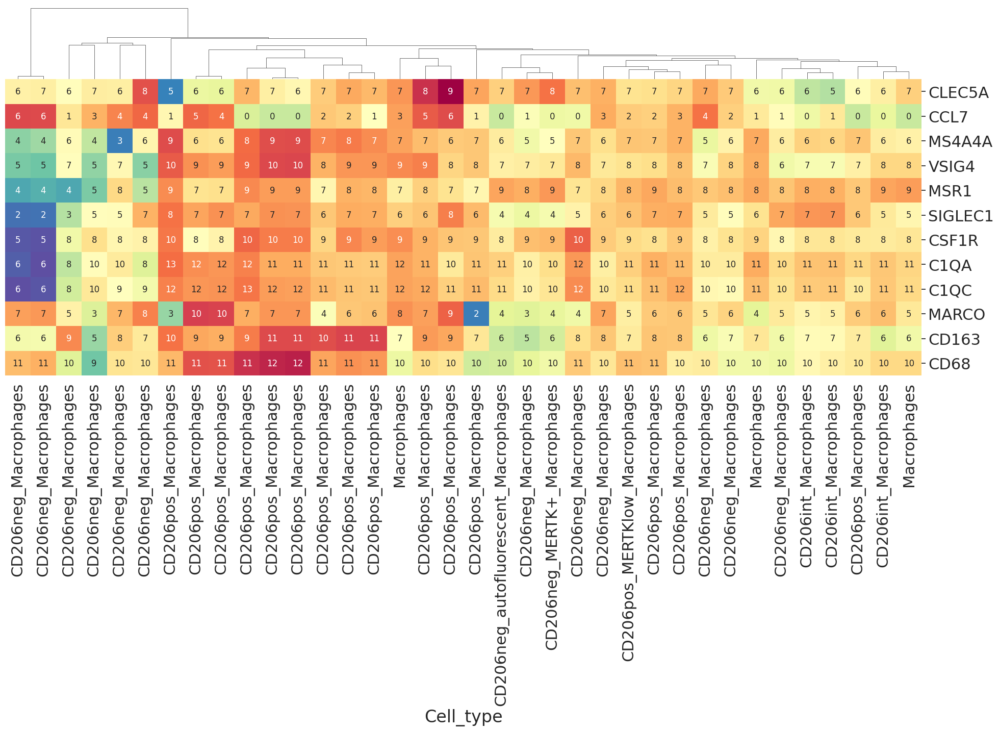

In [100]:
# A simple heatmap with log2 TPM of all cells of current celltype
c = ['CD206neg_Macrophages', 'CD206neg_MERTK+_Macrophages', 'CD206neg_autofluorescent_Macrophages', 'CD206pos_Macrophages', 
     'CD206pos_MERTKlow_Macrophages', 'CD206pos_CD209pos_Macrophages', 'CD206int_Macrophages', 'Macrophages']
subsampling_lab = annot[annot['Cell_type'].isin(c)].index

genes_heatmap(
    lab_cells_expr[subsampling_lab],
    annot.reindex(subsampling_lab)['Cell_type'],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color='blue',
    figsize=(25, 15),
    font_scale=2,
    show_indices=False,
    col_cluster=True,
    col_dendrogram=True,
    row_dendrogram=False)
plt.show()

In [101]:
sns.reset_defaults()
sns.set_style('white')

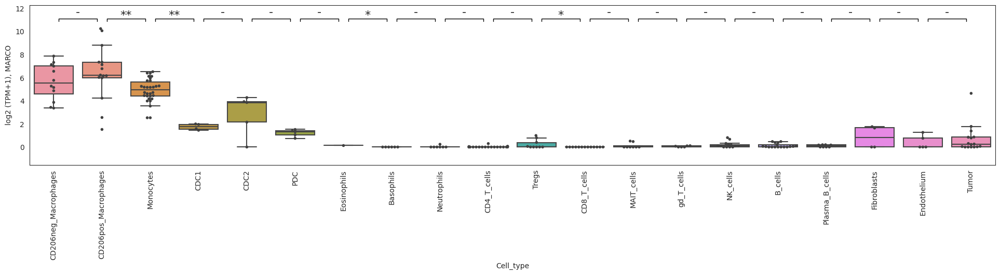

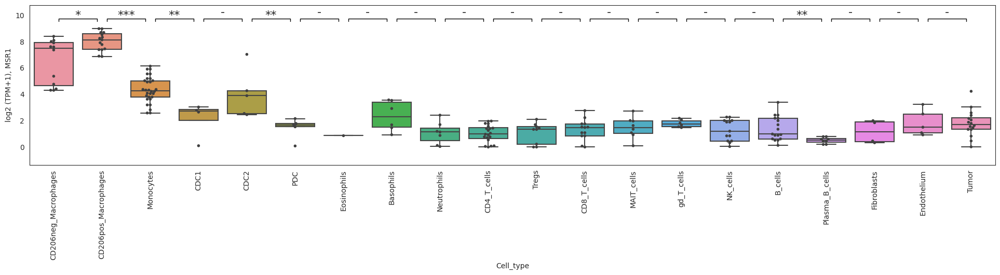

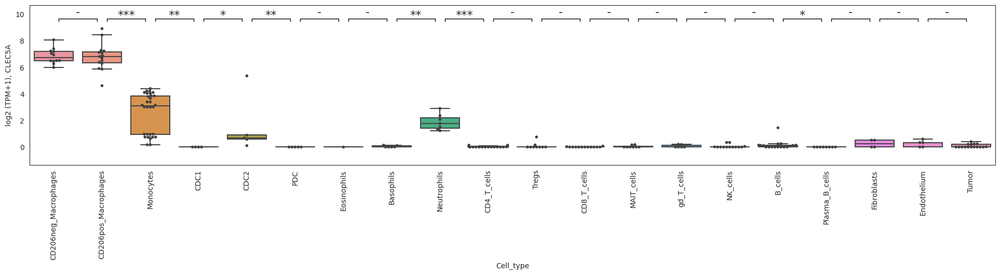

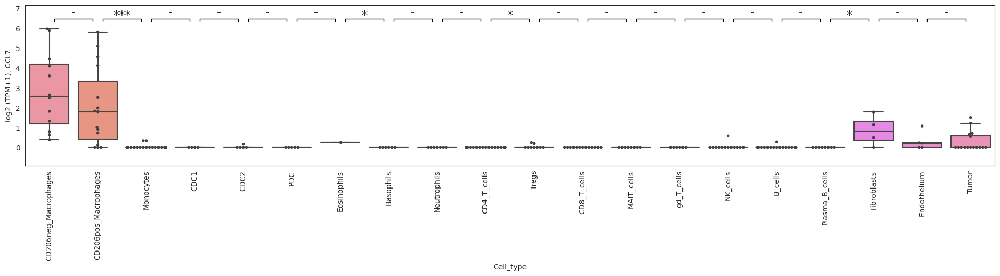

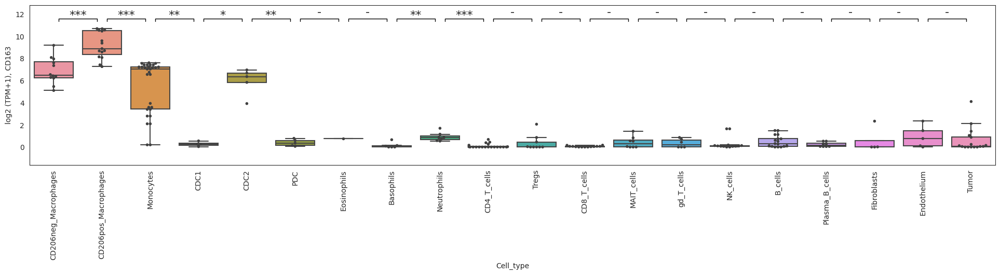

...

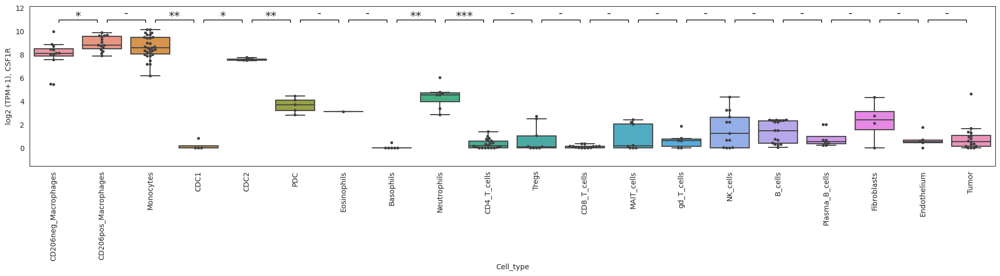

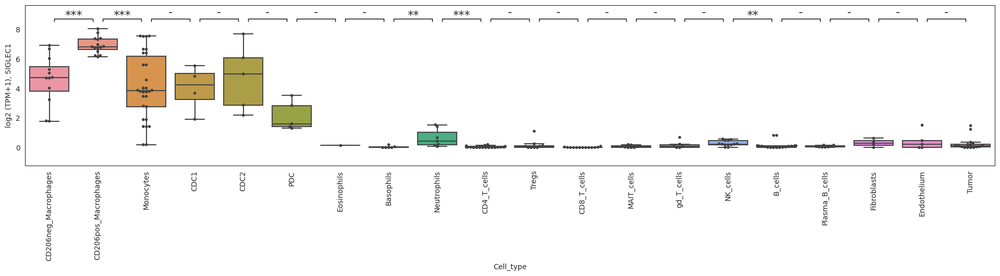

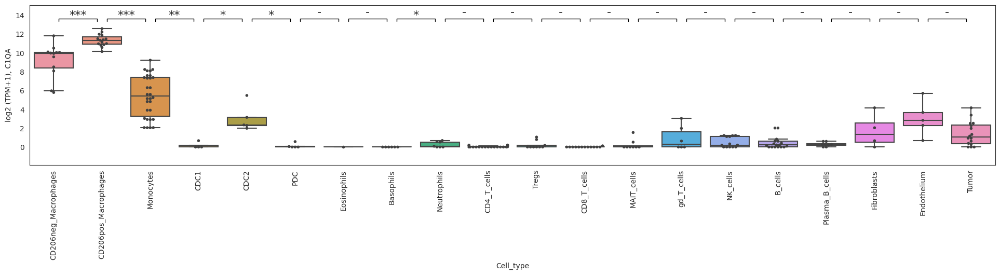

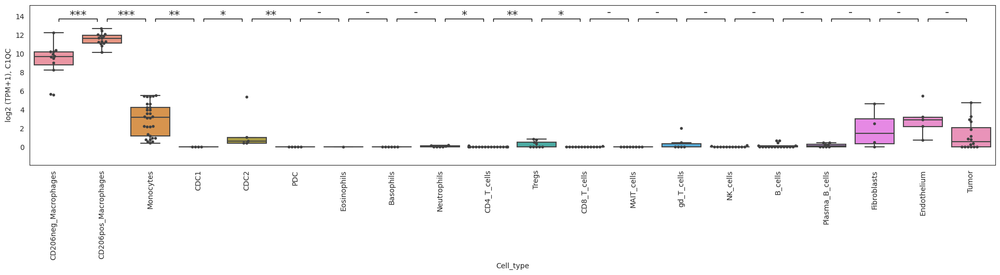

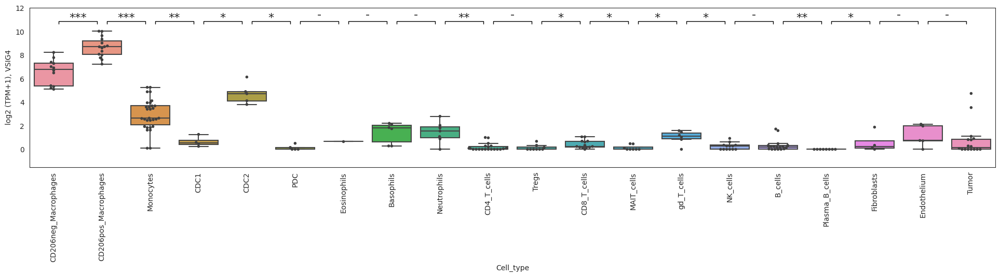

In [102]:
# boxplots depicting signature genes expression in celltypes of interest

categories = ['CD206neg_Macrophages', 'CD206pos_Macrophages', 'Monocytes', 'CDC1', 'CDC2', 'PDC',
              'Eosinophils', 'Basophils', 'Neutrophils', 
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells', 
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Tumor',             
]

for gene in signature_of_interest:
    boxplot_with_pvalue(lab_cells_expr.loc[gene], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order = categories, s=4, 
                       )
    plt.ylabel(f'log2 (TPM+1), {gene}')
    plt.xticks(rotation=90)
    plt.show()

In [103]:
lab_cells_ssgsea_unscaled = ssgsea_formula(lab_cells_expr, gmt_genes_alt_names(geneset_of_interest, lab_cells_expr.index, verbose=False)).T

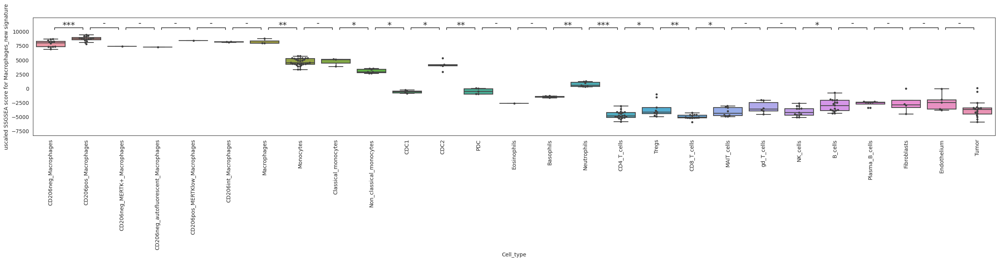

In [104]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['CD206neg_Macrophages', 'CD206pos_Macrophages', 'CD206neg_MERTK+_Macrophages', 'CD206neg_autofluorescent_Macrophages', 'CD206pos_MERTKlow_Macrophages', 'CD206int_Macrophages', 'Macrophages', 'Monocytes', 'Classical_monocytes', 'Non_classical_monocytes', 'CDC1', 'CDC2', 'PDC', 
              'Eosinophils', 'Basophils', 'Neutrophils', 
              'CD4_T_cells', 'Tregs', 
              'CD8_T_cells', 'MAIT_cells', 'gd_T_cells', 
              'NK_cells', 'B_cells', 'Plasma_B_cells',
              'Fibroblasts', 'Endothelium', 'Tumor']

boxplot_with_pvalue(lab_cells_ssgsea_unscaled[signature_name], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order = categories, s=4, 
#                    hue=annot[annot['Cell_type'].isin(categories)]['Senescence'], hue_order=['Not_senescent', 'Senescent'], palette=spalette
                   )

plt.xticks(rotation=90)
plt.ylabel(f'uscaled SSGSEA score for {signature_name} signature')
plt.show()

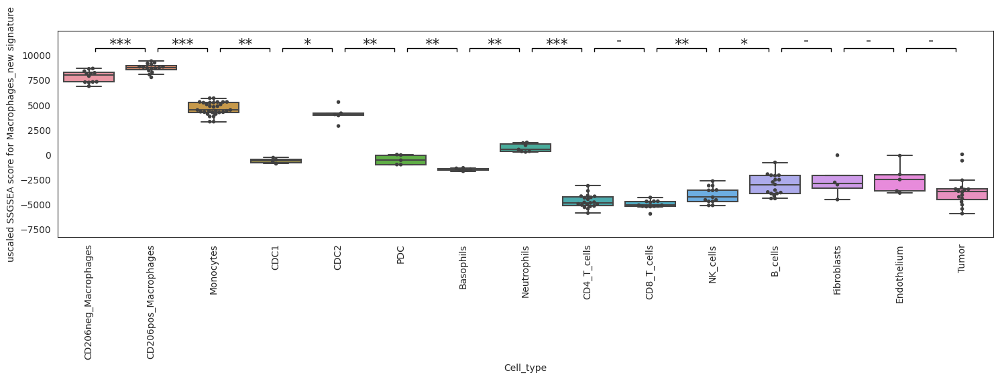

In [105]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['CD206neg_Macrophages', 'CD206pos_Macrophages', 'Monocytes', 'CDC1', 'CDC2', 'PDC',
              'Basophils', 'Neutrophils', 
              'CD4_T_cells', 'CD8_T_cells',
              'NK_cells', 'B_cells', 
              'Fibroblasts', 'Endothelium', 'Tumor',
          
]

boxplot_with_pvalue(lab_cells_ssgsea_unscaled[signature_name], annot[annot['Cell_type'].isin(categories)]['Cell_type'], order = categories, s=4, 
#                    hue=annot[annot['Cell_type'].isin(categories)]['Senescence'], hue_order=['Not_senescent', 'Senescent'], palette=spalette
                   )

plt.xticks(rotation=90)
plt.ylabel(f'uscaled SSGSEA score for {signature_name} signature')

plt.show()

# Signature validation: Cancer cell lines

## read anno

In [106]:
# Here we check which version of annotation is the newest - oldest directories go first
paths = sorted(Path('/uftp2/Databases/sorted_cell_databases/').iterdir(), key=os.path.getmtime)
paths

[PosixPath('/uftp2/Databases/sorted_cell_databases/jan2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/march2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/june2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/jan2023'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/current_version'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/March2024')]

In [107]:
cells_clean = read_dataset('/uftp2/Databases/sorted_cell_databases/jan2023/cancer_cell_lines_all_annotation.tsv')

In [108]:
cells_clean = cells_clean[['Tumor_type', 'Dataset', 'Sample', 'Therapy']]

In [109]:
cancer_cells_annot = cells_clean.copy()

## anno stats

In [110]:
pd.options.display.max_rows = len(cancer_cells_annot['Tumor_type'].value_counts())
cancer_cells_annot['Tumor_type'].value_counts()

Lung_Adenocarcinoma                                  886
Prostate_Cancer                                      553
Pancreatic_Ductal_Adenocarcinoma                     269
Melanoma                                             247
Invasive_Breast_Carcinoma                            188
Acute_Myeloid_Leukemia                               186
EBV-B_cells                                          185
Large_Cell_Lung_Carcinoma                            181
Diffuse_Large_B_Cell_Lymphoma                        176
Mantle_Cell_Lymphoma                                 167
Cutaneous_Melanoma                                   126
Squamous_Cell_Carcinoma_of_the_Head_and_Neck         121
Chronic_Lymphocytic_Leukemia                         114
Colon_Adenocarinoma                                  102
Breast_Adenocarcinoma                                 95
Colon_Carinoma                                        94
Breast_Neoplasm                                       87
Glioblastoma                   

In [111]:
pd.options.display.max_rows = 20

In [112]:
cancer_cells_annot.head()

,Tumor_type,Dataset,Sample,Therapy
SRX4143039,Small_Cell_Lung_Carcinoma,GSE115122,SRX4143039,Without_therapy
SRX2495594,Diffuse_Large_B_Cell_Lymphoma,GSE93675,SRX2495594,Without_therapy
SRX3506075,Lung_Adenocarcinoma,GSE108464,SRX3506075,Without_therapy
SRX2314325,Diffuse_Large_B_Cell_Lymphoma,GSE89339,SRX2314325,Without_therapy
SRX2035865,Multiple_Myeloma,GSE85840,SRX2035865,Without_therapy


In [113]:
pd.crosstab(cancer_cells_annot.Tumor_type, cancer_cells_annot.Therapy)

Therapy,BRAFi,BRAFi+MEKi,BTK inhibitor (Ibrutinib),Day_10_of_PBS,Day_10_of_Ribavarin_80mg/kg/twice daily intraperitoneally,Lck inhibitor,No_data,Without_therapy,previously treated for non-Hodgkin lymphoma (NHL),"rituximab dosed 25 mg/kg, three times a week over 21 days."
Tumor_type,,,,,,,,,,
Acute_Erythroid_Leukemia,0,0,0,0,0,0,6,0,0,0
Acute_Lymphoblastic_Leukemia,0,0,0,0,0,0,0,42,0,0
Acute_Monocytic_Leukemia,0,0,0,0,0,0,0,20,0,0
Acute_Myeloid_Leukemia,0,0,0,0,0,0,0,186,0,0
Adenosquamous_Cell_Lung_Carcinoma,0,0,0,0,0,0,0,4,0,0
...,...,...,...,...,...,...,...,...,...,...
hESC,0,0,0,0,0,0,1,0,0,0
mesenchymal stem cells day 1,0,0,0,0,0,0,1,0,0,0
mesenchymal stem cells day 3,0,0,0,0,0,0,1,0,0,0


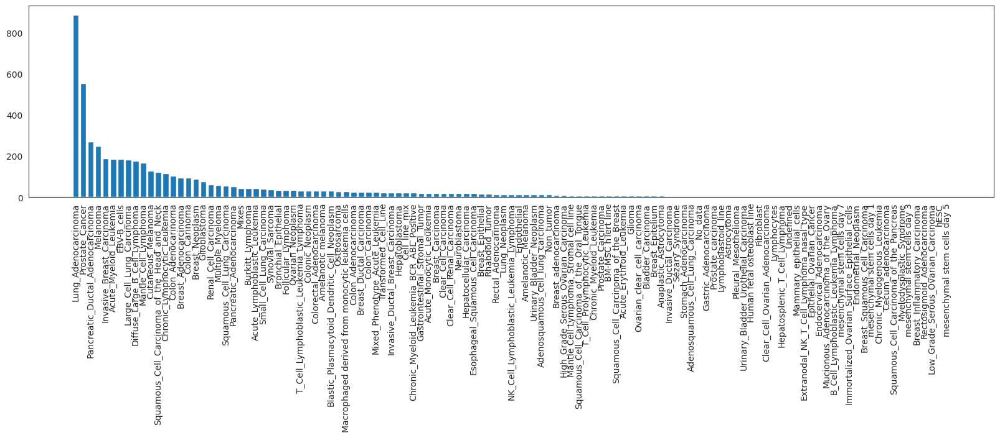

In [114]:
# a little bit of statistics
#example: which cell types do we have in cancer_cells_annot?
plt.figure(figsize=(20, 4))
x = cancer_cells_annot['Tumor_type'].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

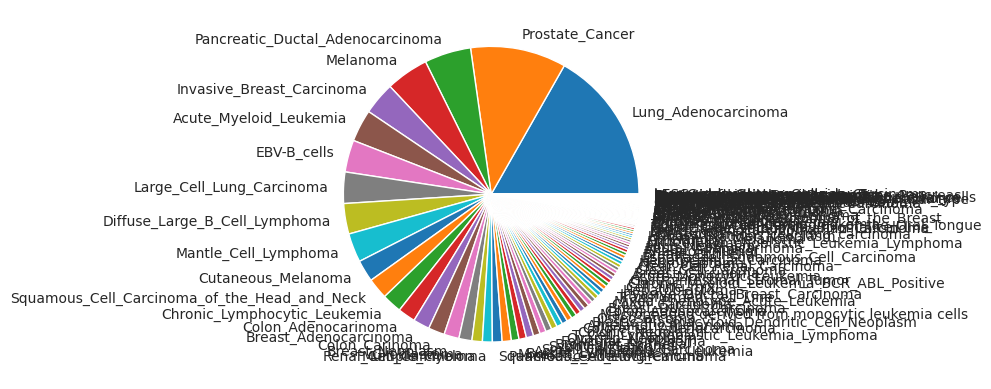

In [115]:
plt.pie(x, labels=x.index)
plt.show()

## read expressions

In [116]:
cancer_cells_expr = read_expressions(cancer_cells_annot)

In [117]:
cancer_cells_expr = np.log2(cancer_cells_expr+1)

## define custom signature

In [118]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')

#add here a custon signature name
signature_name = 'Macrophages'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

## Validation itself

In [119]:
#define diagnoses of interest
categories = ['Lung_Adenocarcinoma', 'Large_Cell_Lung_Carcinoma', 'Prostate_Cancer', 'Pancreatic_Ductal_Adenocarcinoma', 
              'Invasive_Breast_Carcinoma', 'Colon_Adenocarinoma', 'Ovarian_Neoplasm', 
              'Squamous_Cell_Carcinoma_of_the_Head_and_Neck', 'Melanoma', 'Renal_Cell_Carcinoma', 'Bladder_Carcinoma', 'Small_Cell_Lung_Carcinoma', 
              'Synovial_Sarcoma', 'Hepatoblastoma', 'Glioblastoma', 'Neuroblastoma',
              'Diffuse_Large_B_Cell_Lymphoma', 'Mantle_Cell_Lymphoma', 'Burkitt_Lymphoma',
              'Chronic_Lymphocytic_Leukemia', 'Acute_Myeloid_Leukemia', 'Multiple_Myeloma']

#dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat([annot, cancer_cells_annot.loc[cancer_cells_annot['Tumor_type'].isin([i])]])

#for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(annot.Tumor_type,
                                    categories=categories,
                                    ordered=True)
annot = annot.sort_values('Tumor_type')

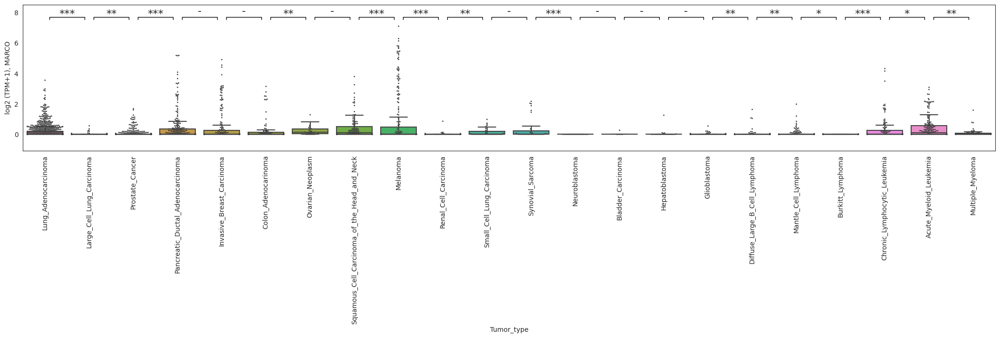

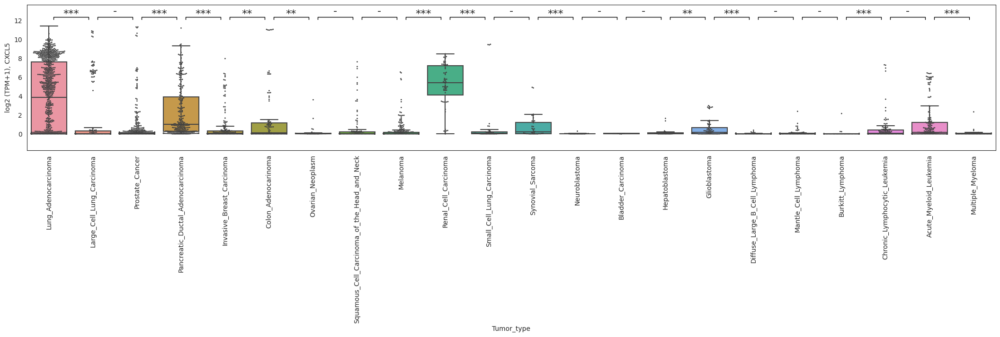

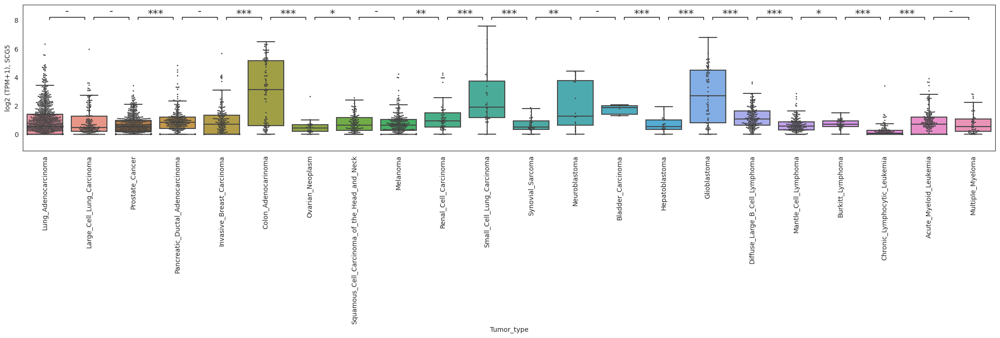

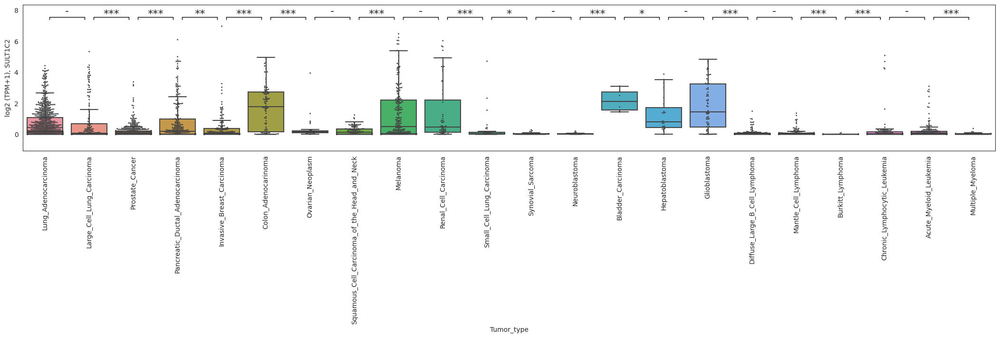

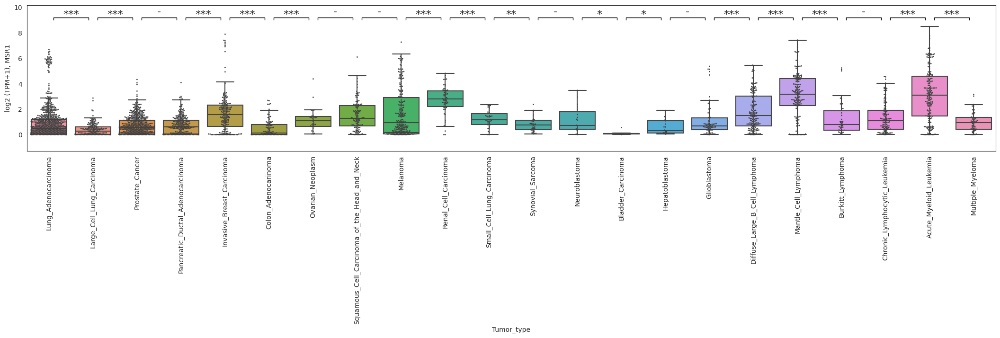

...

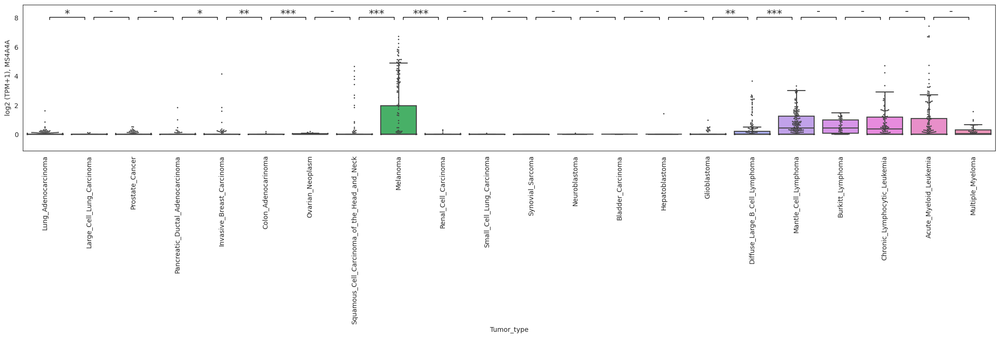

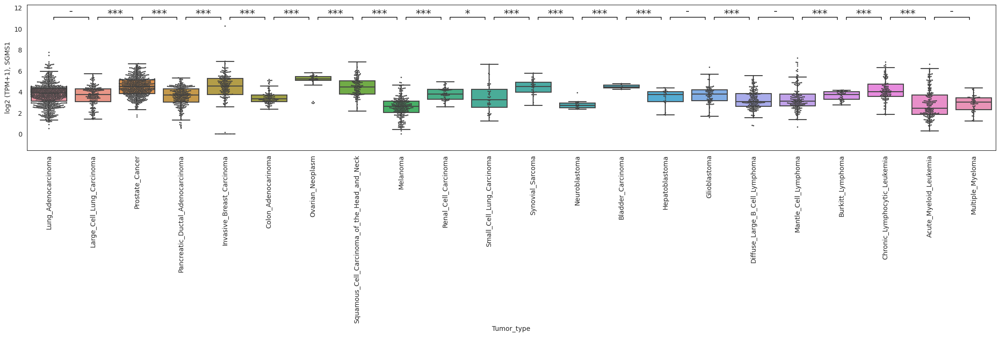

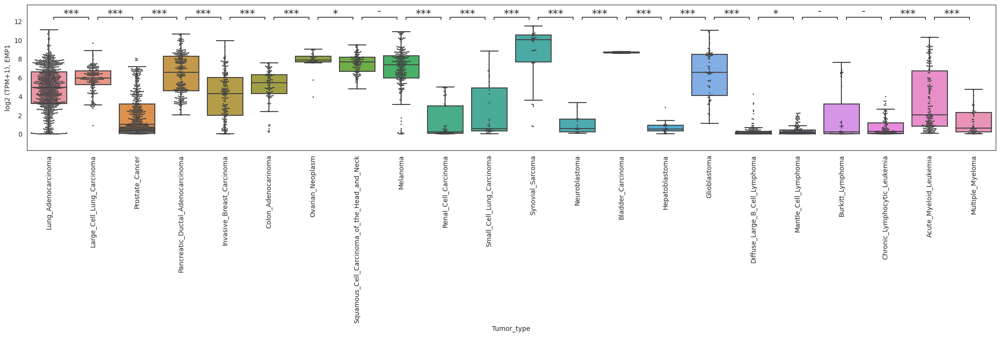

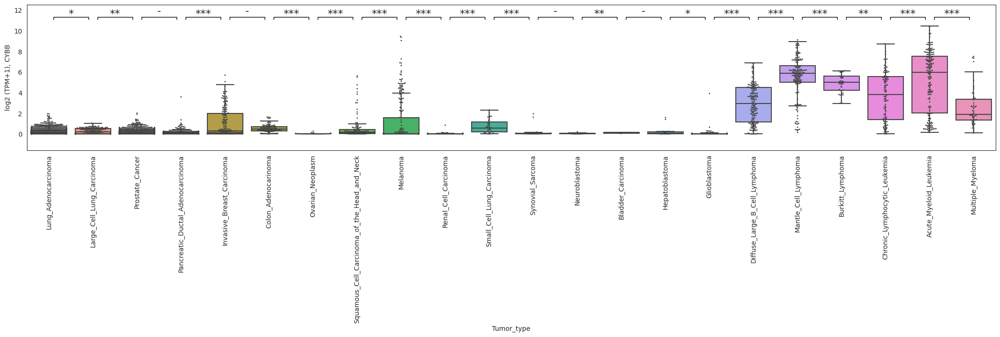

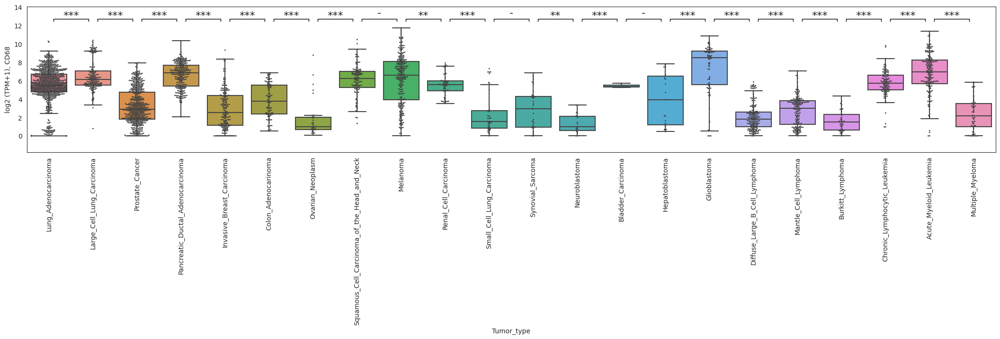

In [122]:
# boxplots depicting signature genes expression in diagnoses of interest

categories = ['Lung_Adenocarcinoma', 'Large_Cell_Lung_Carcinoma', 'Prostate_Cancer', 'Pancreatic_Ductal_Adenocarcinoma', 
              'Invasive_Breast_Carcinoma', 'Colon_Adenocarinoma', 'Ovarian_Neoplasm', 
              'Squamous_Cell_Carcinoma_of_the_Head_and_Neck', 'Melanoma', 'Renal_Cell_Carcinoma', 'Small_Cell_Lung_Carcinoma', 
              'Synovial_Sarcoma',  'Neuroblastoma',
              'Bladder_Carcinoma', 'Hepatoblastoma', 'Glioblastoma',
              'Diffuse_Large_B_Cell_Lymphoma', 'Mantle_Cell_Lymphoma', 'Burkitt_Lymphoma',
              'Chronic_Lymphocytic_Leukemia', 'Acute_Myeloid_Leukemia', 'Multiple_Myeloma'          
]

for gene in signature_of_interest:
    boxplot_with_pvalue(cancer_cells_expr.loc[gene], annot[annot['Tumor_type'].isin(categories)]['Tumor_type'], order=categories, s=2,
                       )
    plt.ylabel(f'log2 (TPM+1), {gene}')
    plt.xticks(rotation=90)
    plt.show()

In [123]:
cancer_cells_ssgsea_unscaled = ssgsea_formula(cancer_cells_expr, gmt_genes_alt_names(geneset_of_interest, cancer_cells_expr.index, verbose=False)).T

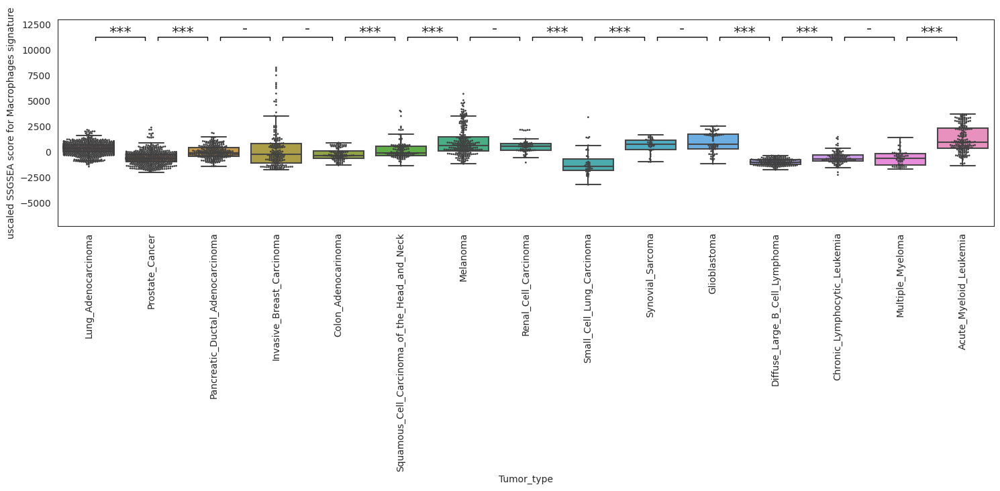

In [124]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['Lung_Adenocarcinoma', 'Prostate_Cancer', 'Pancreatic_Ductal_Adenocarcinoma', #'Large_Cell_Lung_Carcinoma', 
              'Invasive_Breast_Carcinoma', 'Colon_Adenocarinoma', #'Ovarian_Neoplasm', 'Bladder_Carcinoma',
              'Squamous_Cell_Carcinoma_of_the_Head_and_Neck', 'Melanoma', 'Renal_Cell_Carcinoma',  'Small_Cell_Lung_Carcinoma', 
              'Synovial_Sarcoma', 'Glioblastoma',# 'Neuroblastoma', 'Hepatoblastoma', 
              'Diffuse_Large_B_Cell_Lymphoma', #'Mantle_Cell_Lymphoma', 'Burkitt_Lymphoma',
              'Chronic_Lymphocytic_Leukemia', 'Multiple_Myeloma', 'Acute_Myeloid_Leukemia'          
]

boxplot_with_pvalue(cancer_cells_ssgsea_unscaled[signature_name], annot[annot['Tumor_type'].isin(categories)]['Tumor_type'], 
                   order = categories, s=2, y_min=-5000, y_max=10000)

plt.xticks(rotation=90)
plt.ylabel(f'uscaled SSGSEA score for {signature_name} signature')
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_original_cancer_cell_lines.svg", format="svg")

plt.show()

## Tuned signature validation

In [125]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')
#OR
signature_of_interest = [
'MARCO',
# 'CXCL5', low expression in M2/TAMs, expression in some cancer lines, low correlation with deconvolution and with other signature genes (TCGA), no expression in single cell macrophages
# 'SCG5',
# 'SULT1C2',
 'MSR1',
# 'CTSK', fibroblasts
# 'PTGDS', pDC, fibroblasts
# 'COLEC12', fibroblasts
# 'GPC4', fibroblasts, tumor
# 'PCOLCE2', fibroblasts
# 'CHIT1', low correlation with other genes (TCGA)
# 'ANOS1',
 'CLEC5A',
# 'ME1', fibroblasts, tumor, MAIT
# 'DNASE2B', low expression, no correlation with deconvolution
 'CCL7',
# 'FN1', fibroblasts
 'CD163',
# 'GM2A', not specific
# 'SCARB2', not specific
# 'BCAT1', not specific
# 'RAI14', fibroblasts, endothelium, tumor
# 'COL8A2', fibroblasts
# 'APOE', fibroblasts
# 'CHI3L1', neutrophils
# 'ATG7', not specific
# 'CD84', not specific
# 'FDX1', not specific
 'MS4A4A',
# 'SGMS1', not specific
# 'EMP1', fibroblasts, endothelium, tumor
# 'CYBB', DC, B cells
 'CD68',
    'CSF1R', 
    'SIGLEC1', 
    'C1QA', 
    'C1QC', 
    'VSIG4'

]
#actually many deleted genes have problems with expression in cancer lines, low TCGA correlations and single cell. I can write it thoroughly if we need it

#add here a custon signature name
signature_name = 'Macrophages_new'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

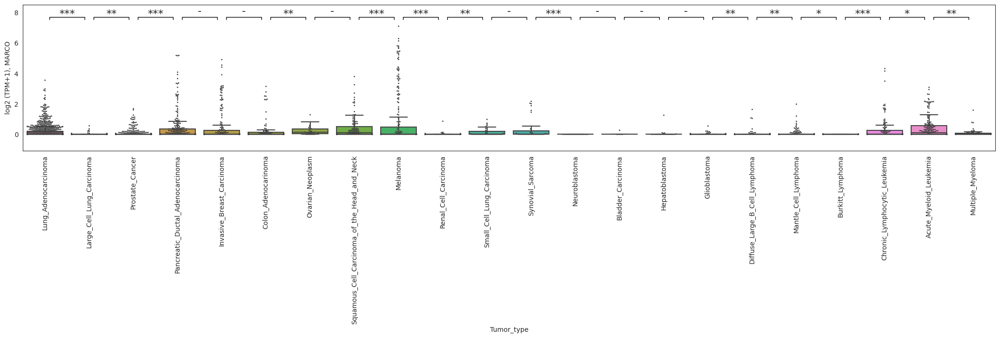

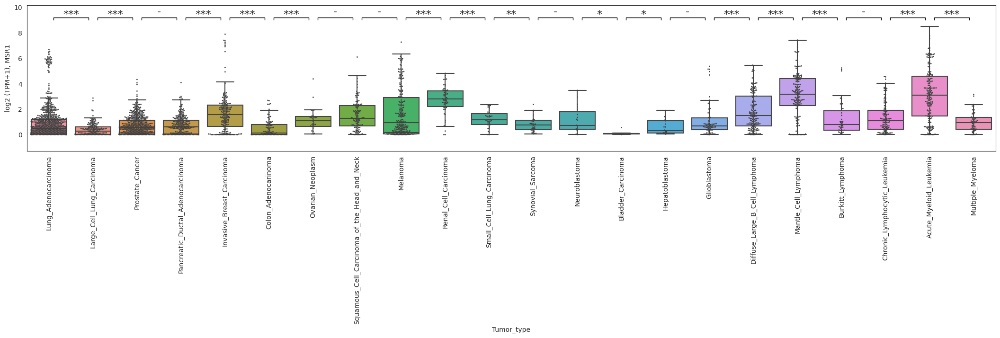

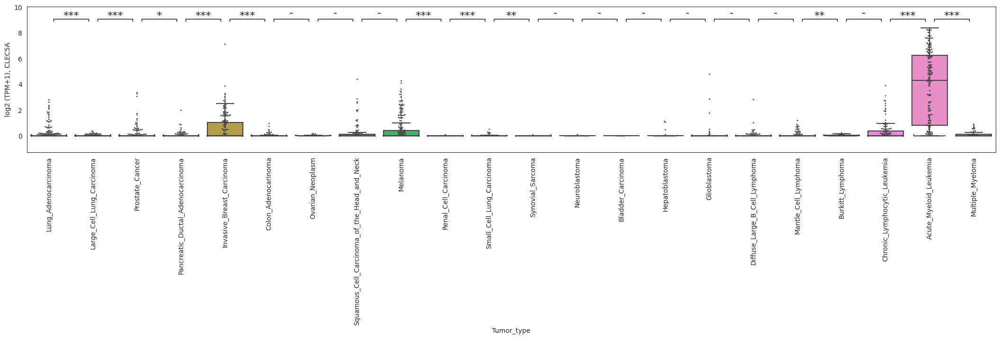

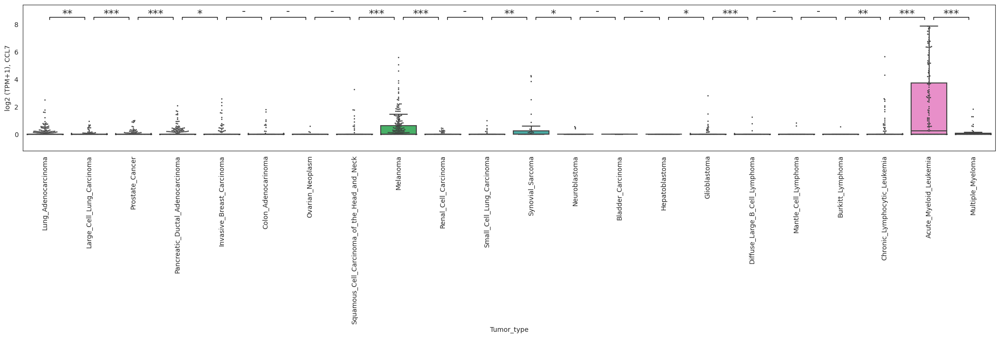

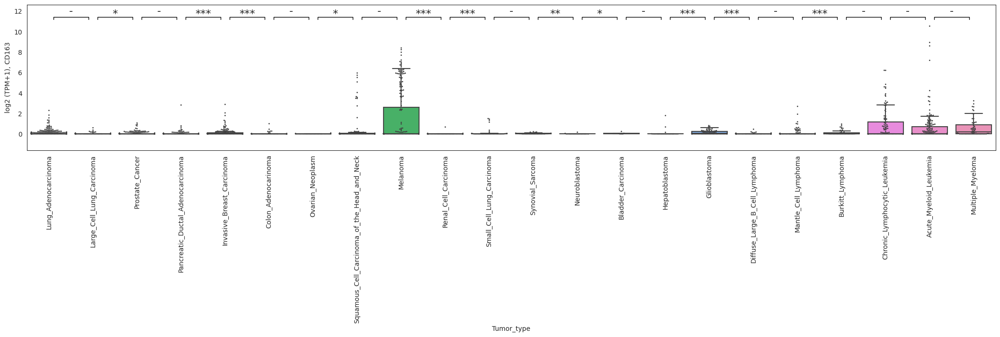

...

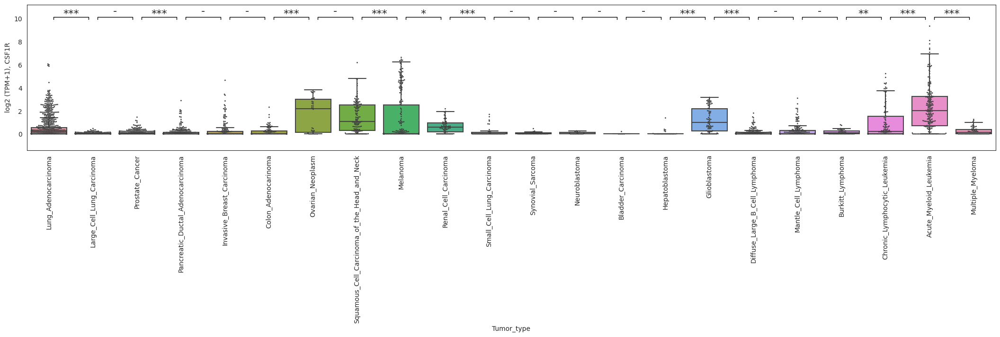

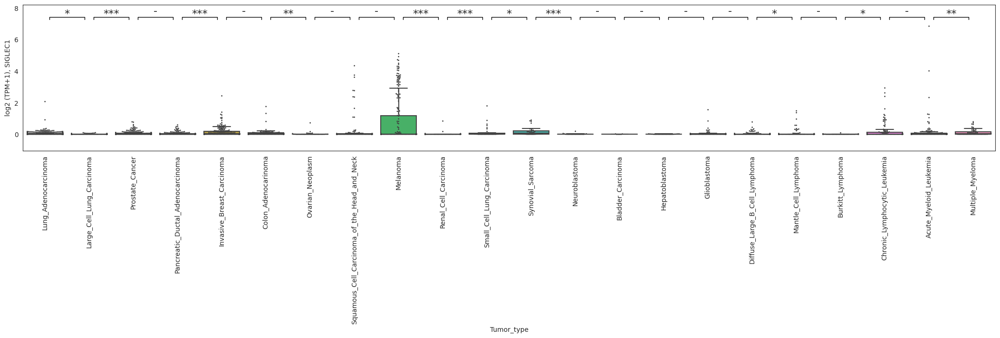

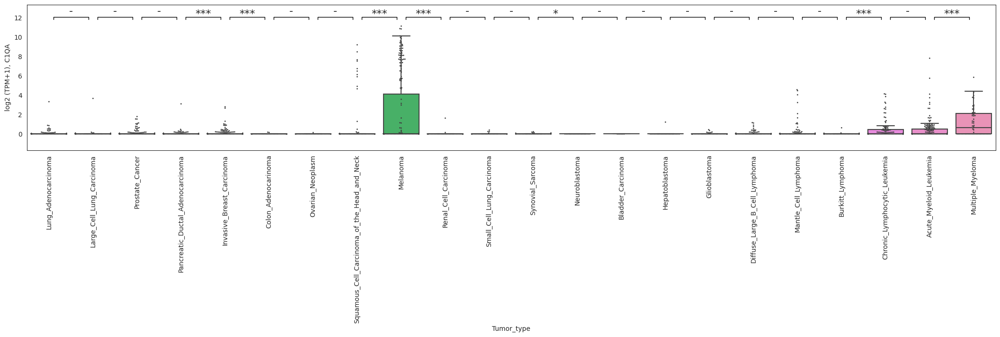

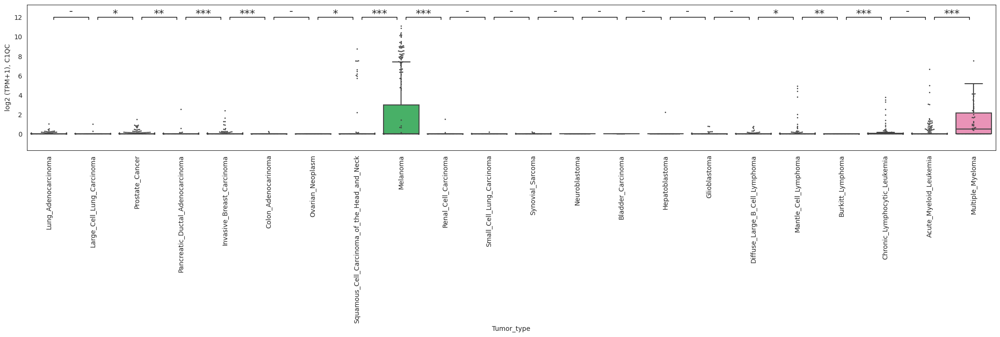

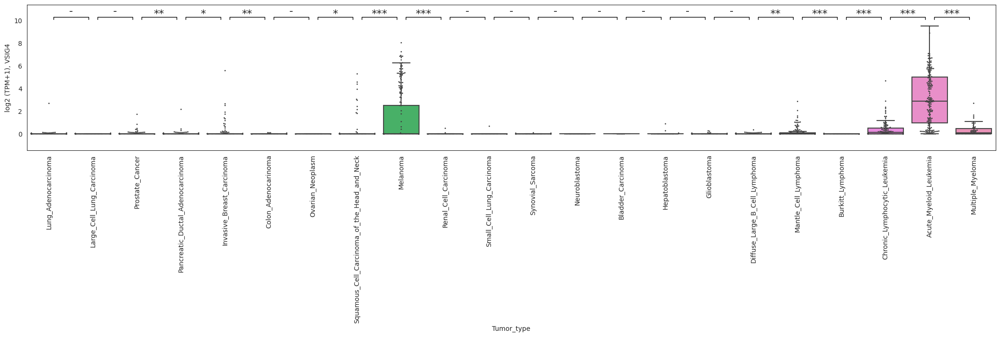

In [126]:
# boxplots depicting signature genes expression in diagnoses of interest

categories = ['Lung_Adenocarcinoma', 'Large_Cell_Lung_Carcinoma', 'Prostate_Cancer', 'Pancreatic_Ductal_Adenocarcinoma', 
              'Invasive_Breast_Carcinoma', 'Colon_Adenocarinoma', 'Ovarian_Neoplasm', 
              'Squamous_Cell_Carcinoma_of_the_Head_and_Neck', 'Melanoma', 'Renal_Cell_Carcinoma', 'Small_Cell_Lung_Carcinoma', 
              'Synovial_Sarcoma',  'Neuroblastoma',
              'Bladder_Carcinoma', 'Hepatoblastoma', 'Glioblastoma',
              'Diffuse_Large_B_Cell_Lymphoma', 'Mantle_Cell_Lymphoma', 'Burkitt_Lymphoma',
              'Chronic_Lymphocytic_Leukemia', 'Acute_Myeloid_Leukemia', 'Multiple_Myeloma'          
]

for gene in signature_of_interest:
    boxplot_with_pvalue(cancer_cells_expr.loc[gene], annot[annot['Tumor_type'].isin(categories)]['Tumor_type'], order=categories, s=2,
                       )
    plt.ylabel(f'log2 (TPM+1), {gene}')
    plt.xticks(rotation=90)
    plt.show()

In [127]:
cancer_cells_ssgsea_unscaled = ssgsea_formula(cancer_cells_expr, gmt_genes_alt_names(geneset_of_interest, cancer_cells_expr.index, verbose=False)).T

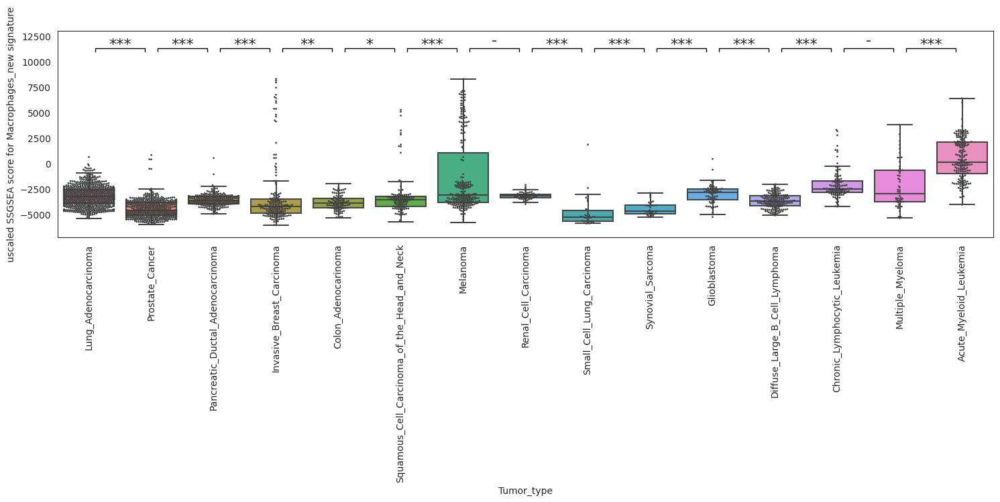

In [128]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ['Lung_Adenocarcinoma', 'Prostate_Cancer', 'Pancreatic_Ductal_Adenocarcinoma', #'Large_Cell_Lung_Carcinoma', 
              'Invasive_Breast_Carcinoma', 'Colon_Adenocarinoma', #'Ovarian_Neoplasm', 'Bladder_Carcinoma',
              'Squamous_Cell_Carcinoma_of_the_Head_and_Neck', 'Melanoma', 'Renal_Cell_Carcinoma',  'Small_Cell_Lung_Carcinoma', 
              'Synovial_Sarcoma', 'Glioblastoma',# 'Neuroblastoma', 'Hepatoblastoma', 
              'Diffuse_Large_B_Cell_Lymphoma', #'Mantle_Cell_Lymphoma', 'Burkitt_Lymphoma',
              'Chronic_Lymphocytic_Leukemia', 'Multiple_Myeloma', 'Acute_Myeloid_Leukemia'           
]

boxplot_with_pvalue(cancer_cells_ssgsea_unscaled[signature_name], annot[annot['Tumor_type'].isin(categories)]['Tumor_type'], 
                   order = categories, s=2, y_min=-5000, y_max=10000)

plt.xticks(rotation=90)
plt.ylabel(f'uscaled SSGSEA score for {signature_name} signature')
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_tuned_cancer_cell_lines.svg", format="svg")

plt.show()

## gene examples

Suppl figure 2D

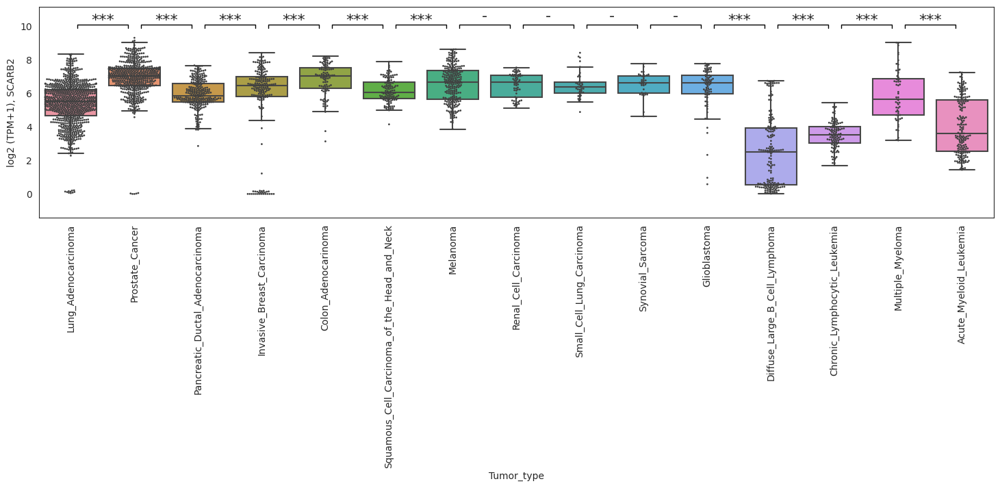

In [129]:
categories = ['Lung_Adenocarcinoma', 'Prostate_Cancer', 'Pancreatic_Ductal_Adenocarcinoma', #'Large_Cell_Lung_Carcinoma', 
              'Invasive_Breast_Carcinoma', 'Colon_Adenocarinoma', #'Ovarian_Neoplasm', 'Bladder_Carcinoma',
              'Squamous_Cell_Carcinoma_of_the_Head_and_Neck', 'Melanoma', 'Renal_Cell_Carcinoma',  'Small_Cell_Lung_Carcinoma', 
              'Synovial_Sarcoma', 'Glioblastoma',# 'Neuroblastoma', 'Hepatoblastoma', 
              'Diffuse_Large_B_Cell_Lymphoma', #'Mantle_Cell_Lymphoma', 'Burkitt_Lymphoma',
              'Chronic_Lymphocytic_Leukemia', 'Multiple_Myeloma', 'Acute_Myeloid_Leukemia'           
]
gene = 'SCARB2'
boxplot_with_pvalue(cancer_cells_expr.loc[gene], annot[annot['Tumor_type'].isin(categories)]['Tumor_type'], order=categories, s=2)
plt.ylabel(f'log2 (TPM+1), {gene}')
plt.xticks(rotation=90)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_bad_gene_SCARB2_cancer_cell_lines.svg", format="svg")

plt.show()

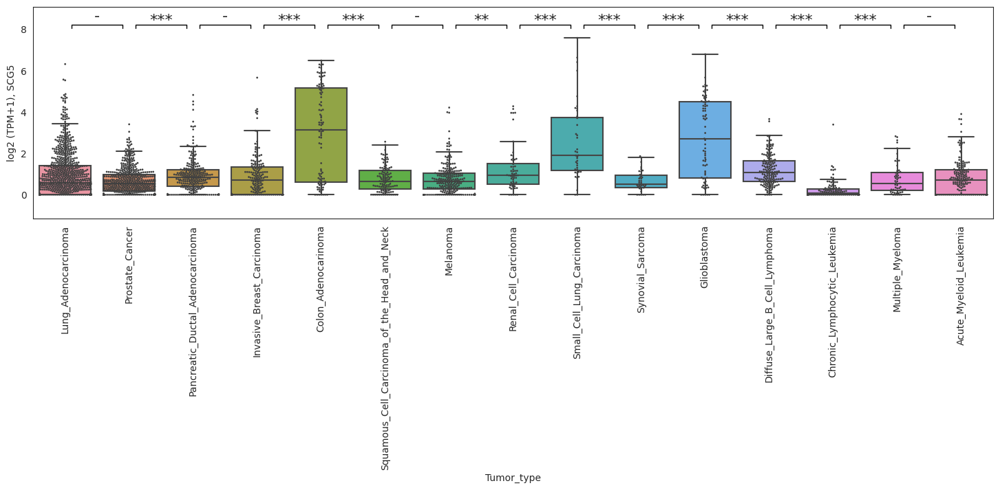

In [130]:
categories = ['Lung_Adenocarcinoma', 'Prostate_Cancer', 'Pancreatic_Ductal_Adenocarcinoma', #'Large_Cell_Lung_Carcinoma', 
              'Invasive_Breast_Carcinoma', 'Colon_Adenocarinoma', #'Ovarian_Neoplasm', 'Bladder_Carcinoma',
              'Squamous_Cell_Carcinoma_of_the_Head_and_Neck', 'Melanoma', 'Renal_Cell_Carcinoma',  'Small_Cell_Lung_Carcinoma', 
              'Synovial_Sarcoma', 'Glioblastoma',# 'Neuroblastoma', 'Hepatoblastoma', 
              'Diffuse_Large_B_Cell_Lymphoma', #'Mantle_Cell_Lymphoma', 'Burkitt_Lymphoma',
              'Chronic_Lymphocytic_Leukemia', 'Multiple_Myeloma', 'Acute_Myeloid_Leukemia'           
]
gene = 'SCG5'
boxplot_with_pvalue(cancer_cells_expr.loc[gene], annot[annot['Tumor_type'].isin(categories)]['Tumor_type'], order=categories, s=2)
plt.ylabel(f'log2 (TPM+1), {gene}')
plt.xticks(rotation=90)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_bad_gene_SCG5_cancer_cell_lines.svg", format="svg")

plt.show()

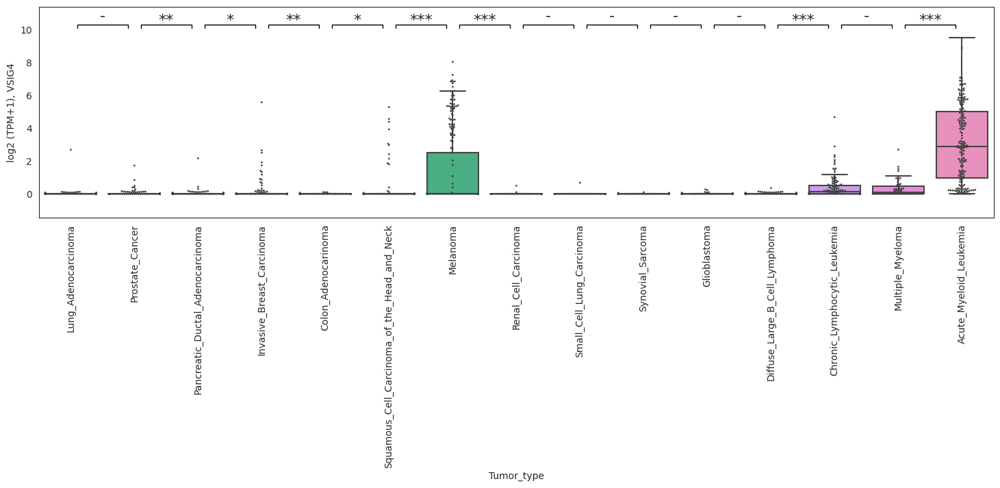

In [131]:
categories = ['Lung_Adenocarcinoma', 'Prostate_Cancer', 'Pancreatic_Ductal_Adenocarcinoma', #'Large_Cell_Lung_Carcinoma', 
              'Invasive_Breast_Carcinoma', 'Colon_Adenocarinoma', #'Ovarian_Neoplasm', 'Bladder_Carcinoma',
              'Squamous_Cell_Carcinoma_of_the_Head_and_Neck', 'Melanoma', 'Renal_Cell_Carcinoma',  'Small_Cell_Lung_Carcinoma', 
              'Synovial_Sarcoma', 'Glioblastoma',# 'Neuroblastoma', 'Hepatoblastoma', 
              'Diffuse_Large_B_Cell_Lymphoma', #'Mantle_Cell_Lymphoma', 'Burkitt_Lymphoma',
              'Chronic_Lymphocytic_Leukemia', 'Multiple_Myeloma', 'Acute_Myeloid_Leukemia'           
]
gene = 'VSIG4'
boxplot_with_pvalue(cancer_cells_expr.loc[gene], annot[annot['Tumor_type'].isin(categories)]['Tumor_type'], order=categories, s=2)
plt.ylabel(f'log2 (TPM+1), {gene}')
plt.xticks(rotation=90)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_good_gene_VSIG4_cancer_cell_lines.svg", format="svg")

plt.show()

# Signature validation: pancan data (TCGA)

### Definition of custom signature (once again, same as above)

In [132]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')

#add here a custon signature name
signature_name = 'Macrophages'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

In [133]:
#list all cohorts with expressions available
os.listdir('/uftp/mvp-data/cohorts/')

['LUAD',
 'Meningioma',
 'KIRC',
 'TCGA-Oligodendroglioma',
 'PAAD',
 'MCL',
 'OV',
 'ALCL',
 'Leiomyosarcoma',
 'AITL',
 'LUSC',
 'TCGA-ESGA_AC',
 'MESO',
 'LIHC',
 'TCGA-COREAD',
 'PanSolid',
 'THCA',
 'TCGA-CESC_SCC',
 'Multiple_Myeloma',
 'SKCM',
 'TGCT',
 'TCGA-Glioblastoma',
 'CHOL',
 'KIRP',
 'AML',
 'Liposarcoma',
 'TCGA-HNE_SCC',
 'TCGA-BRCA_LumiNorm',
 'THYM_without_TC',
 'PTCL-NOS',
 'ACC',
 'Pancreatic_NET',
 'PTCL_LN',
 'TCGA-BRCA_Her2',
 'TCGA-BRCA_Basal',
 'CSCC-polyA',
 'DLBCL-polyA',
 'Esthesioneuroblastoma',
 'PanPTCL_LN',
 'FL',
 'KICH',
 'NKTCL',
 'UCEC',
 'TCGA-Astrocytoma',
 'SARC',
 'PTCL_blood',
 'no_cohort_solid',
 'no_cohort_hematological',
 'TCGA-CESC_AC',
 'PanHeme',
 'PRAD',
 'BLCA',
 'UCS',
 'no_cohort',
 'BG_NEC',
 'PCPG',
 'CTCL',
 'THYM',
 'BG_PanSolid',
 'UVM',
 'AdCC',
 'NPC',
 'FL-HCC',
 'BG_FL-HCC']

In [134]:
#list all cohorts with counts available
os.listdir('/uftp2/Datasets/Xena/TCGA/TCGA_Kallisto_genes_est_counts_without_noncoding/')

['remaining_est_counts_sum',
 'CHOL_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'PAAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'UVM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'THYM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'DLBC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'ACC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'STAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'ESCA_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'CESC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'COAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'MESO_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'KIRP_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'THCA_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'PCPG_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'SKCM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz'

In [135]:
# here, we manually select cohorts having both expressions and counts available
cohorts = [
 'THYM',
 'PRAD',
 'ACC',
 'KIRC',
 'LIHC',
 'BLCA',
 'LUAD',
 'KICH',
 'SARC',
 'KIRP',
 'LUSC',
 'THCA',
 'PCPG',
 'OV',
 'PAAD',
 'UVM',
 'SKCM',
 'UCS',
 'UCEC',
 'MESO',
    'TCGA-BRCA_Her2',
    'TCGA-BRCA_Basal',
    'TCGA-BRCA_LumiNorm',
    'TCGA-COREAD',
]

## expressions

In [137]:
tcga_expressions = {}
tcga_ssgsea ={}
tcga_ssgsea_unscaled = {}
tcga_counts = {}

for cohort in cohorts:
    e = get_expression_table(cohort, log=True).T
    s = ssgsea_formula(e, gmt_genes_alt_names(geneset_of_interest, e.index, verbose=False)).T
    tcga_expressions[cohort] = e
    tcga_ssgsea_unscaled[cohort] = s
    tcga_ssgsea[cohort] = median_scale(s)

#    tcga_counts[cohort] = read_dataset(f'/uftp2/Datasets/Xena/TCGA/TCGA_Kallisto_genes_est_counts_without_noncoding/{cohort}_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz')

In [138]:
tcga_anno = read_dataset('/uftp2/Datasets/TCGA/current_version/data/annotation.tsv')
tcga_expressions = pd.concat(tcga_expressions.values(), axis=1)
tcga_ssgsea = pd.concat(tcga_ssgsea.values())
tcga_ssgsea_unscaled = pd.concat(tcga_ssgsea_unscaled.values())
#tcga_counts = pd.concat(tcga_counts.values(), axis=1)


In [139]:
from mldeconv.prediction import choose_predict_params_for_diagnosis
from mldeconv.prediction import predict

In [140]:
with open('/uftp/Deconvolution/product/models/configs/product/model_v1_tumor.yaml', "r") as f:
    pred_config = yaml.load(f, Loader=yaml.FullLoader)
tcga_deconv = predict(2**(tcga_expressions)-1, pred_config)

2024-06-06 15:50:56.422 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function load took 2.8185 seconds.
2024-06-06 15:51:07.043 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function predict_l1 took 9.5527 seconds.
2024-06-06 15:51:07.046 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function predict took 10.6220 seconds.


### Check if all genes in signatures are expressed (in progress!)

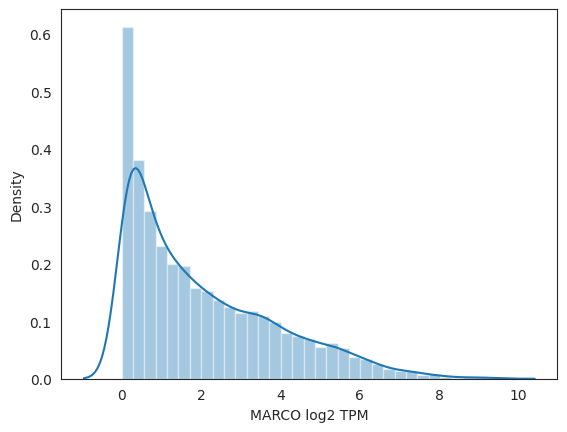

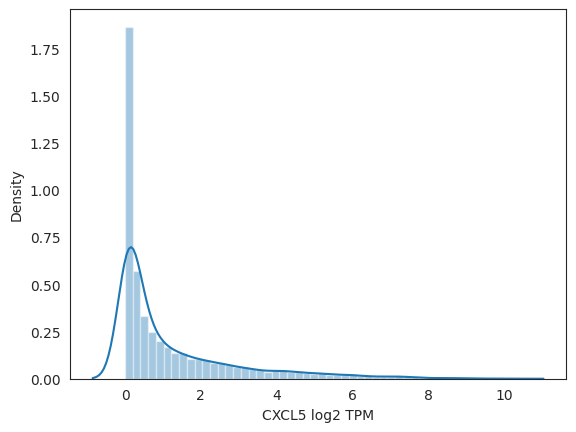

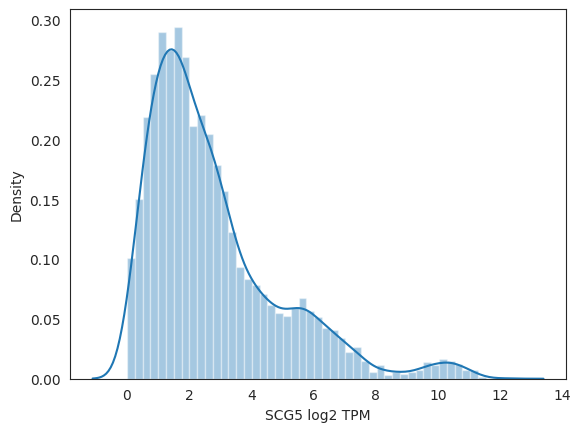

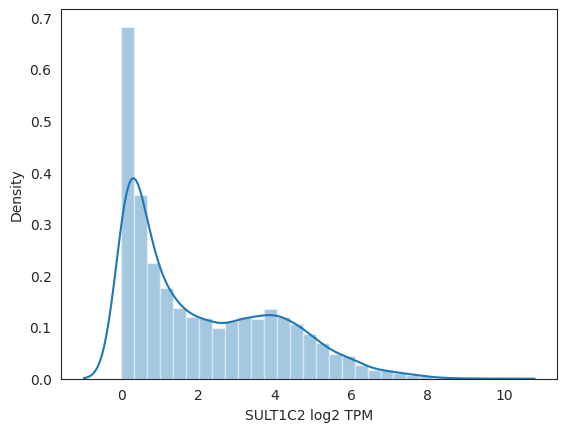

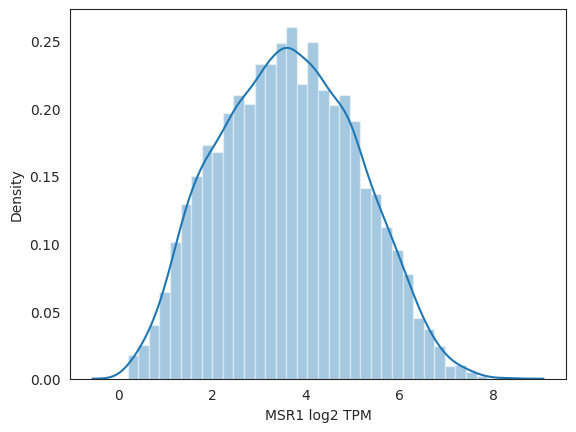

...

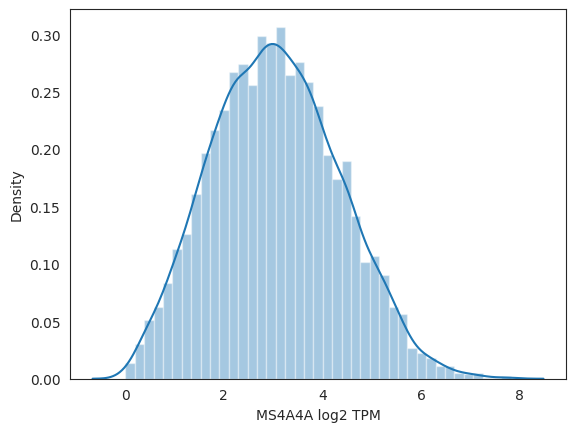

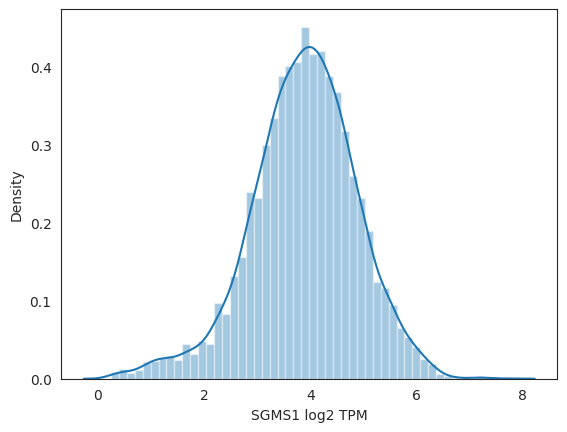

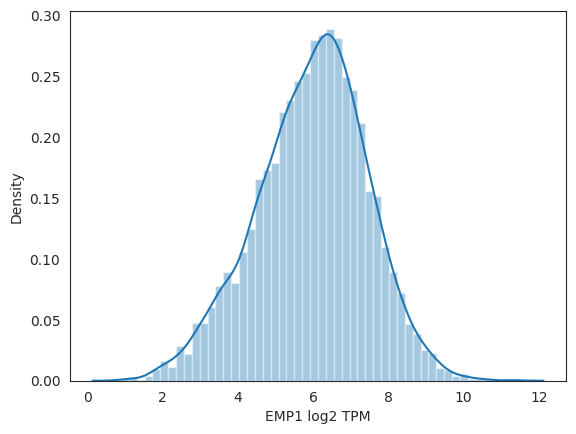

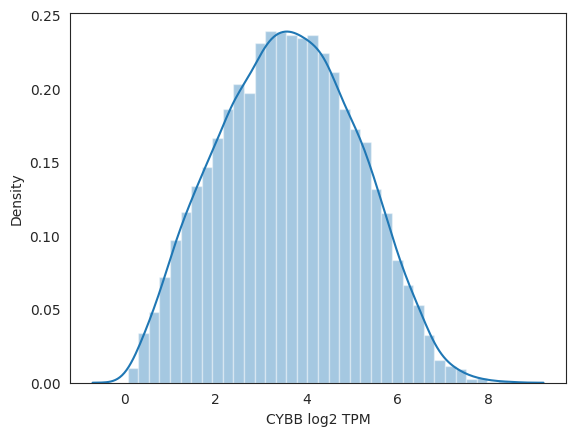

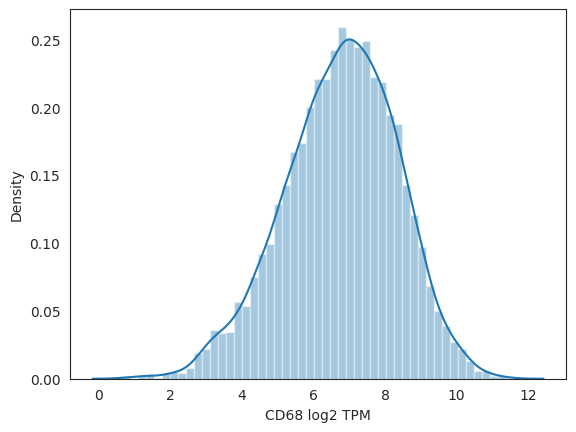

In [142]:
for gene in signature_of_interest:
    sns.distplot(tcga_expressions.loc[gene])
    plt.xlabel(f'{gene} log2 TPM')
    plt.show()

Figure 4A

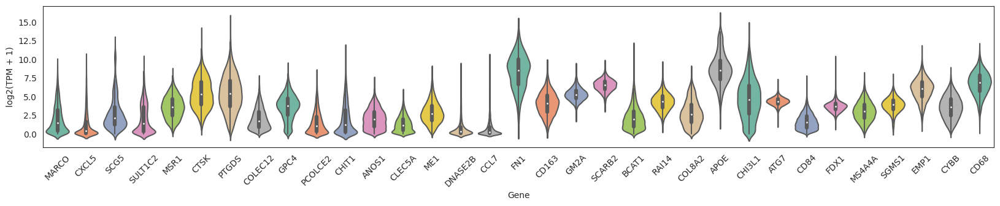

In [143]:
df = tcga_expressions.loc[signature_of_interest]
data = pd.melt(df.T)
data['KDE'] = 'Gene'

plt.figure(figsize = (20, 3))
sns.violinplot(
    x='Gene',
    y='value',
    data=pd.concat([data]),
    palette="Set2",
    split=True,
    scale="count",
    inner='box')

plt.ylabel('log2(TPM + 1)')
plt.xticks(rotation=45)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_original_tcga_expressions_violin.svg", format="svg")

plt.show()

### Check if there are anticorrelating genes

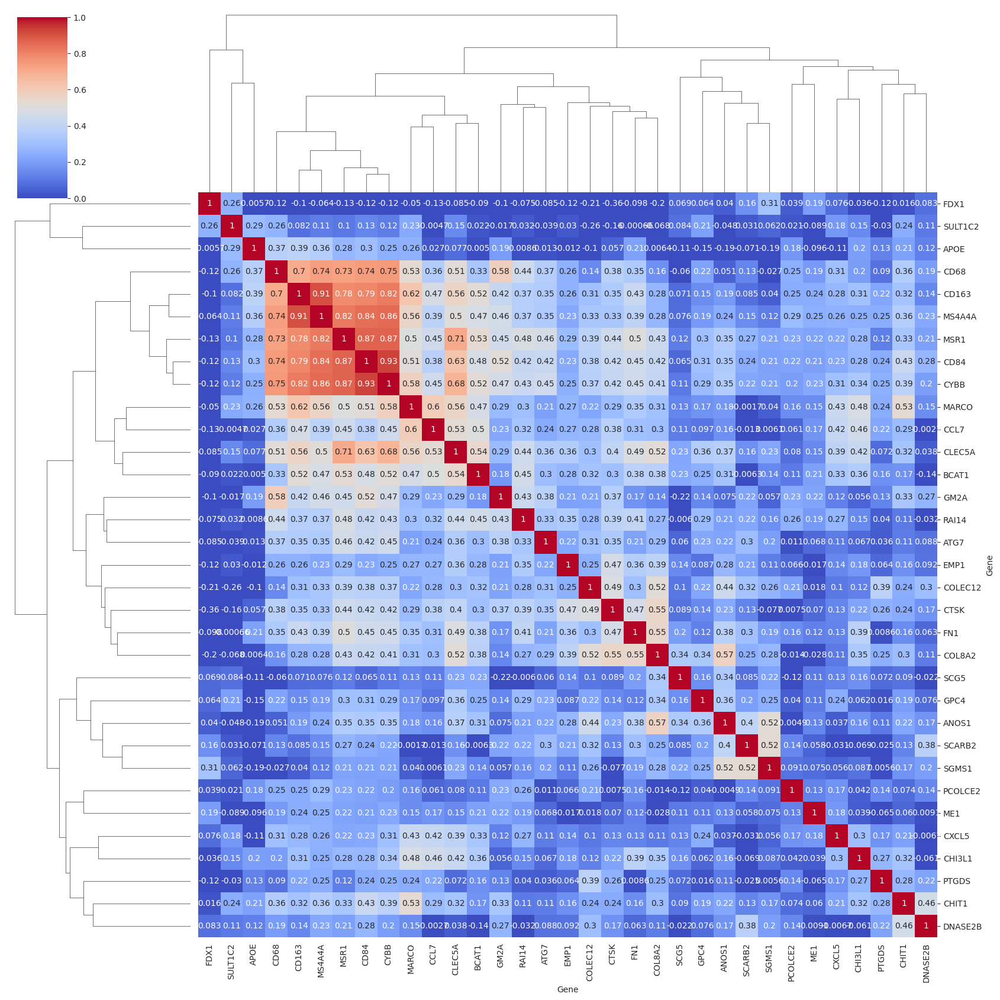

In [146]:
sns.clustermap(tcga_expressions.T[signature_of_interest].corr(method='spearman'), cmap=default_cmap, annot=True, figsize=(17, 17),
        annot_kws={"fontsize":10},
           vmin=0, vmax=1)
plt.show()

### Check if this signature overlaps/correlates with existing signatures from Chess DB

#### Load signatures from CHESS DB, uftp data

In [149]:
paths = sorted(Path('/uftp/shared/signature_database/chess_gmt_vers/').iterdir(), key=os.path.getmtime)
paths

[PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_validated_2022-11-11.09:08.tsv'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_cytokines_2022-11-23.01:36.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_validated_2022-11-23.01:36.tsv'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_portrait_blood_2022-11-23.01:36.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_portrait_solid_2022-11-23.01:36.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_portrait_blood_2023-01-19.04:37.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_portrait_solid_2023-01-19.04:37.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_cytokines_2023-01-19.04:37.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_validated_2023-01-19.04:37.tsv'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_cytokines_2023-03-14

In [154]:
gmt = read_dataset('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_validated_2023-11-29.08:41.tsv')
gmt.index = gmt['Main4_ID']
gmt = {j.name:GeneSet(j.name, '', set(j.dropna().values)) for i, j in gmt.iterrows()}

#### Correlations

In [155]:
print('Checking for overlaps with CHESS signatures...')
for sig_name, sig in gmt.items():
    if len(sig.genes) > 0:
        common_genes = set(signature_of_interest).intersection(set(sig.genes))
        if len(common_genes)/len(signature_of_interest) > .75 or len(common_genes)/len(sig.genes) > .75:
            print(f'Your signature looks alike to {sig_name}:')
            
print('Done')

Checking for overlaps with CHESS signatures...
Done


In [156]:
print('Checking for correlation with CHESS signatures...')
solid_pancan = ssgsea_formula(tcga_expressions, gmt_genes_alt_names(gmt, tcga_expressions.index, 
                                                                    verbose=False)).T
solid_pancan.corrwith(tcga_ssgsea_unscaled[signature_name]).sort_values().dropna().tail(20)

Checking for correlation with CHESS signatures...


Main4_Suppressive_factors_SOLID              0.702194
Main4_Myeloid_cells_recruitment_DLBCL        0.702832
Main4_Myeloid_checkpoints_Blood              0.708928
Main4_Myeloid_checkpoints                    0.708928
Main4_Suppressive_factors_DLBCL              0.714768
Main4_Cancer-promoting_inflammation_DLBCL    0.718785
Main4_Lymphoma_dissemination_LN              0.726686
Main4_Protumor_cytokines_MCL                 0.736164
Main4_Protumor_cytokines_FL                  0.736164
Main4_TAMM                                   0.737699
Main4_Monocytes                              0.749138
Main4_MDSC                                   0.763295
Main4_Microglia                              0.773452
Main4_Phagocytosis_inhibition                0.775763
Main4_Macrophage_DC_traffic_Blood            0.800832
Main4_Macrophage_DC_traffic                  0.800832
Main4_Mph_DC_recruitment_SOLID               0.800832
Main4_Pan_macrophage_signature               0.815390
Main4_M2_signature          

### Survival

In [157]:
survival = prepare_survival_annotation(tcga_anno.OS, tcga_anno.OS_FLAG)

ACC


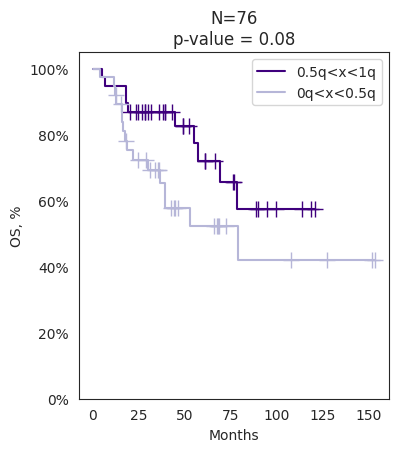

BLCA


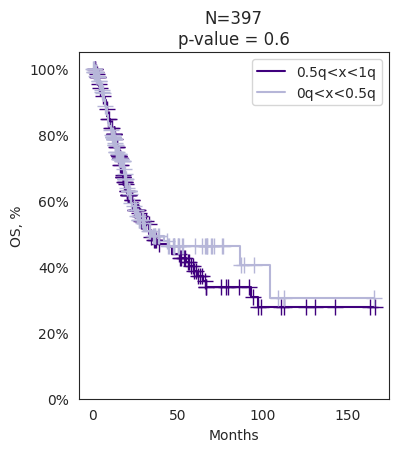

BRCA


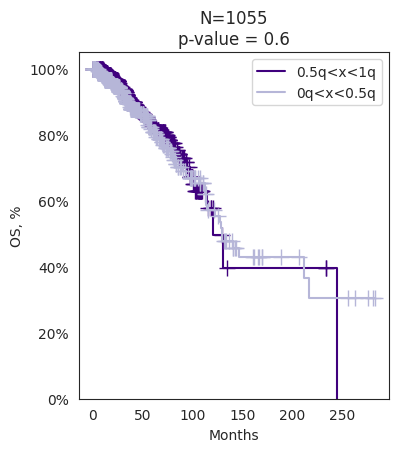

CESC


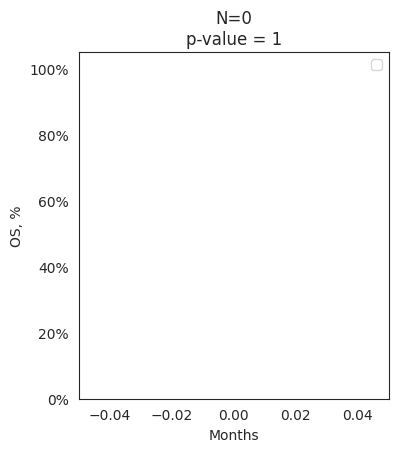

CHOL


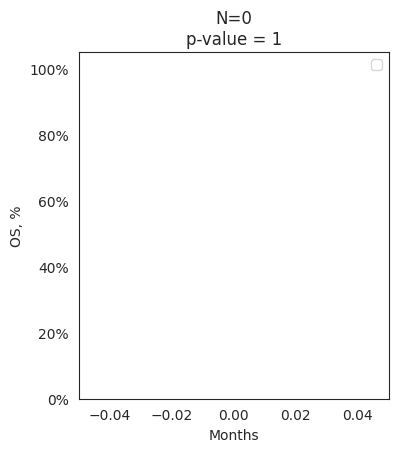

COAD


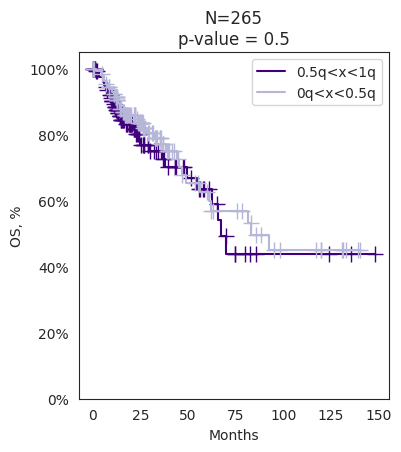

DLBC


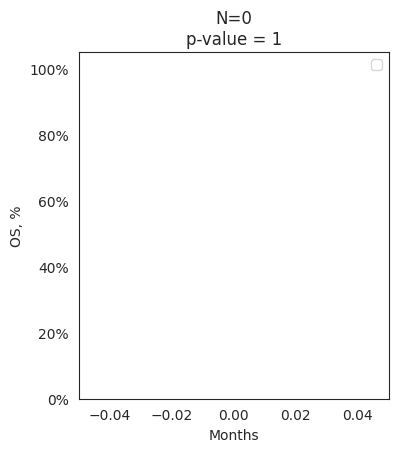

ESCA


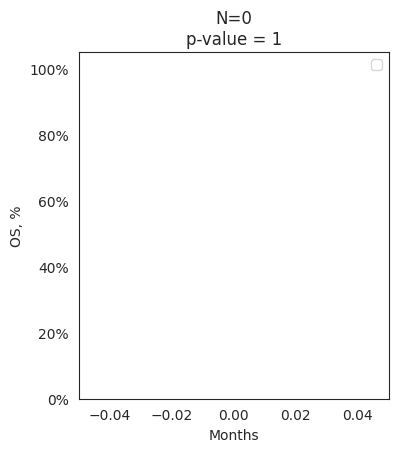

GBM


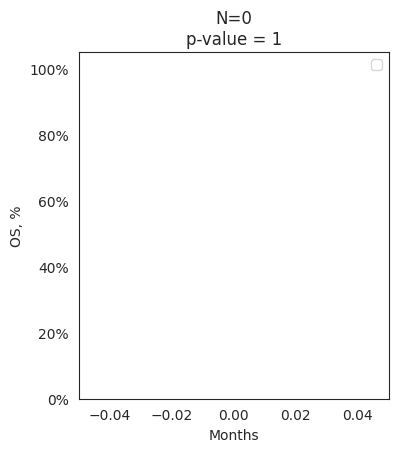

HNSC


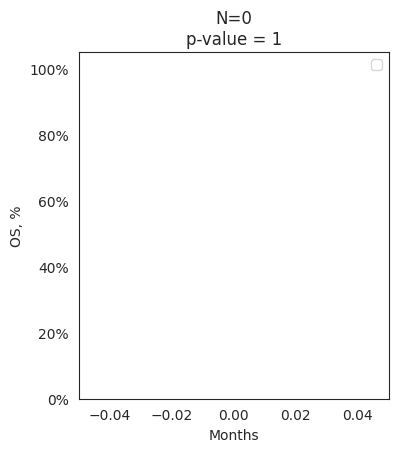

KICH


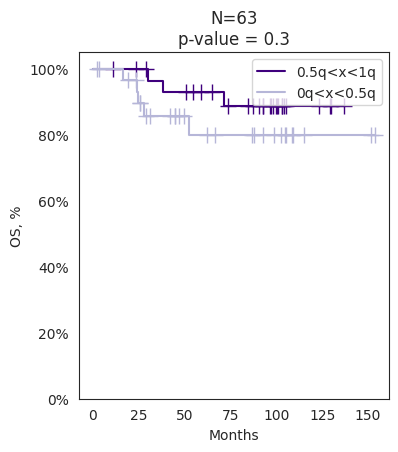

KIRC


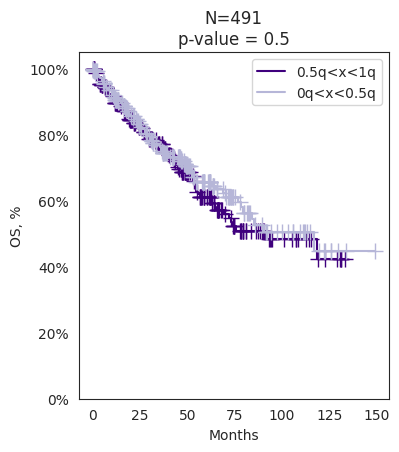

KIRP


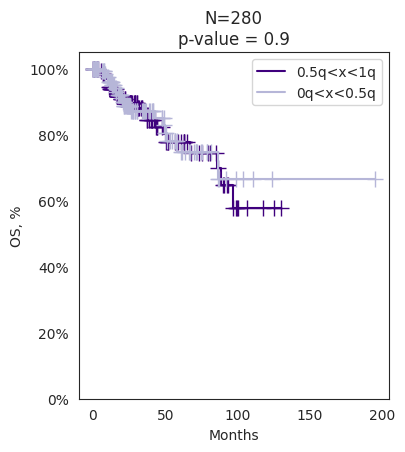

LAML


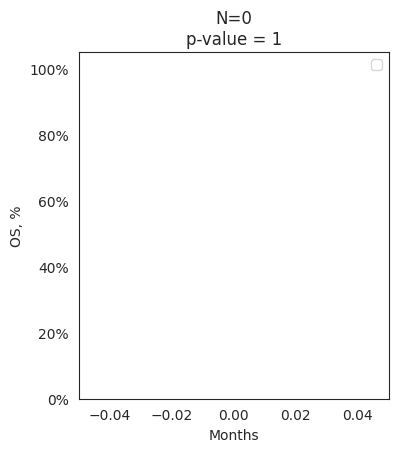

LGG


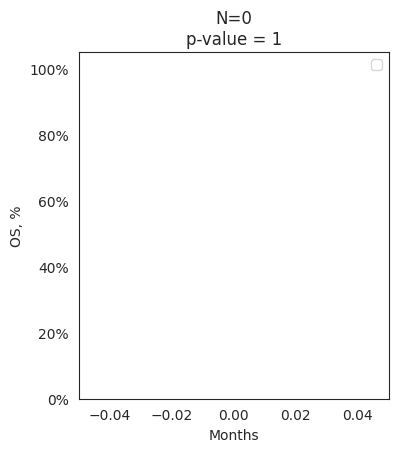

LIHC


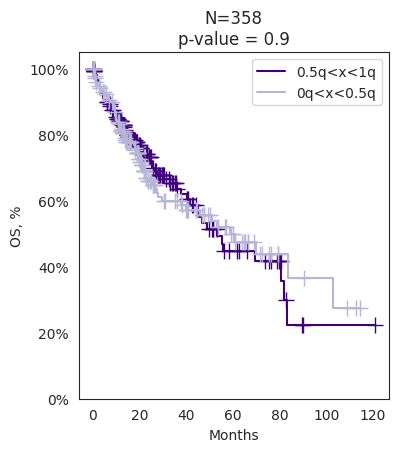

LUAD


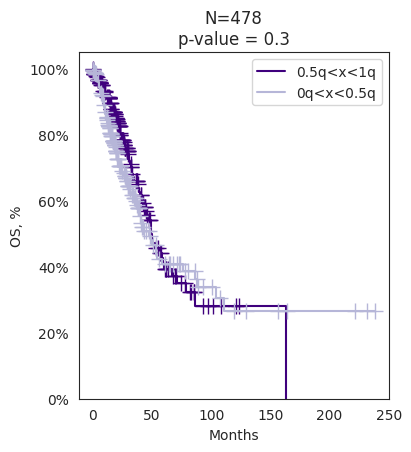

LUSC


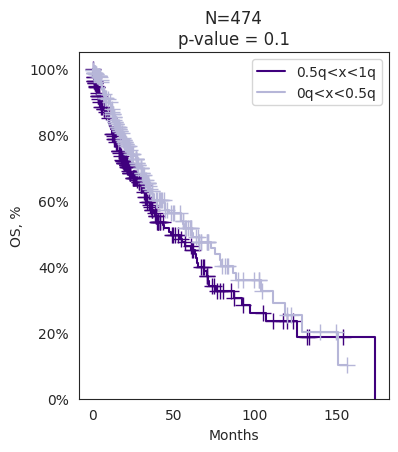

MESO


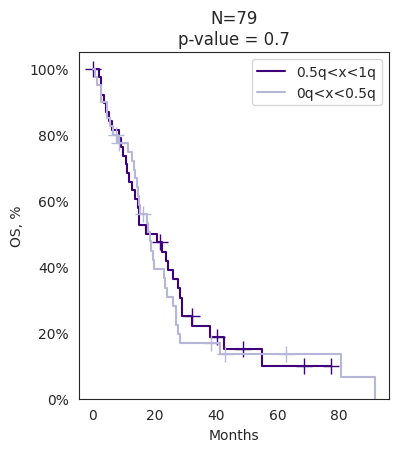

OV


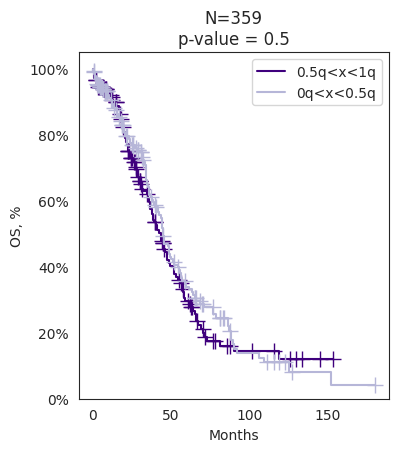

PAAD


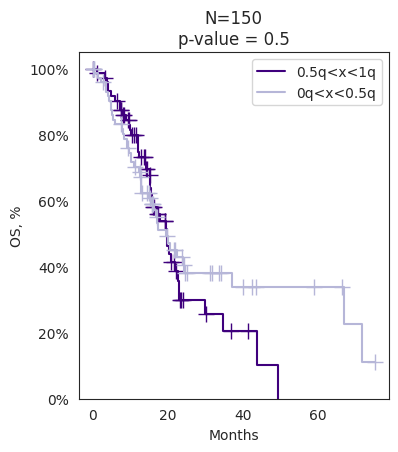

PCPG


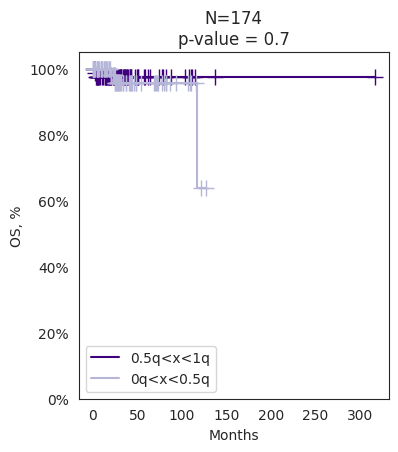

PRAD


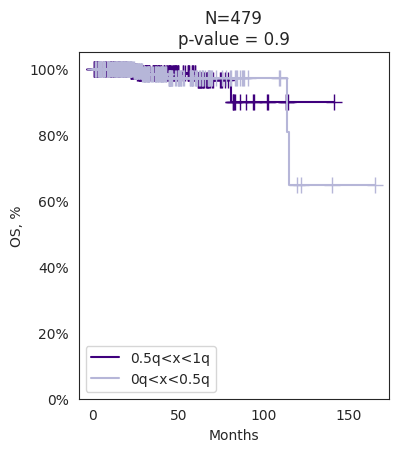

READ


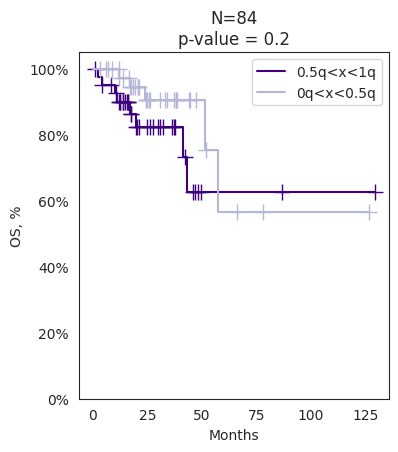

SARC


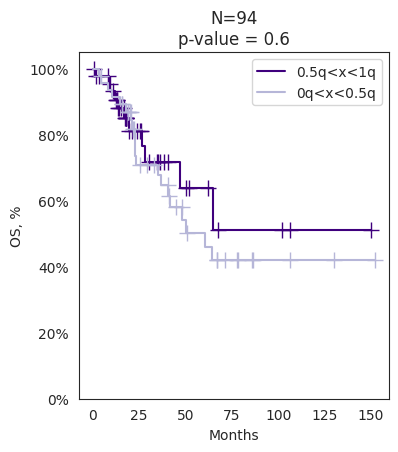

SKCM


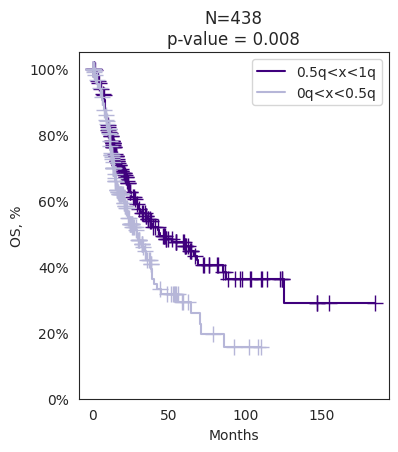

STAD


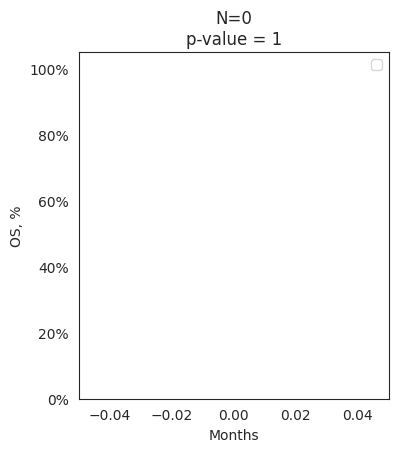

TGCT


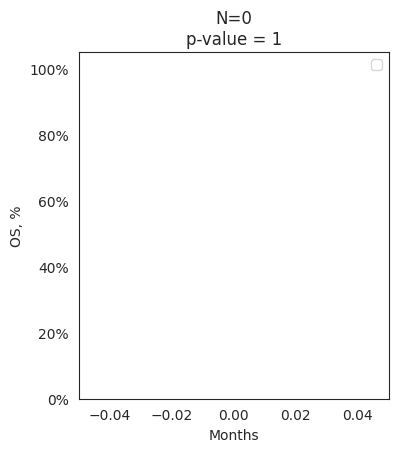

THCA


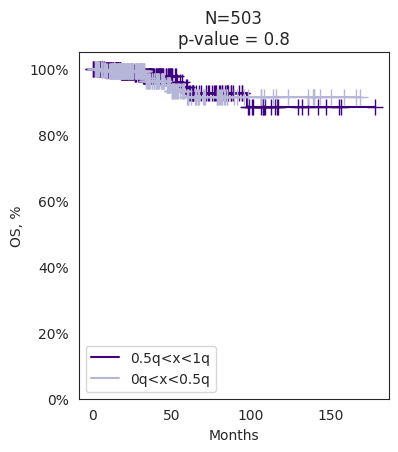

THYM


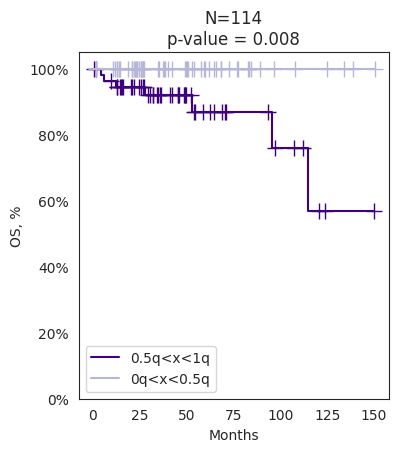

UCEC


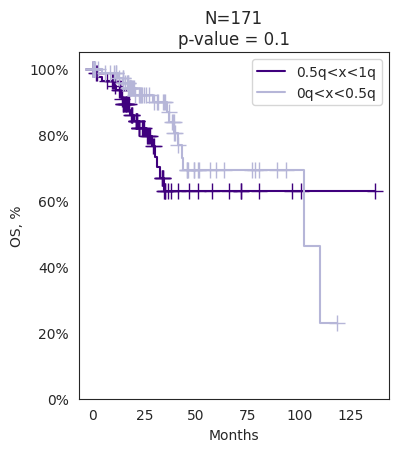

UCS


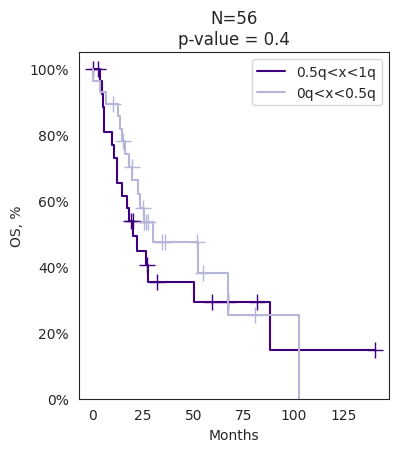

UVM


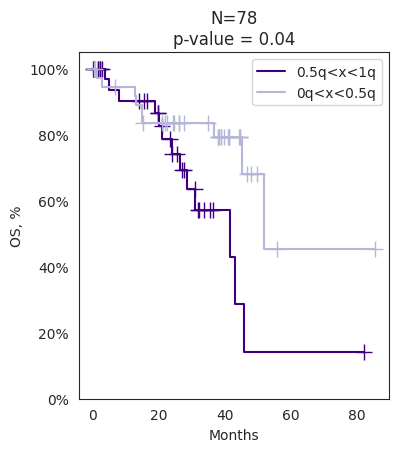

In [158]:
for diagnosis in tcga_anno.acronym.unique():
    print(diagnosis)
    kaplan_meier_quantiles(tcga_ssgsea[signature_name].reindex(tcga_anno[tcga_anno.acronym==diagnosis].index), survival)
    plt.show()

### Correlation with any celltype from deconvolution

In [159]:
#list all available celltypes from deconvolution
tcga_deconv.index.tolist()

['B_cells',
 'CD4_T_cells',
 'CD8_T_cells',
 'CD8_T_cells_PD1_high',
 'CD8_T_cells_PD1_low',
 'Central_memory_T_helpers',
 'Class_switched_memory_B_cells',
 'Conventional_T_cells',
 'Cytotoxic_NK_cells',
 'Effector_memory_T_helpers',
 'Endothelium',
 'Fibroblasts',
 'Macrophages',
 'Macrophages_M1',
 'Macrophages_M2',
 'Mature_B_cells',
 'Memory_CD8_T_cells',
 'NK_cells',
 'Naive_B_cells',
 'Naive_CD8_T_cells',
 'Naive_T_helpers',
 'Neutrophils',
 'Non_switched_memory_B_cells',
 'Regulatory_NK_cells',
 'Secreting_B_cells',
 'T_cells',
 'Th17_cells',
 'Th1_cells',
 'Th2_cells',
 'Transitional_memory_T_helpers',
 'Tregs',
 'Other',
 'Lymphoid_cells',
 'Myeloid_cells',
 'Naive_T_cells',
 'Stromal_cells',
 'Memory_T_cells',
 'Tumor']

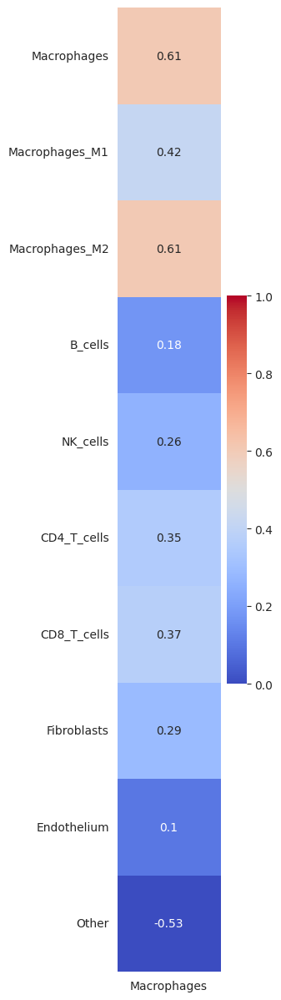

In [164]:
signatures = geneset_of_interest
cell_types = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'B_cells', 'NK_cells', 'CD4_T_cells', 'CD8_T_cells', 'Fibroblasts', 'Endothelium', 'Other'] #'Monocytes', 'CDC', 'PDC', 'Granulocytes', 
corr_scores = []
for name, genes in signatures.items(): 
    ssgsea_scores = tcga_ssgsea
    corr = tcga_deconv.T[cell_types].corrwith(ssgsea_scores[name], axis='index', method='spearman')
    corr.name = name
    corr_scores.append(corr)
corr_scores = pd.concat(corr_scores, axis=1)
f, ax = plt.subplots(figsize=(len(signatures)*2, len(cell_types)*1.5))
sns.heatmap(corr_scores, 
            cbar=True, 
            cmap='coolwarm', 
            xticklabels=True, 
            annot=True,
            vmin=0, 
            vmax=1,
            ax=ax)
plt.show()

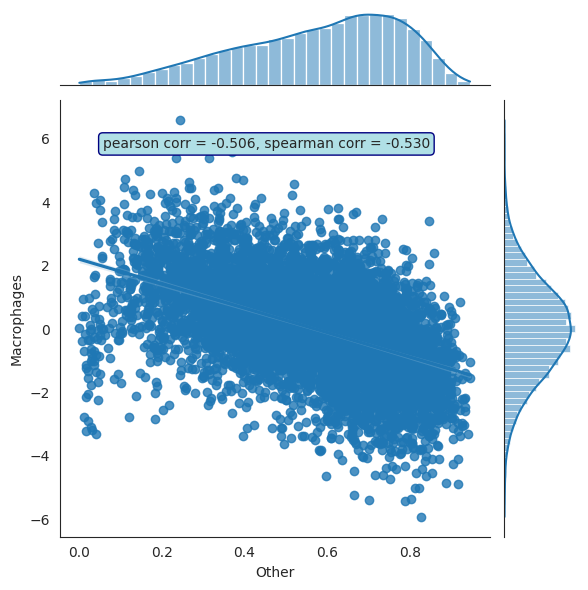

In [165]:
celltype_from_deconv = 'Other'

g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind='reg')
r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
    
g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                xy=(0.1, 0.9), xycoords='axes fraction',
                ha='left', va='center',
                bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})

plt.show()

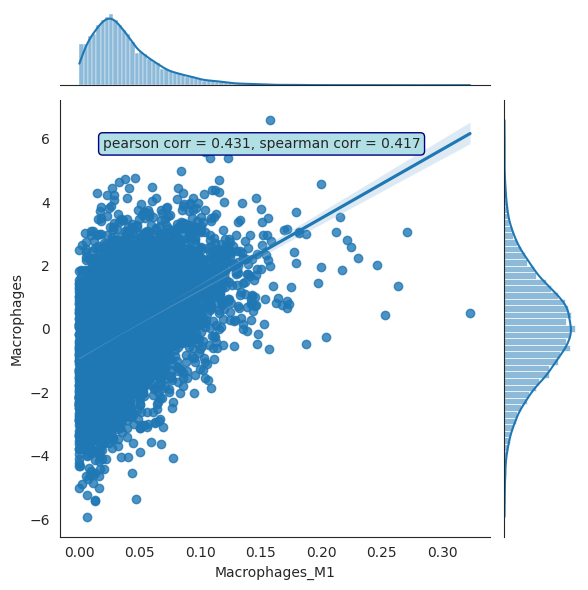

In [166]:
celltype_from_deconv = 'Macrophages_M1'

g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind='reg')
r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
    
g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                xy=(0.1, 0.9), xycoords='axes fraction',
                ha='left', va='center',
                bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})

plt.show()

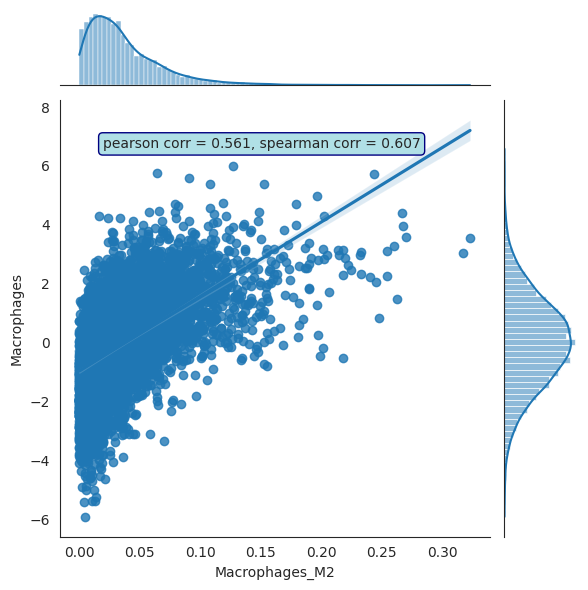

In [167]:
celltype_from_deconv = 'Macrophages_M2'

g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind='reg')
r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
    
g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                xy=(0.1, 0.9), xycoords='axes fraction',
                ha='left', va='center',
                bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})

plt.show()

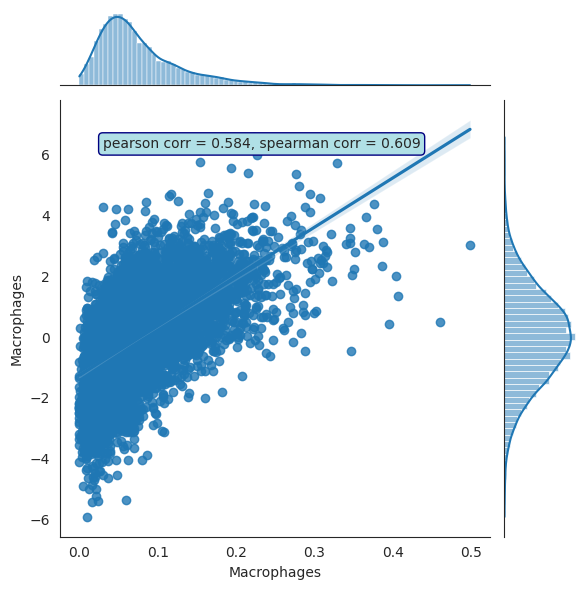

In [168]:
celltype_from_deconv = 'Macrophages'

g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind='reg')
r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
    
g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                xy=(0.1, 0.9), xycoords='axes fraction',
                ha='left', va='center',
                bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})

plt.show()

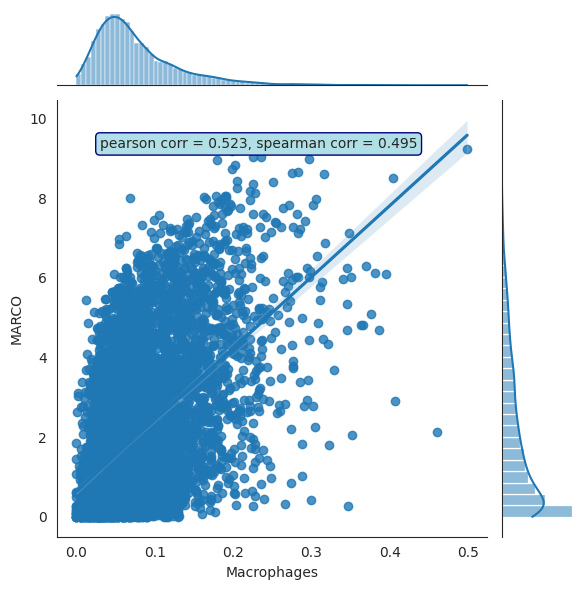

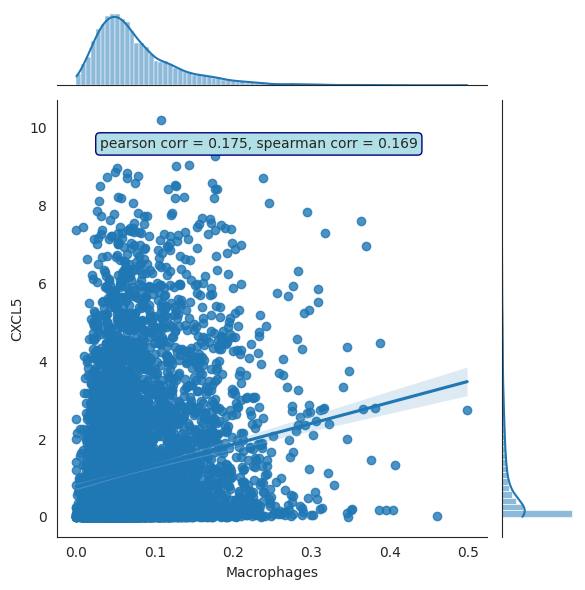

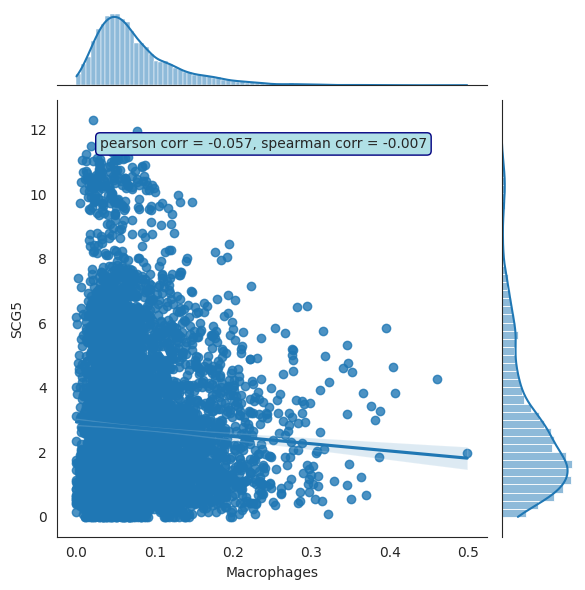

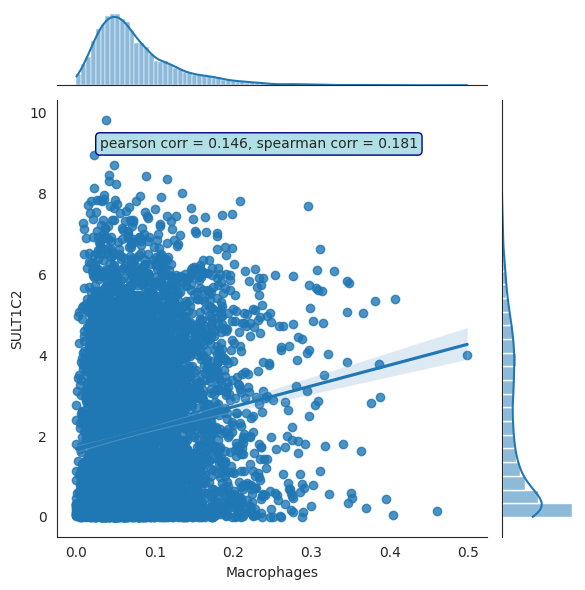

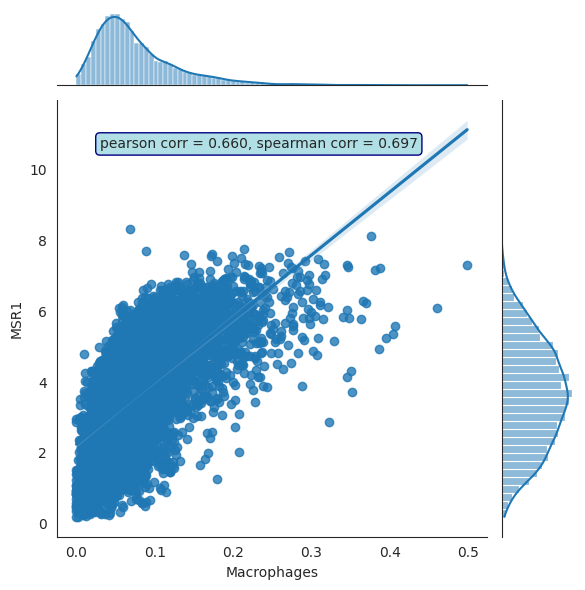

...

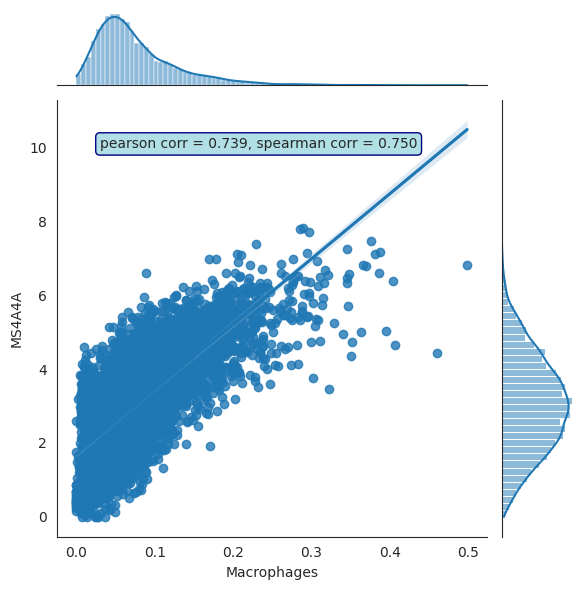

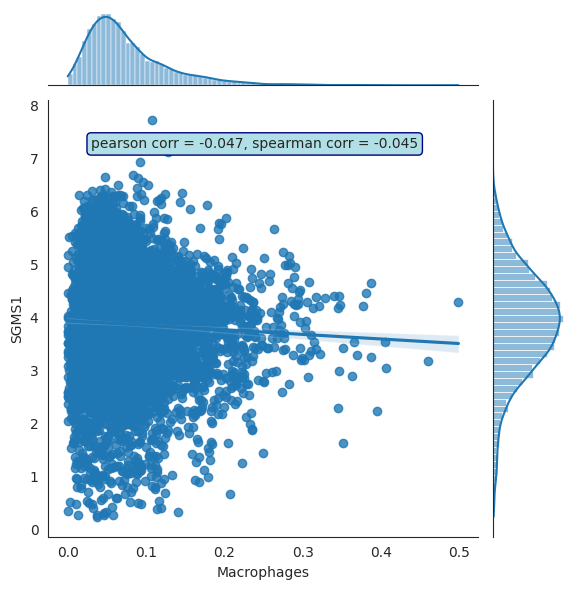

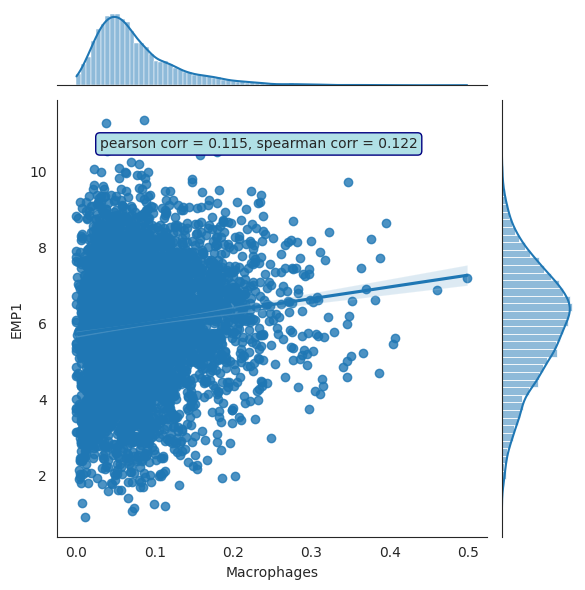

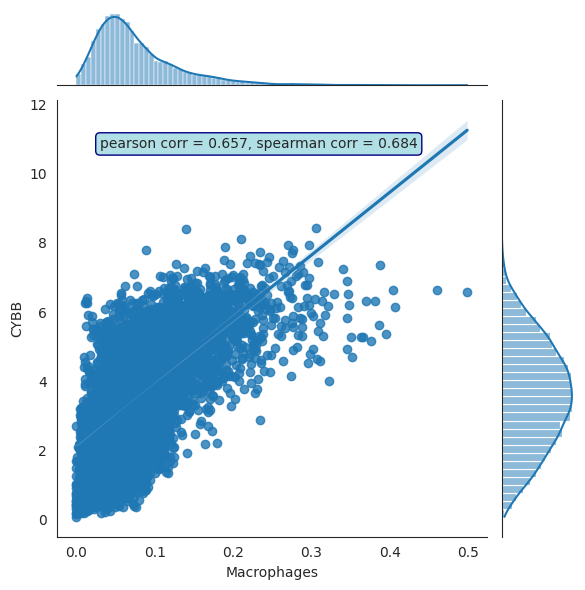

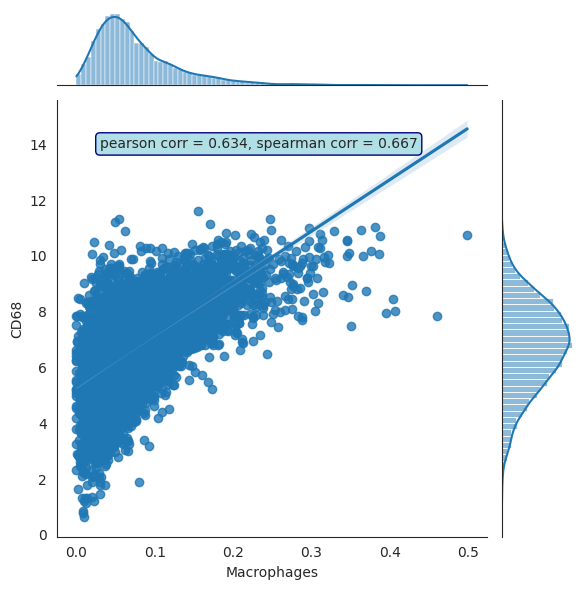

In [169]:
# comparison with deconvolution for every gene (log2 (TPM+1)) in your signature of interest
for gene in signature_of_interest:
    g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene], kind='reg')
    
    r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene])
    rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene])
    
    g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                    xy=(0.1, 0.9), xycoords='axes fraction',
                    ha='left', va='center',
                    bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})
    plt.show()

## Tuned signature validation

In [170]:
signature_of_interest = '''MARCO	CXCL5	SCG5	SULT1C2	MSR1	CTSK	PTGDS	COLEC12	GPC4	PCOLCE2	CHIT1	ANOS1	CLEC5A	ME1	DNASE2B	CCL7	FN1	CD163	GM2A	SCARB2	BCAT1	RAI14	COL8A2	APOE	CHI3L1	ATG7	CD84	FDX1	MS4A4A	SGMS1	EMP1	CYBB	CD68'''.split('\t')
#OR
signature_of_interest = [
'MARCO',
# 'CXCL5', low expression in M2/TAMs, expression in some cancer lines, low correlation with deconvolution and with other signature genes (TCGA), no expression in single cell macrophages
# 'SCG5',
# 'SULT1C2',
 'MSR1',
# 'CTSK', fibroblasts
# 'PTGDS', pDC, fibroblasts
# 'COLEC12', fibroblasts
# 'GPC4', fibroblasts, tumor
# 'PCOLCE2', fibroblasts
# 'CHIT1', low correlation with other genes (TCGA)
# 'ANOS1',
 'CLEC5A',
# 'ME1', fibroblasts, tumor, MAIT
# 'DNASE2B', low expression, no correlation with deconvolution
 'CCL7',
# 'FN1', fibroblasts
 'CD163',
# 'GM2A', not specific
# 'SCARB2', not specific
# 'BCAT1', not specific
# 'RAI14', fibroblasts, endothelium, tumor
# 'COL8A2', fibroblasts
# 'APOE', fibroblasts
# 'CHI3L1', neutrophils
# 'ATG7', not specific
# 'CD84', not specific
# 'FDX1', not specific
 'MS4A4A',
# 'SGMS1', not specific
# 'EMP1', fibroblasts, endothelium, tumor
# 'CYBB', DC, B cells
 'CD68',
    'CSF1R', 
    'SIGLEC1', 
    'C1QA', 
    'C1QC', 
    'VSIG4'

]
#actually many deleted genes have problems with expression in cancer lines, low TCGA correlations and single cell. I can write it thoroughly if we need it

#add here a custon signature name
signature_name = 'Macrophages_new'
geneset_of_interest = {signature_name:GeneSet(signature_name, '', signature_of_interest)}

In [172]:
tcga_expressions = {}
tcga_ssgsea ={}
tcga_ssgsea_unscaled = {}
tcga_counts = {}

for cohort in cohorts:
    e = get_expression_table(cohort, log=True).T
    s = ssgsea_formula(e, gmt_genes_alt_names(geneset_of_interest, e.index, verbose=False)).T
    tcga_expressions[cohort] = e
    tcga_ssgsea_unscaled[cohort] = s
    tcga_ssgsea[cohort] = median_scale(s)

#    tcga_counts[cohort] = read_dataset(f'/uftp2/Datasets/Xena/TCGA/TCGA_Kallisto_genes_est_counts_without_noncoding/{cohort}_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz')

In [173]:
tcga_anno = read_dataset('/uftp2/Datasets/TCGA/current_version/data/annotation.tsv')
tcga_expressions = pd.concat(tcga_expressions.values(), axis=1)
tcga_ssgsea = pd.concat(tcga_ssgsea.values())
tcga_ssgsea_unscaled = pd.concat(tcga_ssgsea_unscaled.values())
#tcga_counts = pd.concat(tcga_counts.values(), axis=1)


Figure 4A

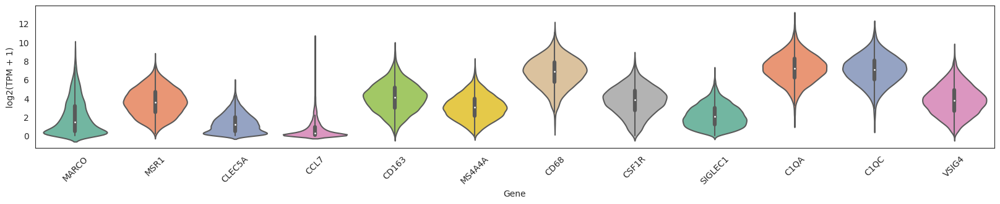

In [174]:
df = tcga_expressions.loc[signature_of_interest]
data = pd.melt(df.T)
data['KDE'] = 'Gene'

plt.figure(figsize = (20, 3))
sns.violinplot(
    x='Gene',
    y='value',
    data=pd.concat([data]),
    palette="Set2",
    split=True,
    scale="count",
    inner='box')

plt.ylabel('log2(TPM + 1)')
plt.xticks(rotation=45)
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_tuned_tcga_expressions_violin.svg", format="svg")

plt.show()

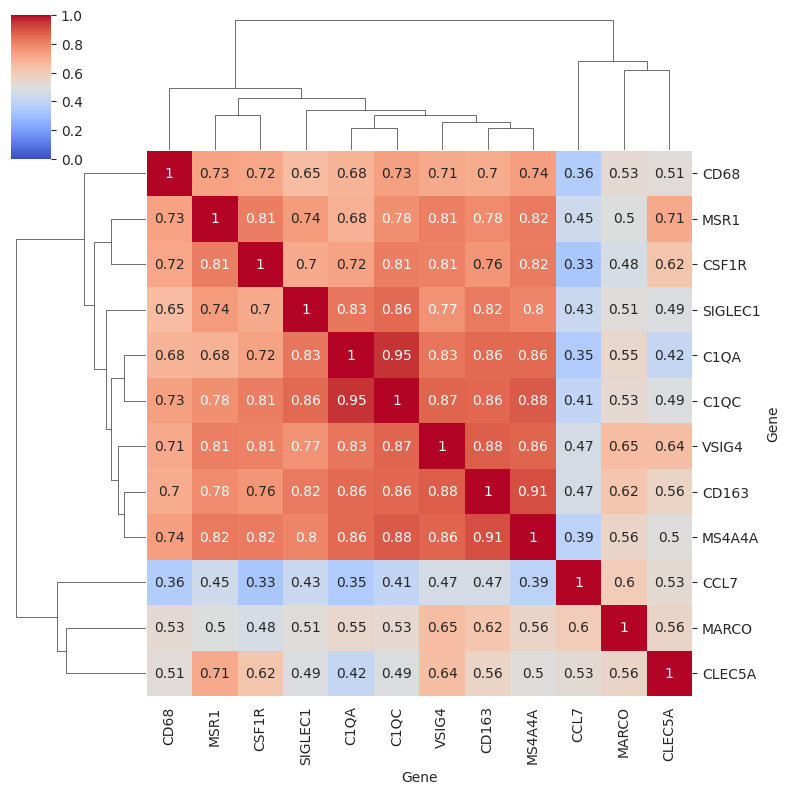

In [175]:
sns.clustermap(tcga_expressions.T[signature_of_interest].corr(method='spearman'), cmap=default_cmap, annot=True, figsize=(8, 8),
        annot_kws={"fontsize":10},
           vmin=0, vmax=1)
plt.show()

In [176]:
print('Checking for correlation with CHESS signatures...')
solid_pancan = ssgsea_formula(tcga_expressions, gmt_genes_alt_names(gmt, tcga_expressions.index, 
                                                                    verbose=False)).T
solid_pancan.corrwith(tcga_ssgsea_unscaled[signature_name]).sort_values().dropna().tail(20)

Checking for correlation with CHESS signatures...


Main4_Checkpoint_inhibition_FL             0.742707
Main4_Lymphoma_dissemination_LN            0.745998
Main4_Cytotoxic_cell_inactivation          0.746219
Main4_Protumor_cytokines_FL                0.751258
Main4_Protumor_cytokines_MCL               0.751258
Main4_Cancer-promoting_inflammation_FL     0.770167
Main4_Myeloid_Suppressive_factors_SOLID    0.778752
Main4_Myeloid_checkpoints_Blood            0.797543
Main4_Myeloid_checkpoints                  0.797543
Main4_Macrophage_DC_traffic                0.814708
Main4_Macrophage_DC_traffic_Blood          0.814708
Main4_Mph_DC_recruitment_SOLID             0.814708
Main4_MDSC                                 0.829872
Main4_TAMM                                 0.832513
Main4_Monocytes                            0.894276
Main4_Microglia                            0.909718
Main4_Phagocytosis_inhibition              0.914675
Main4_M2_signature_Blood                   0.968468
Main4_M2_signature                         0.968468
Main4_Pan_ma

ACC


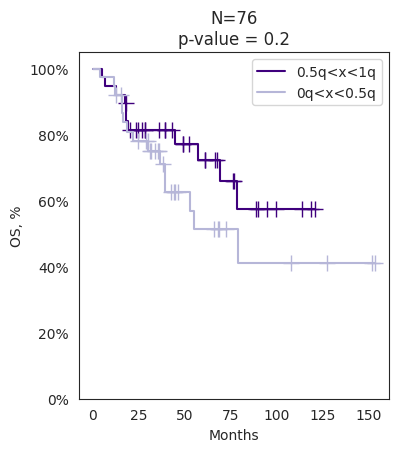

BLCA


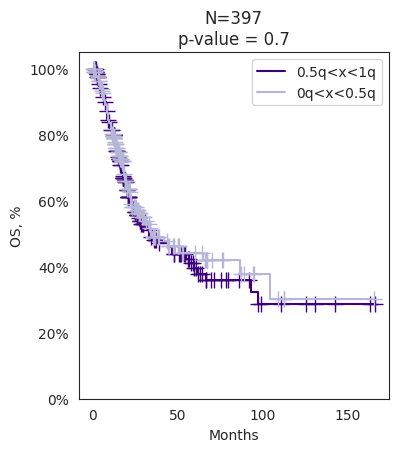

BRCA


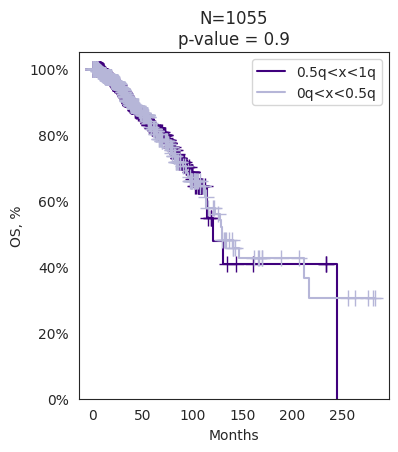

CESC


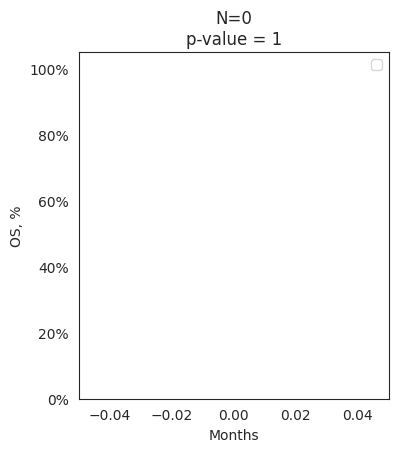

CHOL


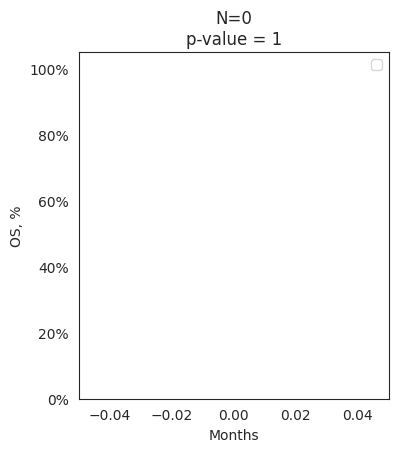

COAD


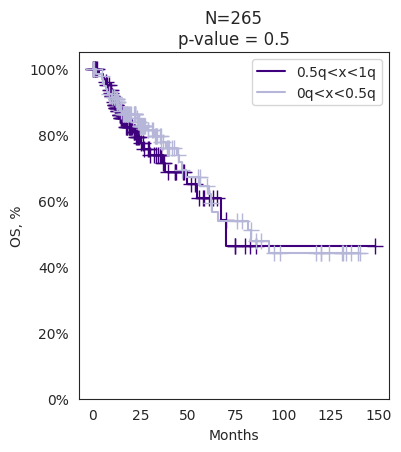

DLBC


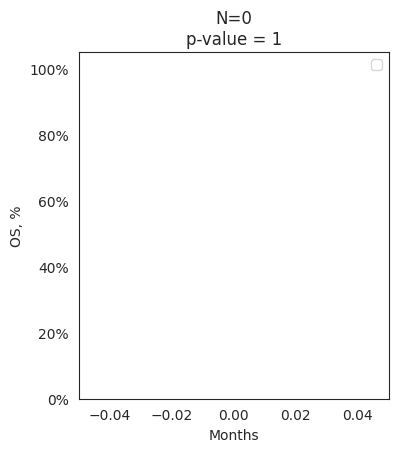

ESCA


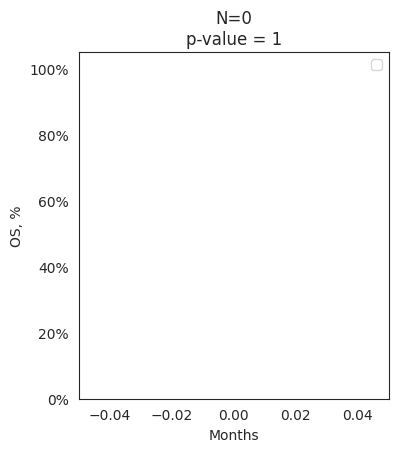

GBM


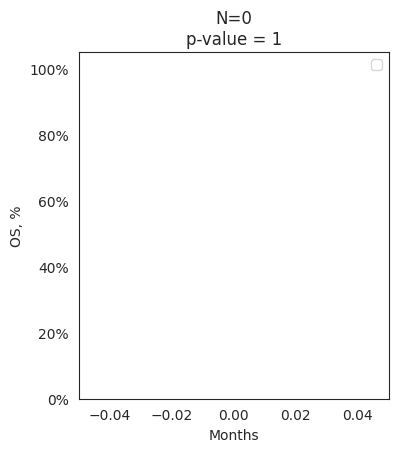

HNSC


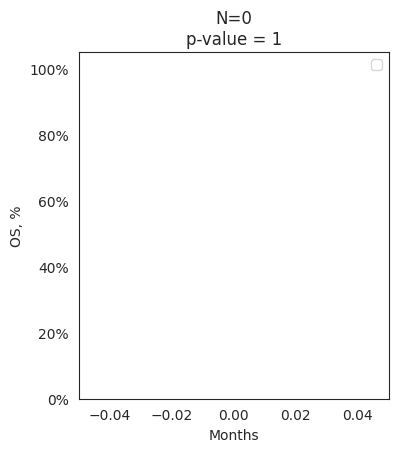

KICH


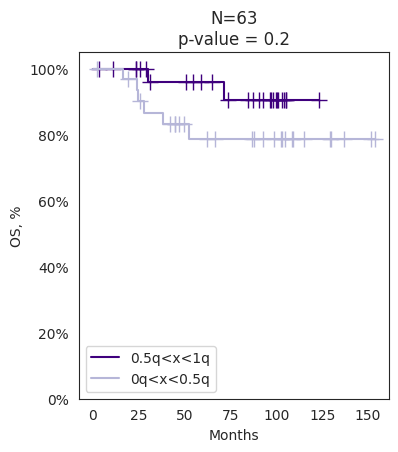

KIRC


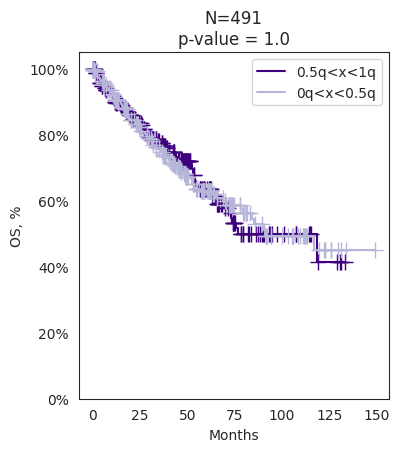

KIRP


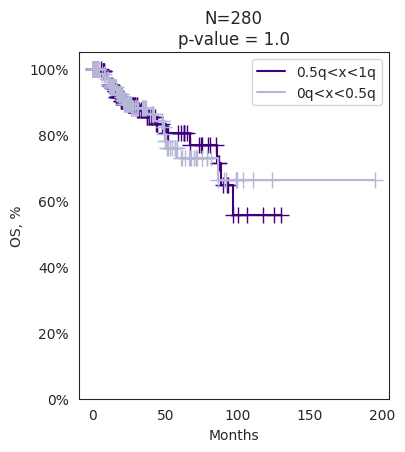

LAML


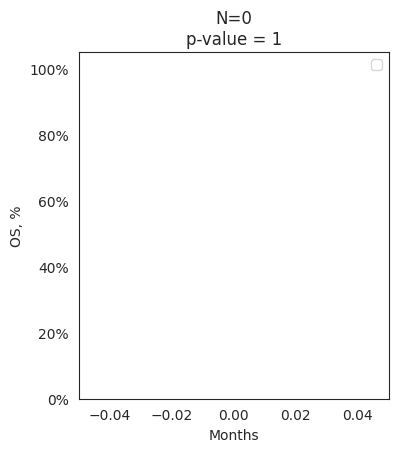

LGG


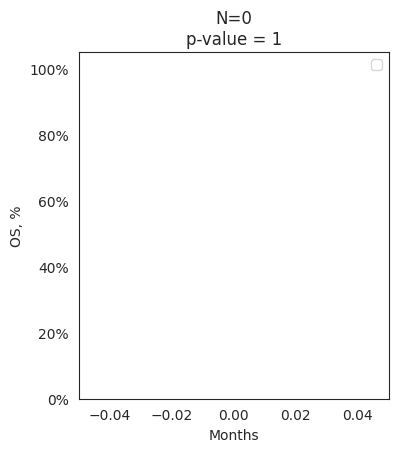

LIHC


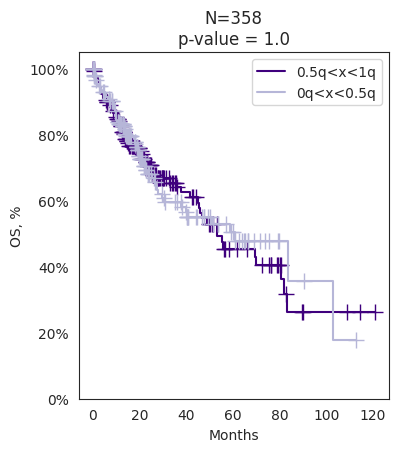

LUAD


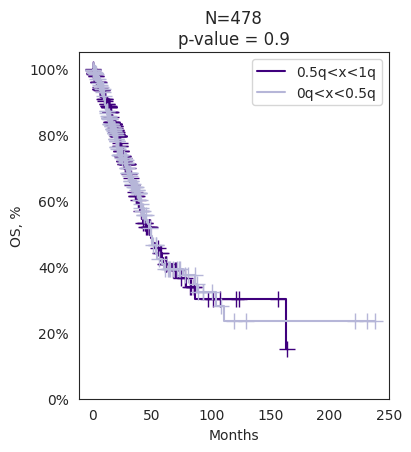

LUSC


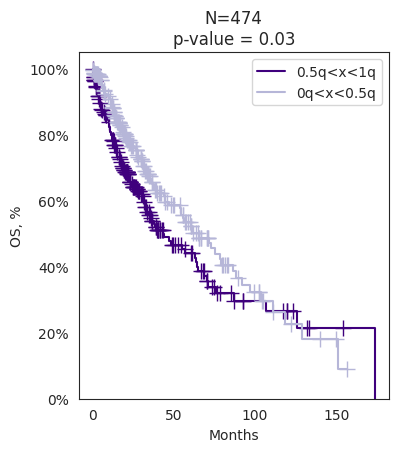

MESO


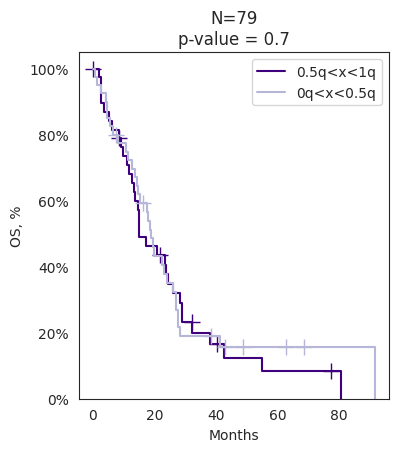

OV


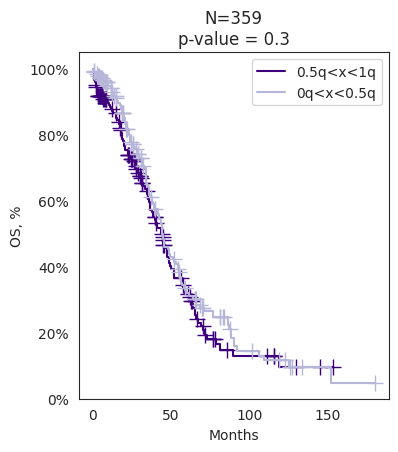

PAAD


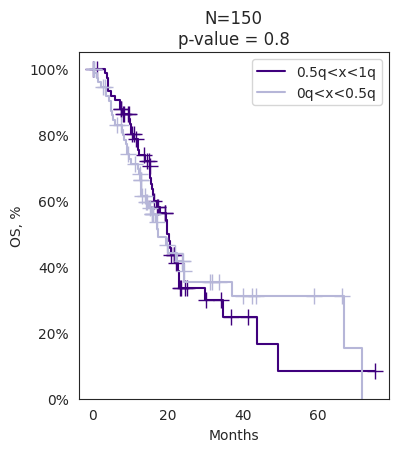

PCPG


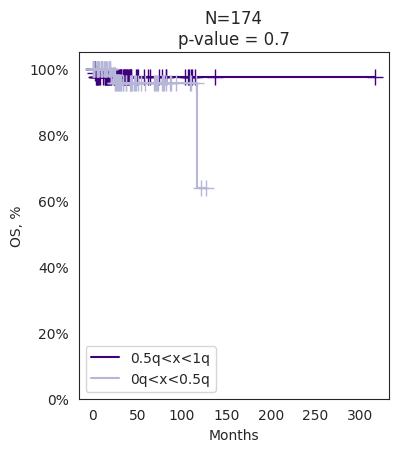

PRAD


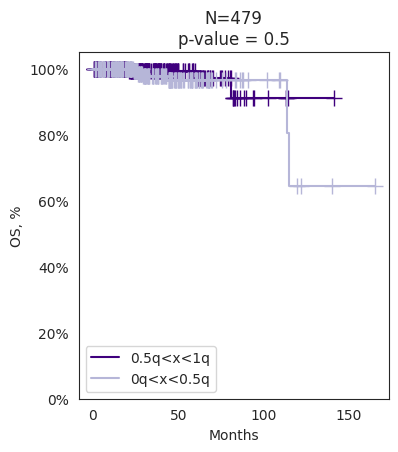

READ


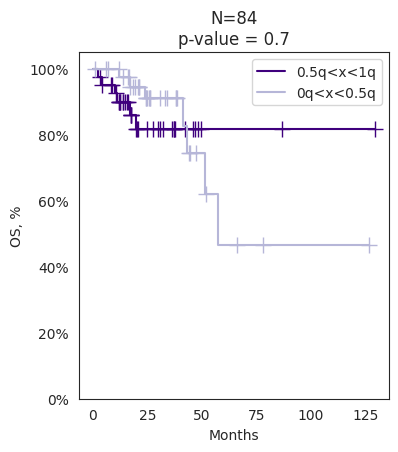

SARC


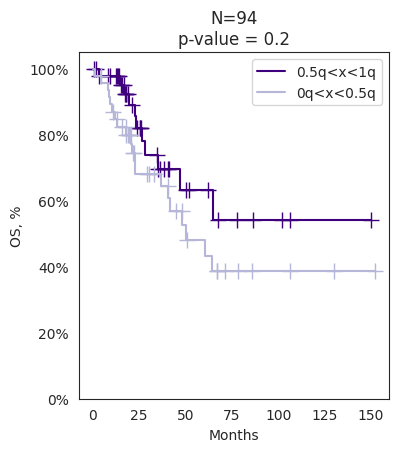

SKCM


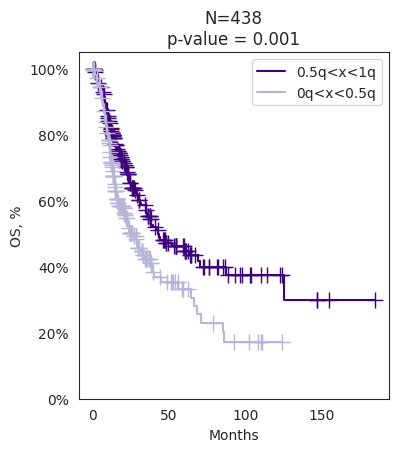

STAD


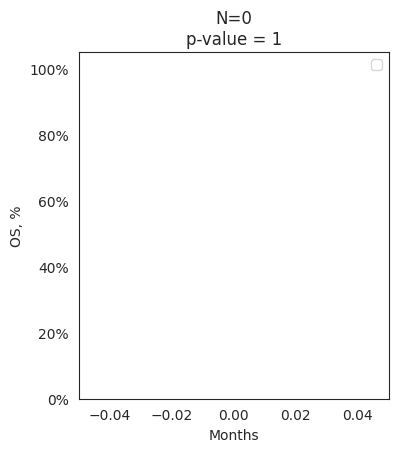

TGCT


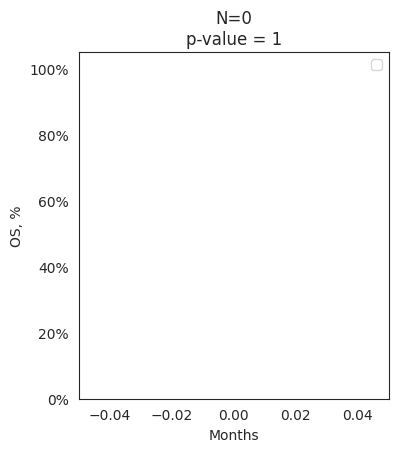

THCA


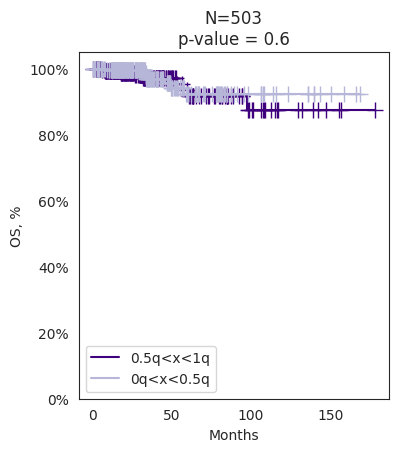

THYM


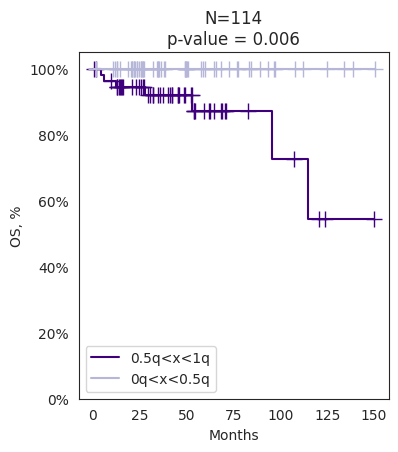

UCEC


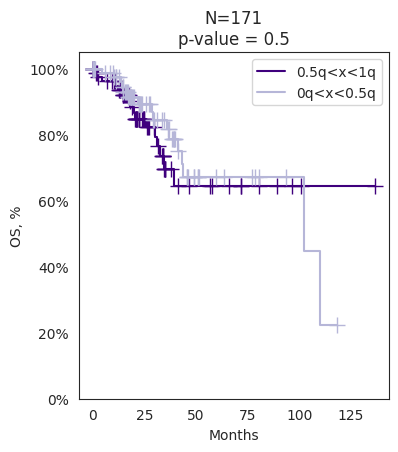

UCS


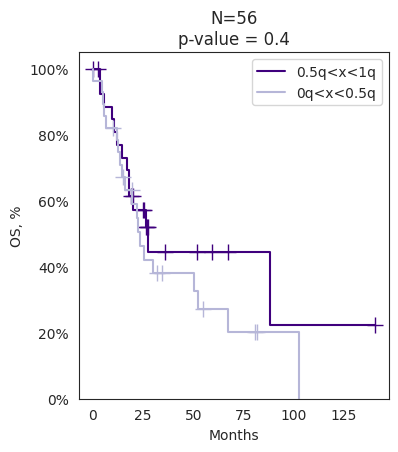

UVM


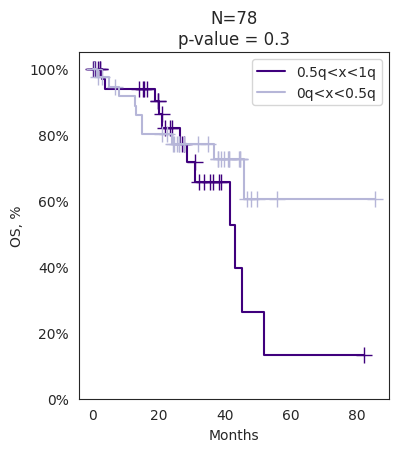

In [177]:
for diagnosis in tcga_anno.acronym.unique():
    print(diagnosis)
    kaplan_meier_quantiles(tcga_ssgsea[signature_name].reindex(tcga_anno[tcga_anno.acronym==diagnosis].index), survival)
    plt.show()

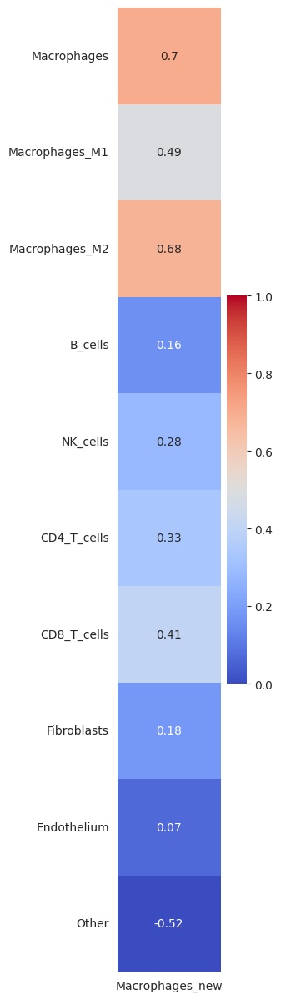

In [180]:
signatures = geneset_of_interest
cell_types = ['Macrophages', 'Macrophages_M1', 'Macrophages_M2', 'B_cells', 'NK_cells', 'CD4_T_cells', 'CD8_T_cells', 'Fibroblasts', 'Endothelium', 'Other']
corr_scores = []
for name, genes in signatures.items(): 
    ssgsea_scores = tcga_ssgsea
    corr = tcga_deconv.T[cell_types].corrwith(ssgsea_scores[name], axis='index', method='spearman')
    corr.name = name
    corr_scores.append(corr)
corr_scores = pd.concat(corr_scores, axis=1)
f, ax = plt.subplots(figsize=(len(signatures)*2, len(cell_types)*1.5))
sns.heatmap(corr_scores, 
            cbar=True, 
            cmap='coolwarm', 
            xticklabels=True, 
            annot=True,
            vmin=0, 
            vmax=1,
            ax=ax)
plt.show()

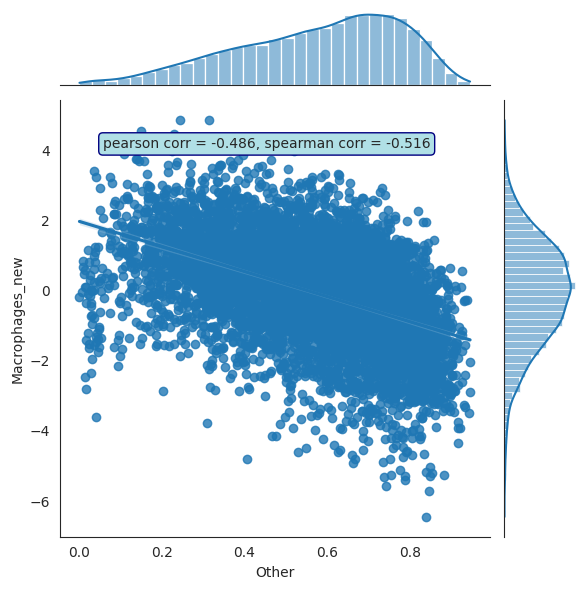

In [181]:
celltype_from_deconv = 'Other'

g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind='reg')
r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
    
g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                xy=(0.1, 0.9), xycoords='axes fraction',
                ha='left', va='center',
                bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})

plt.show()

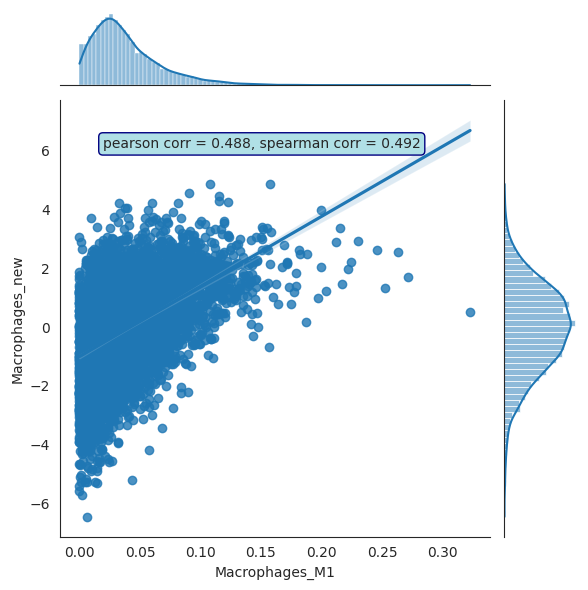

In [182]:
celltype_from_deconv = 'Macrophages_M1'

g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind='reg')
r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
    
g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                xy=(0.1, 0.9), xycoords='axes fraction',
                ha='left', va='center',
                bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})

plt.show()

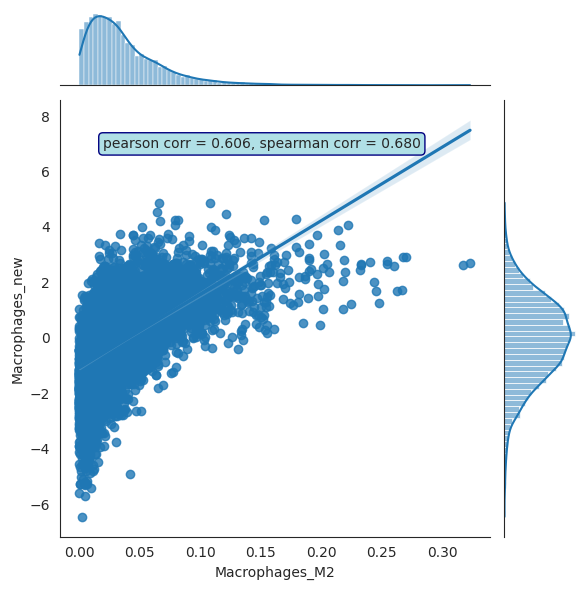

In [183]:
celltype_from_deconv = 'Macrophages_M2'

g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind='reg')
r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
    
g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                xy=(0.1, 0.9), xycoords='axes fraction',
                ha='left', va='center',
                bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})

plt.show()

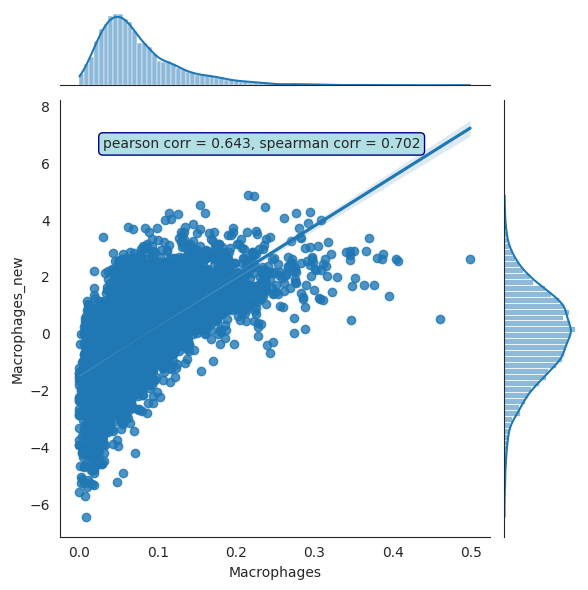

In [184]:
celltype_from_deconv = 'Macrophages'

g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind='reg')
r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name])
    
g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                xy=(0.1, 0.9), xycoords='axes fraction',
                ha='left', va='center',
                bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})

plt.show()

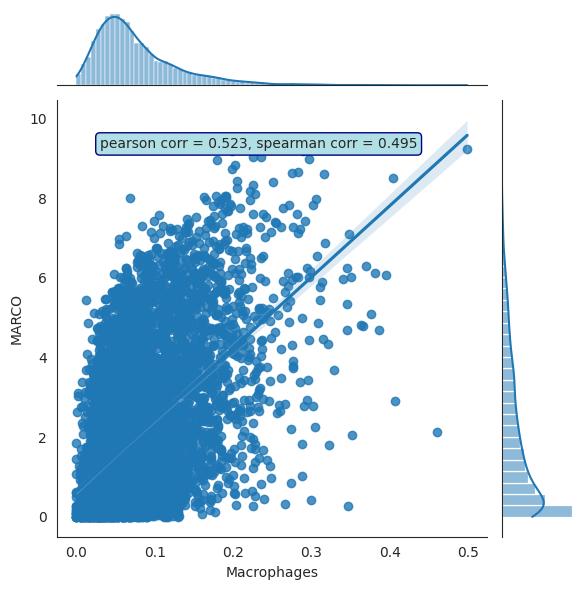

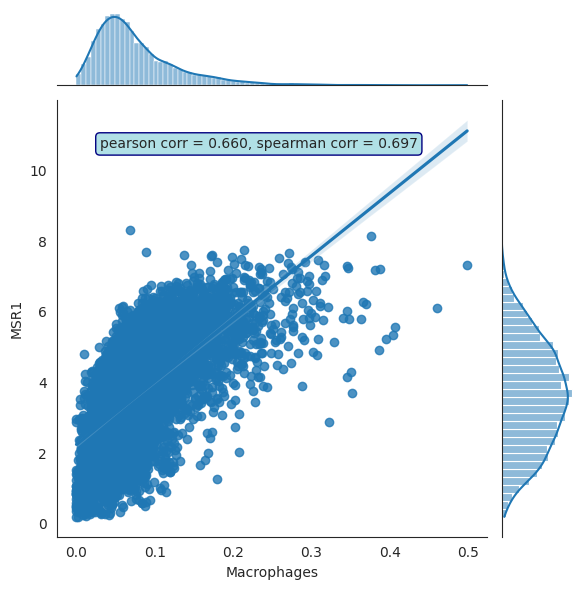

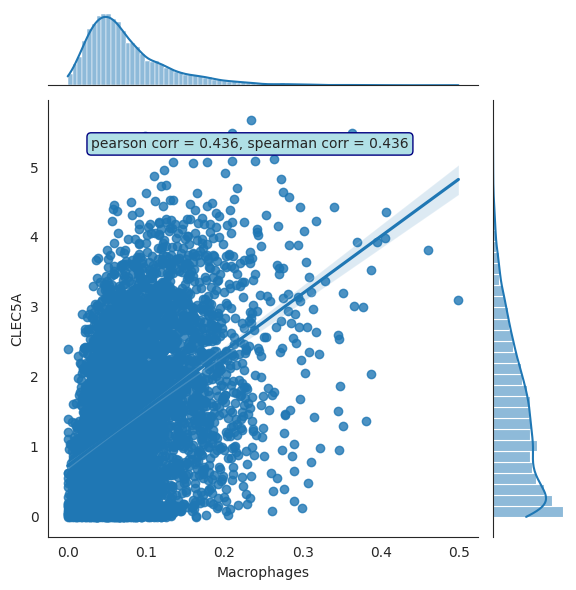

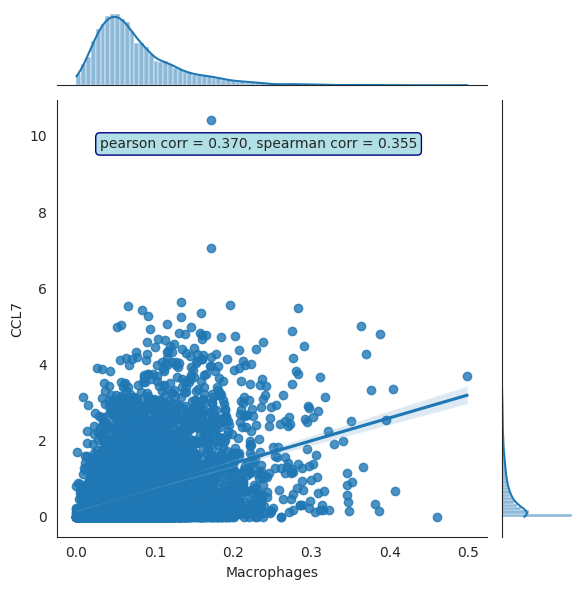

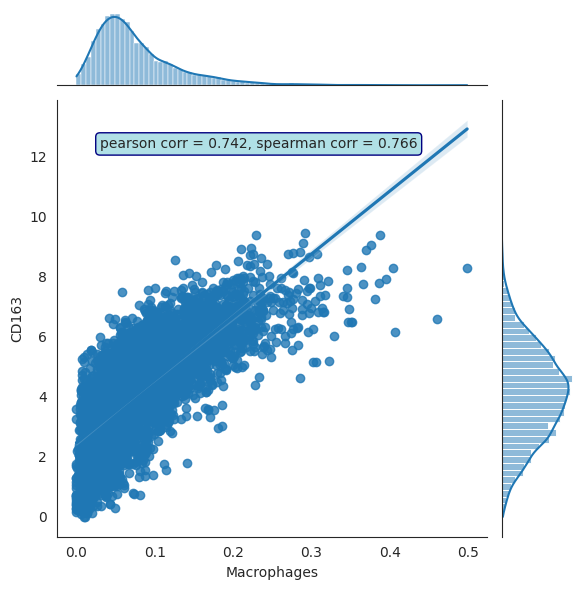

...

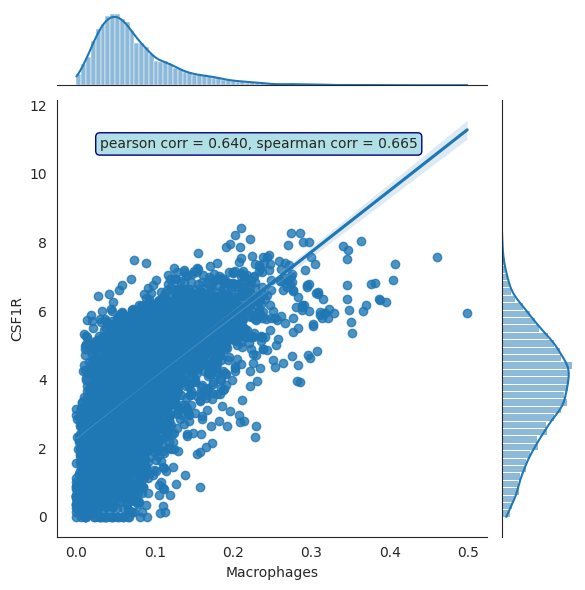

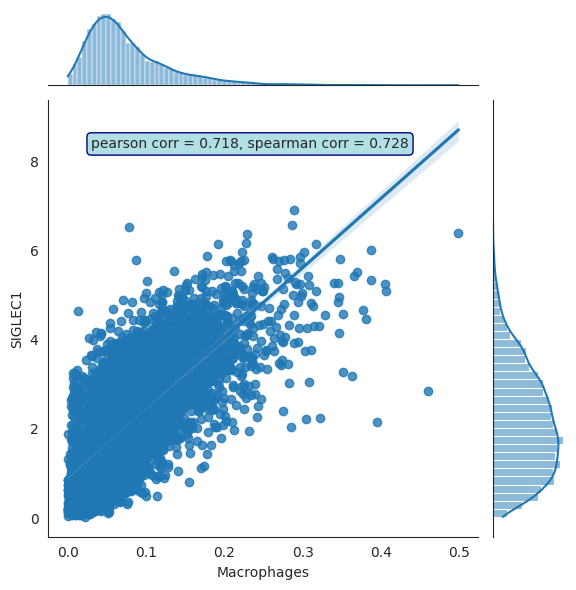

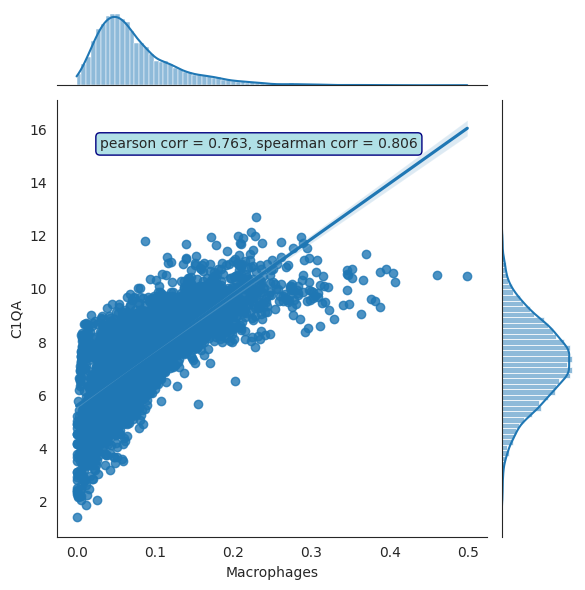

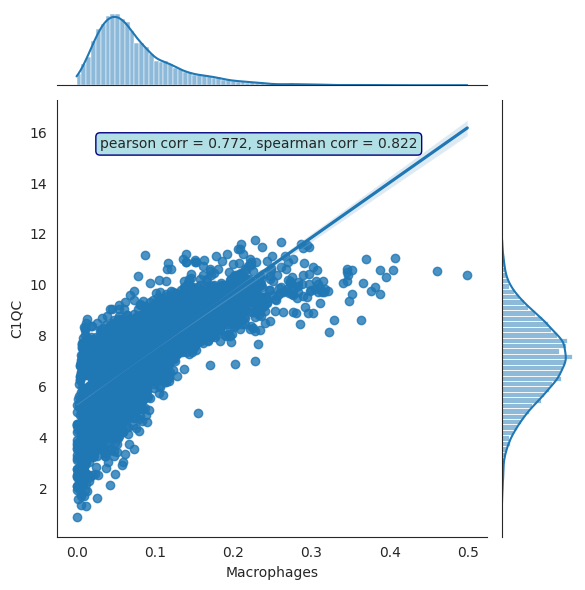

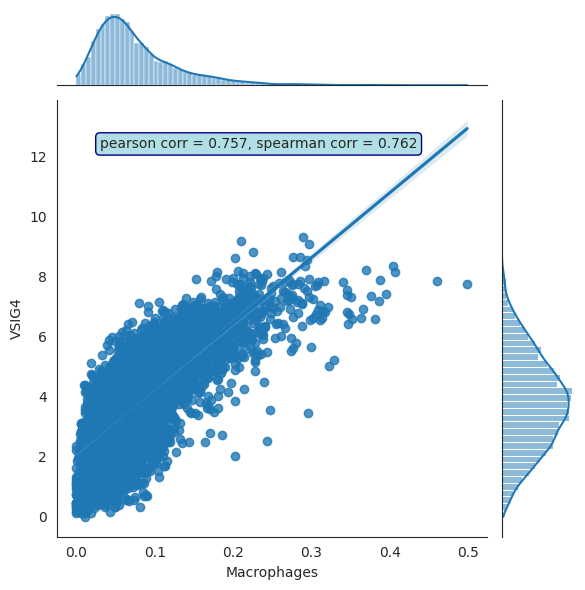

In [185]:
# comparison with deconvolution for every gene (log2 (TPM+1)) in your signature of interest
for gene in signature_of_interest:
    g = sns.jointplot(tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene], kind='reg')
    
    r, p = scipy.stats.pearsonr(tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene])
    rs, ps = scipy.stats.spearmanr(tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene])
    
    g.ax_joint.annotate(f'pearson corr = {r:.3f}, spearman corr = {rs:.3f}',
                    xy=(0.1, 0.9), xycoords='axes fraction',
                    ha='left', va='center',
                    bbox={'boxstyle': 'round', 'fc': 'powderblue', 'ec': 'navy'})
    plt.show()

## expression and noise gene examples

In [186]:
from data_obtaining import get_anno, get_expression_table

In [187]:
cohorts = [
 'TCGA-BLCA',
 'TCGA-CHOL',
 'TCGA-HNE_SCC',
 'TCGA-KICH',
 'TCGA-LIHC',
 'TCGA-OV',
 'TCGA-PAAD',
 'TCGA-PCPG',
 'TCGA-SKCM',
 'TCGA-THCA',
 'TCGA-ACC',
 'TCGA-BRCA_Basal',
 'TCGA-BRCA_Her2',
 'TCGA-BRCA_LumiNorm',
 'TCGA-COREAD',
 'TCGA-Glioblastoma',
 'TCGA-KIRC',
 'TCGA-KIRP',
 'TCGA-LUAD',
 'TCGA-LUSC',
 'TCGA-MESO',
 'TCGA-PRAD',
 'TCGA-SARC',
 'TCGA-TGCT',
 'TCGA-THYM',
 'TCGA-UCEC',
 'TCGA-UCS',
 'TCGA-UVM']

In [188]:
c = os.listdir('/uftp2/Datasets/Xena/TCGA/TCGA_Kallisto_genes_est_counts_without_noncoding/')
cohorts_with_counts = [i for i in c if 'Kallisto' in i]
print ('counts are available for cohorts:')
cohorts_with_counts

counts are available for cohorts:


['CHOL_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'PAAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'UVM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'THYM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'DLBC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'ACC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'STAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'ESCA_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'CESC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'COAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'MESO_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'KIRP_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'THCA_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'PCPG_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'SKCM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'HNSC_Kallisto-Xena_genes_

In [190]:
tcga_expressions = {}
tcga_counts = {}


for cohort in cohorts:
    e = get_expression_table(cohort, log=True).T
    tcga_expressions[cohort] = e

    
for cohort in cohorts_with_counts:
    tcga_counts[cohort] = read_dataset(f'/uftp2/Datasets/Xena/TCGA/TCGA_Kallisto_genes_est_counts_without_noncoding/{cohort}')

In [191]:
tcga_anno = read_dataset('/uftp2/Datasets/TCGA/current_version/data/annotation.tsv')
tcga_expressions = pd.concat(tcga_expressions.values(), axis=1)
tcga_counts = pd.concat(tcga_counts.values(), axis=1)

In [192]:
def calculate_sample_noise(
        sample: Union[pd.Series, pd.DataFrame],
        readcounts: Union[float, pd.Series],
        gene_lengths_path=Path('/uftp/gene_data_common/' 'gene_length_values.tsv'),
        alpha=2.05,) -> Union[pd.Series, pd.DataFrame]:
    """
    Calculation of sigma describing gene expression noise in technical replicates.
    For more info, check out https://bostongene.atlassian.net/wiki/spaces/IP/pages/3930259462/Expression+noise
    :param sample: pandas dataframe with expressions in TPM with samples as indexes
    :param readcounts: sample readcounts (sum for every patient) in mln
    :param gene_lengths_path: gene lehgths in bp
    :returns: sigma describing gene expression noise in technical replicates
    """
    gene_length = read_dataset(gene_lengths_path)
    # gene lengths are to be turned to kbp
    gene_length = gene_length / 1000
    noise_sigma = alpha * np.sqrt(sample.T.divide(gene_length.loc[sample.columns, 'length'], axis='index')
                                  / readcounts).T
    return noise_sigma

def generate_noise(sample: pd.Series, noise_sigma: pd.Series) -> pd.Series:
    """
    Method adds Poisson noise (very close approximation) and uniform noise for expressions in TPM.
    For more info, check out https://bostongene.atlassian.net/wiki/spaces/IP/pages/3930259462/Expression+noise
    Uniform noise - proportional to gene expressions noise from a normal distribution.
    :param sample: pandas series with expressions in TPM
    :param noise_sigma: sigma describing gene expression noise in technical replicates from calculate_sample_noise
    :returns: dataframe data with added noise
    """
    return (sample + noise_sigma * np.random.normal(size=sample.shape)).clip(lower=0)

In [193]:
tcga_expressions_for_noise, tcga_counts_for_noise = to_common_samples([tcga_expressions.T, tcga_counts.T])
tcga_counts_for_noise = tcga_counts_for_noise.sum(axis=1)
tcga_expressions_for_noise = 2**tcga_expressions_for_noise - 1
noise_sigma = calculate_sample_noise(tcga_expressions_for_noise, tcga_counts_for_noise/1000000)
noise_sigma.replace([np.inf, -np.inf], 0, inplace=True)

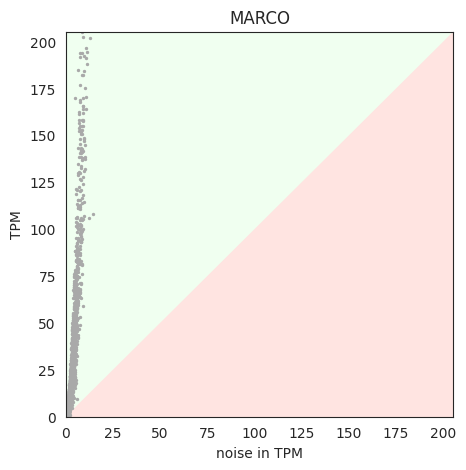

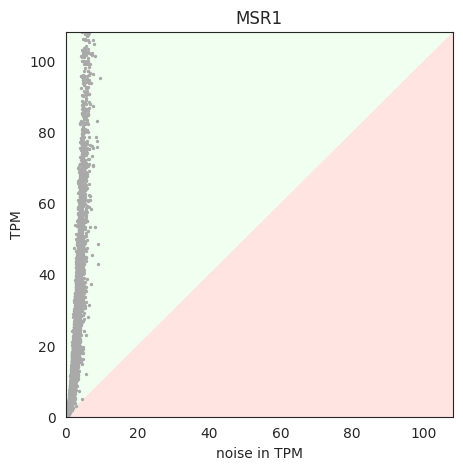

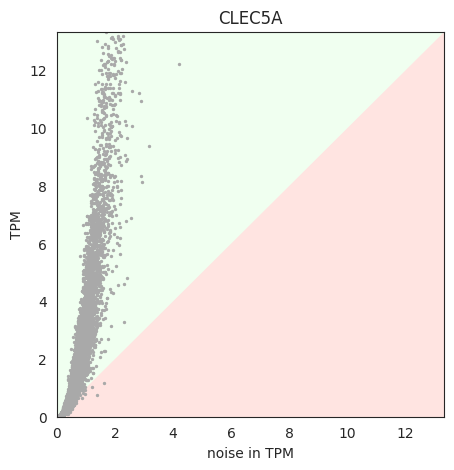

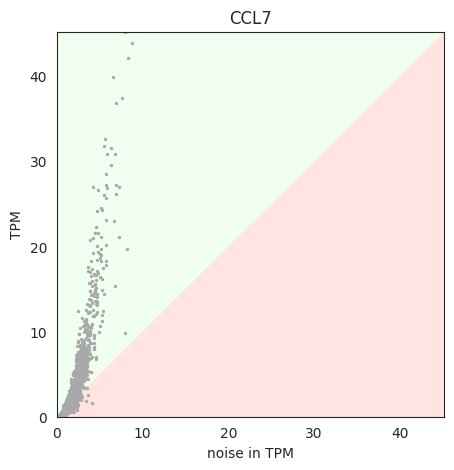

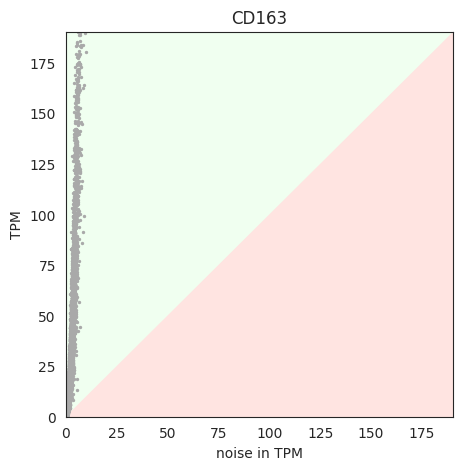

...

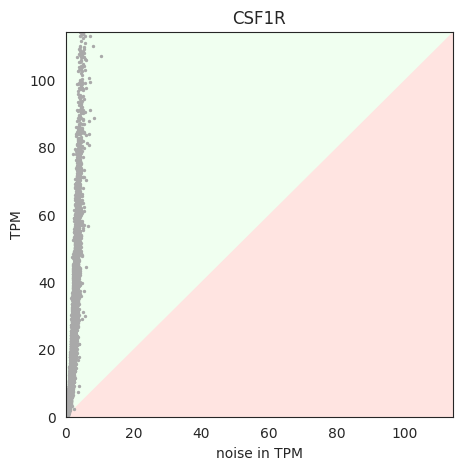

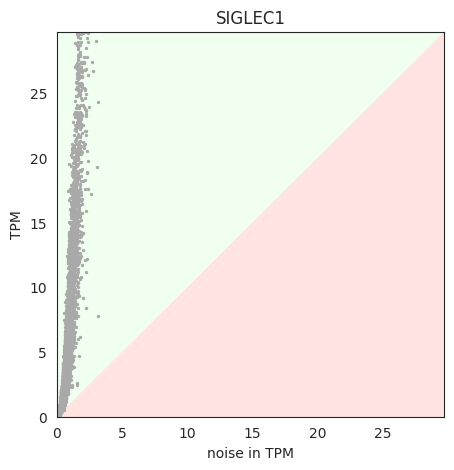

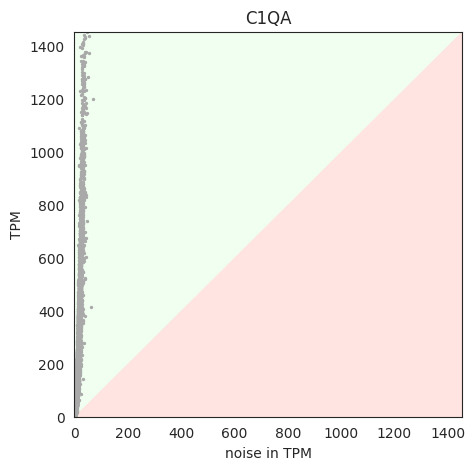

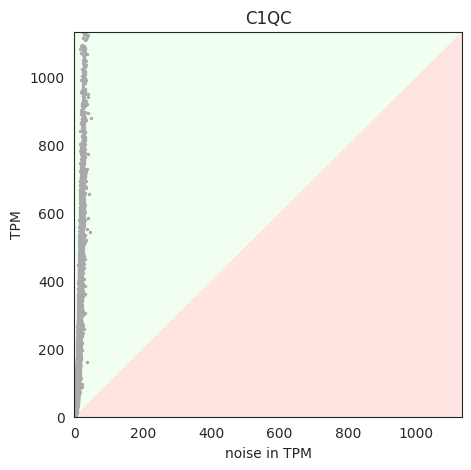

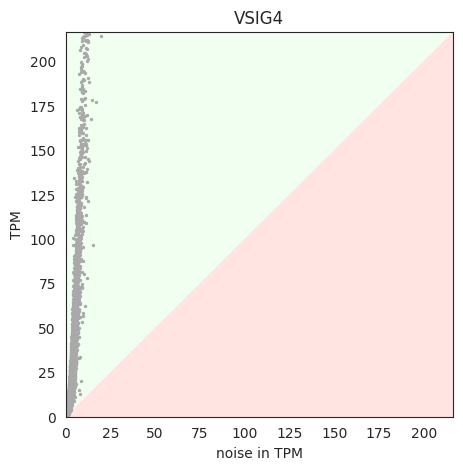

In [195]:
for gene in signature_of_interest:
    
    zscore = (tcga_expressions_for_noise[gene] - tcga_expressions_for_noise[gene].mean())/tcga_expressions_for_noise[gene].std()
    p = zscore[np.abs(zscore) < 3].index
    
    plt.figure(figsize = (5, 5))

    ax=plt.axes()
    ax.set_facecolor('honeydew')
    
    plt.ylabel('TPM')
    plt.xlabel('noise in TPM')
    
    plt.fill_between([0, tcga_expressions_for_noise[gene].reindex(p).max()], 
                     [0, tcga_expressions_for_noise[gene].reindex(p).max()],color="mistyrose")
    
    #noise is defined as 3*noise_sigma (from the article above), as technical noise have a Poisson distribution in out assumption
    plt.scatter(3*noise_sigma[gene].reindex(p), tcga_expressions_for_noise[gene].reindex(p), s=2, 
               c = 'darkgrey')
    plt.title(gene)
    plt.xlim(0, tcga_expressions_for_noise[gene].reindex(p).max())
    plt.ylim(0, tcga_expressions_for_noise[gene].reindex(p).max())
    
    plt.show()

Suppl figure 2B

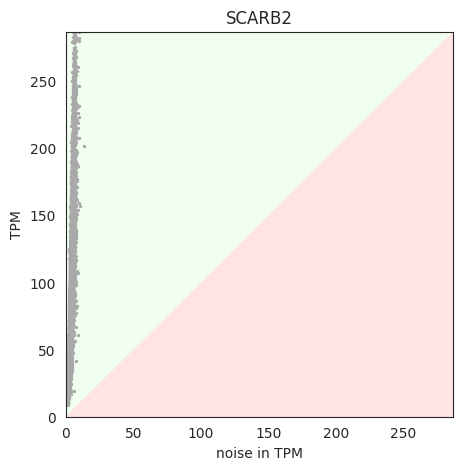

In [196]:
gene = 'SCARB2'
   
zscore = (tcga_expressions_for_noise[gene] - tcga_expressions_for_noise[gene].mean())/tcga_expressions_for_noise[gene].std()
p = zscore[np.abs(zscore) < 3].index
    
plt.figure(figsize = (5, 5))

ax=plt.axes()
ax.set_facecolor('honeydew')
    
plt.ylabel('TPM')
plt.xlabel('noise in TPM')
#plt.grid(b=None)
plt.fill_between([0, tcga_expressions_for_noise[gene].reindex(p).max()], 
                 [0, tcga_expressions_for_noise[gene].reindex(p).max()],color="mistyrose")
    
#noise is defined as 3*noise_sigma (from the article above), as technical noise have a Poisson distribution in out assumption
plt.scatter(3*noise_sigma[gene].reindex(p), tcga_expressions_for_noise[gene].reindex(p), s=2, 
            c = 'darkgrey')
plt.title(gene)
plt.xlim(0, tcga_expressions_for_noise[gene].reindex(p).max())
plt.ylim(0, tcga_expressions_for_noise[gene].reindex(p).max())
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_bad_gene_SCARB2_tcga_noise.svg", format="svg")
    
plt.show()

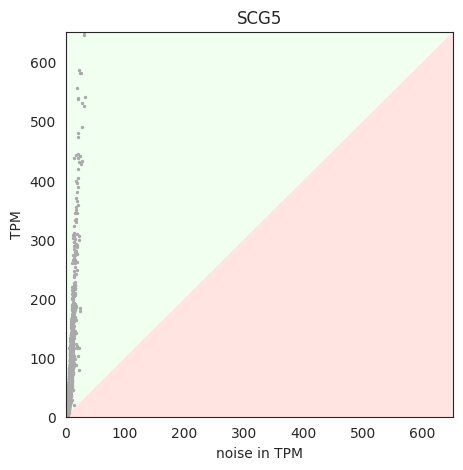

In [197]:
gene = 'SCG5'
   
zscore = (tcga_expressions_for_noise[gene] - tcga_expressions_for_noise[gene].mean())/tcga_expressions_for_noise[gene].std()
p = zscore[np.abs(zscore) < 3].index
    
plt.figure(figsize = (5, 5))

ax=plt.axes()
ax.set_facecolor('honeydew')
    
plt.ylabel('TPM')
plt.xlabel('noise in TPM')
#plt.grid(b=None)
plt.fill_between([0, tcga_expressions_for_noise[gene].reindex(p).max()], 
                 [0, tcga_expressions_for_noise[gene].reindex(p).max()],color="mistyrose")
    
#noise is defined as 3*noise_sigma (from the article above), as technical noise have a Poisson distribution in out assumption
plt.scatter(3*noise_sigma[gene].reindex(p), tcga_expressions_for_noise[gene].reindex(p), s=2, 
            c = 'darkgrey')
plt.title(gene)
plt.xlim(0, tcga_expressions_for_noise[gene].reindex(p).max())
plt.ylim(0, tcga_expressions_for_noise[gene].reindex(p).max())
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_bad_gene_SCG5_tcga_noise.svg", format="svg")
    
plt.show()

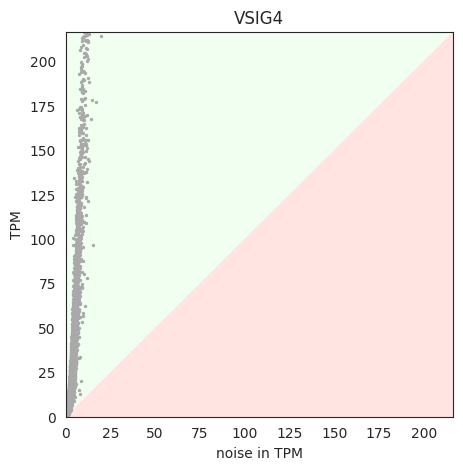

In [198]:
gene = 'VSIG4'
   
zscore = (tcga_expressions_for_noise[gene] - tcga_expressions_for_noise[gene].mean())/tcga_expressions_for_noise[gene].std()
p = zscore[np.abs(zscore) < 3].index
    
plt.figure(figsize = (5, 5))

ax=plt.axes()
ax.set_facecolor('honeydew')
    
plt.ylabel('TPM')
plt.xlabel('noise in TPM')
#plt.grid(b=None)
plt.fill_between([0, tcga_expressions_for_noise[gene].reindex(p).max()], 
                 [0, tcga_expressions_for_noise[gene].reindex(p).max()],color="mistyrose")
    
#noise is defined as 3*noise_sigma (from the article above), as technical noise have a Poisson distribution in out assumption
plt.scatter(3*noise_sigma[gene].reindex(p), tcga_expressions_for_noise[gene].reindex(p), s=2, 
            c = 'darkgrey')
plt.title(gene)
plt.xlim(0, tcga_expressions_for_noise[gene].reindex(p).max())
plt.ylim(0, tcga_expressions_for_noise[gene].reindex(p).max())
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_good_gene_VSIG4_tcga_noise.svg", format="svg")
    
plt.show()

Suppl figure 2A

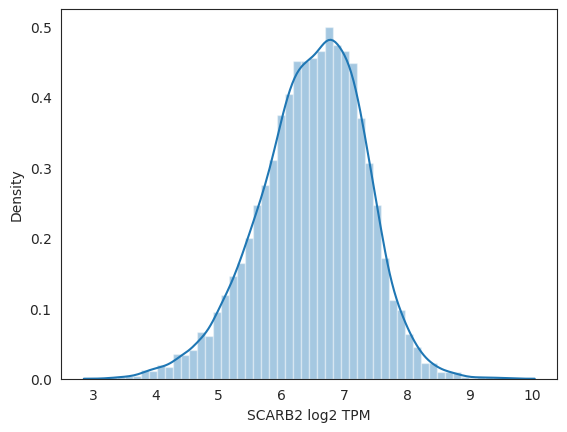

In [199]:
gene = 'SCARB2'
sns.distplot(tcga_expressions.loc[gene])
plt.xlabel(f'{gene} log2 TPM')
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_bad_gene_SCARB2_tcga_expression.svg", format="svg")

plt.show()

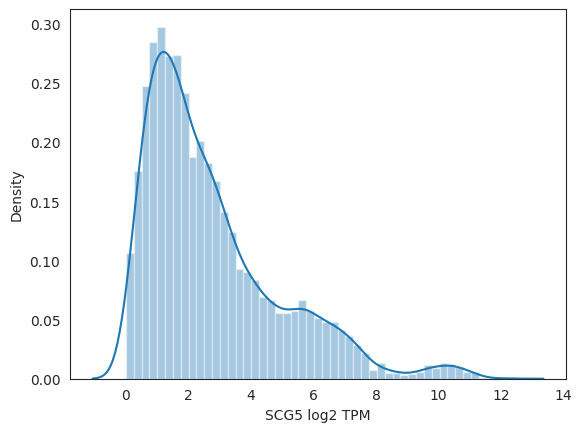

In [200]:
gene = 'SCG5'
sns.distplot(tcga_expressions.loc[gene])
plt.xlabel(f'{gene} log2 TPM')
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_bad_gene_SCG5_tcga_expression.svg", format="svg")

plt.show()

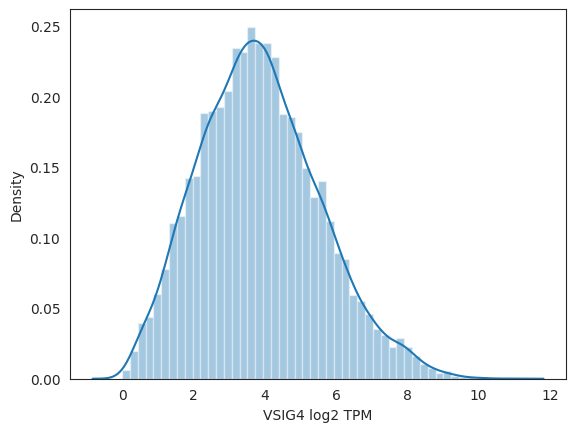

In [201]:
gene = 'VSIG4'
sns.distplot(tcga_expressions.loc[gene])
plt.xlabel(f'{gene} log2 TPM')
plt.rcParams['svg.fonttype'] = 'none'
plt.savefig("/uftp/users/msavchenko/figures/Macrophages_signature_good_gene_VSIG4_tcga_expression.svg", format="svg")

plt.show()